In [2]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from sklearn.utils import shuffle
#import scipy.stats as st 
from scipy.stats import normaltest, shapiro, chisquare
from sklearn.model_selection import train_test_split, KFold, RepeatedKFold, ShuffleSplit, GridSearchCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler, PolynomialFeatures

import warnings
warnings.filterwarnings('ignore')
pd.options.display.max_columns = 500

In [15]:
print(f"numpy: {np.__version__}")


numpy: 1.24.3


# Постановка задачи

**Контекст задачи** ("Аттестационное задание")

**Тема**: Прогнозирование конечных свойств новых материалов (композиционных материалов).<br> 
**Бизнес-проблема**: На входе имеются данные о начальных свойствах компонентов композиционных материалов (количество связующего, наполнителя, температурный режим отверждения и т.д.). На выходе необходимо спрогнозировать ряд конечных свойств получаемых композиционных материалов. 


**Бизнес-ценность решения**: 
- Созданные прогнозные модели помогут сократить количество проводимых испытаний на 30-50%;
- Ускорение разработки новых композитов в 2-3 раза;
- Пополнить базу данных материалов возможными новыми характеристиками материалов и цифровыми двойниками новых композитов.

**Постановка задачи ML**

**Задача 1 :** Регрессия<br>
**Целевая переменная:** Модуль упругости при растяжении (ГПа)<br>
**Методы:** Классическое ML (Random Forest, Gradient Boosting, SVM, ElasticNet)
**Особенности:** Низкая линейная корреляция, требуется feature engineering

**Задача 2 :** Регрессия<br>
**Целевая переменная:** Прочность при растяжении (МПа)<br>
**Методы:** Классическое ML с подбором гиперпараметров
**Особенности:** Низкая линейная корреляция, сильная зашумленность данных

**Задача 3 :** Регрессия<br>
**Целевая переменная:** Соотношение матрица-наполнитель (действительное число)<br>
**Методы:** Построить нейронную сеть
**Особенности:** Нелинейные зависимости, требует нормализации

**Метрики оценки:**<br>
1. **Коэффициент детерминации R² (основная)** количественно характеризует долю дисперсии целевой переменной, объясняемую регрессионной моделью. Данный показатель является нормализованной метрикой, позволяющей проводить сравнительный анализ моделей независимо от масштаба исходных данных. 
2. **Среднеквадратичная ошибка (RMSE)** демонстрирует среднюю величину отклонения прогнозных значений от фактических в единицах измерения целевой переменной.
3. **Средняя абсолютная процентная ошибка (MAPE)** выражает точность прогнозирования в относительных единицах, вычисляя среднее процентное отклонение предсказанных значений от фактических.

**Данные для анализа**

Входные данные находятся в двух файлах - X_bp.xlsx и X_nup.xlsx. Для получения исходного датасета необходимо объединить данные из этих файлов. Объединение 
производится по общему полю-индексу с использованием типа INNER JOIN.<br> 
Итоговый (объединенный) датасет содержит 13 столбцов и 1023 строк наблюдений. Каждая строка датасета представляет собой описание свойств одного конкретного материала.

**Особенности данных:**
1. **Низкая корреляция** с целевыми переменными
2. **Зашумленность** 
3. **Разные масштабы** - необходимо масштабирование
4. **Ограниченный объем** - риск переобучения
5. **Типы** - все колонки числовые (колонка "Угол нашивки" содержит только 2 значения - бинарная) 
6. **Пропуски** - отсутствуют
7. **Мультиколлинеарность** - нет

**Особенности задачи**
- Нет детальной информации о смысле признаков;
- Данные сильно зашумлены и имеют низкие линейные корреляции с целевой переменной.

## Этапы решения
1. **EDA** (Шаг2, Шаг6) - анализ распределений, корреляций, выбросов
2. **Preprocessing** - импутация, масштабирование, кодирование
3. **Моделирование** - GridSearchCV для задач 1-2, Keras для задачи 3
4. **Интерпретация** - SHAP, feature importance
5. **Валидация** - кросс-валидация
6. **Деплой** - сохранение модели, API для прогнозов

## Ожидаемые результаты
- Модели с R² > 0.7 для задач 1-2
- Нейросеть с MAPE < 15% для задачи 3
- Анализ важности признаков для материаловедов
- Рекомендации по улучшению сбора данных

# Общие функции

Оценка важности признаков с помощью permutation_importance

In [5]:
#  Оценка важности признаков с помощью permutation_importance

from sklearn.inspection import permutation_importance
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.pipeline import Pipeline
from sklearn.linear_model import RidgeCV, Ridge
from sklearn.preprocessing import StandardScaler

def plot_prmt_importance(model, X_test, y_test, n_repeats=10):
    # Вычисляем важность признаков
    result = permutation_importance(
        model, X_test, y_test,
        n_repeats=n_repeats,    # количество повторений
        random_state=42
    )

    # Результаты
    importance_scores = result.importances_mean
    importance_std = result.importances_std

    # Сортируем по важности
    sorted_idx = importance_scores.argsort()[::-1]

    plt.figure(figsize=(10, 6))
    plt.bar(range(len(importance_scores)), importance_scores[sorted_idx])
    plt.xticks(range(len(importance_scores)), sorted_idx)
    plt.title("Важность признаков (permutation importance)")
    plt.xlabel("Номер признака")
    plt.ylabel("Важность")
    plt.show() 

def prmt_importance(model, X_test, y_test, feature_names, n_repeats=50):
    
    # Вычисляем важность
    result = permutation_importance(
        model, X_test, y_test,
        n_repeats=n_repeats,
        scoring='r2',
        random_state=42
    )
    
    # Создаем список кортежей (имя, важность, std)
    features_with_importance = []
    for i, name in enumerate(feature_names):
        features_with_importance.append({
            'name': name,
            'importance': result.importances_mean[i],
            'std': result.importances_std[i]
        })
    
    # Сортируем по важности
    features_with_importance.sort(key=lambda x: x['importance'], reverse=True)
    
    # Выводим результаты
    print("ВАЖНОСТЬ ПРИЗНАКОВ:")
    print("-" * 50)
    for feature in features_with_importance:
        print(f"{feature['name']:35}: {feature['importance']:7.3f} ± {feature['std']:.3f}")
    
    return features_with_importance

def get_importance(prm_df, prm_str_y):

    X = prm_df.copy()
    y = prm_df[prm_str_y]
    X.drop([prm_str_y],axis=1,inplace=True)
    feature_names=X.columns.tolist()
    
    X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.30,random_state=42)

    #cf = KFold() 
    pipe = Pipeline( 
    [ 
        #('Scaler',StandardScaler()),
        ('Reg', RandomForestRegressor(n_estimators=200,      
                                      max_depth=None, 
                                      min_samples_split=2, 
                                      min_samples_leaf=1,    # Минимальные образцы в листе
                                      random_state=42,       
                                      n_jobs=-1)) 
        #('Reg', RidgeCV(cv=cf)) 
        #('Reg', Ridge(alpha=5.0))            
    ] 
    )

    pipe.fit(X_train, y_train)

    # Оценка базового качества
    train_score = pipe.score(X_train, y_train)
    test_score = pipe.score(X_test, y_test)
    print(f"Train score: {train_score:.3f}, Test score: {test_score:.3f}")
    #print("**** на Train ****")
    #df_out = prmt_importance(pipe, X_train, y_train, feature_names)
    #print("\r")
    print("**** на Test ****")
    df_out = prmt_importance(pipe, X_test, y_test, feature_names)
    plot_prmt_importance(pipe, X_test, y_test)

Быстрый SHAP анализ без разделения на train/test

In [13]:
import shap

def safe_shap_analysis(model, X, feature_names=None):
    """
    Безопасный SHAP анализ с учетом совместимости версий
    """
    # Временное исправление для совместимости
    np_bool_backup = getattr(np, 'bool', None)
    np_float_backup = getattr(np, 'float', None)
    np_int_backup = getattr(np, 'int', None)
    
    # Восстанавливаем устаревшие алиасы
    if np_bool_backup is None:
        np.bool = np.bool_
    if np_float_backup is None:
        np.float = np.float64
    if np_int_backup is None:
        np.int = np.int64
    
    try:
        # Создаем explainer
        explainer = shap.TreeExplainer(model)
        shap_values = explainer.shap_values(X)
        
        # Возвращаем результаты
        return explainer, shap_values
        
    finally:
        # Восстанавливаем оригинальные значения (если были)
        if np_bool_backup is None:
            delattr(np, 'bool')
        else:
            np.bool = np_bool_backup
            
        if np_float_backup is None:
            delattr(np, 'float')
        else:
            np.float = np_float_backup
            
        if np_int_backup is None:
            delattr(np, 'int')
        else:
            np.int = np_int_backup

# Быстрый SHAP анализ без разделения на train/test
def quick_shap_analysis(prm_df, prm_y, show_summary = False):
        
    X = prm_df.drop(columns=[prm_y])
    y = prm_df[prm_y]
    
    model = RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=-1)            
    model.fit(X, y)
    
    # SHAP для всей выборки (быстрее, но менее точно)
    #explainer = shap.TreeExplainer(model)
    #shap_values = explainer.shap_values(X)
    explainer, shap_values = safe_shap_analysis(model, X)


    print("Быстрый SHAP анализ:")
    shap.summary_plot(shap_values, X, plot_type="bar")
    
    #return model, shap_values
    if (show_summary):
        print(shap_values)

In [5]:
# Детализированный SHAP анализ
def detailed_shap_analysis(prm_df, prm_y):
    
    X = prm_df.drop(columns=[prm_y])
    y = prm_df[prm_y]
    
    model = RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=-1)
    model.fit(X, y)
    feature_names=X.columns.tolist()

    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X)
    
    # 1. Общая важность
    shap.summary_plot(shap_values, X, feature_names=feature_names, plot_type="bar")
    
    # 2. Детализированный plot
    shap.summary_plot(shap_values, X, feature_names=feature_names)
    
    # 3. Анализ для отдельных наблюдений
    shap.initjs()
    # shap.force_plot(explainer.expected_value, shap_values[0,:], X.iloc[0,:])
    
    # 4. Зависимости для топ-признаков
    if feature_names is not None:
        top_features = pd.DataFrame({
            'feature': feature_names,
            'importance': np.abs(shap_values).mean(0)
        }).sort_values('importance', ascending=False).head(3)['feature'].tolist()
        
        for feature in top_features:
            if feature in X.columns:
                shap.dependence_plot(feature, shap_values, X, feature_names=feature_names)

In [6]:
# Функция возвращает DataFrame со строками в которой есть выбросы по заданной колонке
def find_outliers_iqr(df, column_name):
    """
    Находит выбросы в указанной колонке DataFrame используя метод IQR
    
    Parameters:
    df (DataFrame): исходный DataFrame
    column_name (str): название колонки для анализа
    
    Returns:
    DataFrame: строки с выбросами
    """
    # Проверяем, что колонка существует
    if column_name not in df.columns:
        raise ValueError(f"Колонка '{column_name}' не найдена в DataFrame")
    
    # Вычисляем квартили и IQR
    Q1 = df[column_name].quantile(0.25)
    Q3 = df[column_name].quantile(0.75)
    IQR = Q3 - Q1
    
    # Определяем границы для выбросов
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Находим выбросы
    outliers = df[(df[column_name] < lower_bound) | (df[column_name] > upper_bound)]
    
    print(f"Анализ выбросов для колонки '{column_name}':")
    print(f"Q1 (25-й перцентиль): {Q1:.2f}")
    print(f"Q3 (75-й перцентиль): {Q3:.2f}")
    print(f"IQR: {IQR:.2f}")
    print(f"Нижняя граница: {lower_bound:.2f}")
    print(f"Верхняя граница: {upper_bound:.2f}")
    print(f"Найдено выбросов: {len(outliers)}")
    print("-" * 50)
    
    return outliers

In [7]:
# Удаляет строки с выбросами из DataFrame
def remove_outliers_iqr(df, columns=None, threshold=1.5):
    """
    Удаляет строки с выбросами из DataFrame используя метод IQR
    
    Parameters:
    df - исходный DataFrame
    columns - список колонок для проверки (по умолчанию все числовые колонки)
    threshold - множитель для определения границ выбросов (по умолчанию 1.5)
    
    Returns:
    DataFrame без строк, содержащих выбросы
    """
    
    # Если колонки не указаны, используем все числовые колонки
    if columns is None:
        columns = df.select_dtypes(include=[np.number]).columns.tolist()
    
    # Создаем маску для строк без выбросов
    mask = pd.Series([True] * len(df))
    
    for col in columns:
        if col in df.columns:
            # Вычисляем квартили и IQR
            Q1 = df[col].quantile(0.25)
            Q3 = df[col].quantile(0.75)
            IQR = Q3 - Q1
            
            # Определяем границы выбросов
            lower_bound = Q1 - threshold * IQR
            upper_bound = Q3 + threshold * IQR
            
            # Обновляем маску (True для строк без выбросов в текущей колонке)
            col_mask = (df[col] >= lower_bound) & (df[col] <= upper_bound)
            mask = mask & col_mask
    
    # Возвращаем DataFrame без строк с выбросами
    return df[mask]

In [8]:
# Метод локтя для определения оптимального количества кластеров
def wcss(prm_df):
    #X, _ = make_blobs(n_samples=300, centers=4, cluster_std=0.60, random_state=0)
    
    wcss = []  # Within-Cluster-Sum-of-Squares
    k_range = range(1, 15)

    for k in k_range:
        kmeans = KMeans(n_clusters=k, init='k-means++', random_state=42, n_init=10)
        kmeans.fit(prm_df)
        wcss.append(kmeans.inertia_)

    # Визуализация метода локтя
    plt.figure(figsize=(10, 6))
    plt.plot(k_range, wcss, 'bo-')
    plt.xlabel('Количество кластеров')
    plt.ylabel('WCSS')
    plt.title('Метод локтя для оптимального количества кластеров')
    plt.grid(True)
    plt.show()

In [9]:
from sklearn.manifold import TSNE

def t_sne(prm_df, prm_comp_num=2, prm_colorbar=''):
    # Предобработка данных
    # Удаление ненужных столбцов (например, ID, текстовых признаков)
    X = prm_df.select_dtypes(include=[np.number])

    # Масштабирование данных
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Применение t-SNE
    tsne = TSNE(n_components=prm_comp_num, 
            random_state=42, 
            perplexity=30, 
            n_iter=1000)
    
    X_tsne = tsne.fit_transform(X_scaled)

    # Создание DataFrame с результатами
    if prm_comp_num == 2:
        tsne_df = pd.DataFrame(X_tsne, columns=['TSNE1', 'TSNE2'])    
    else:       
        tsne_df = pd.DataFrame(X_tsne, columns=['TSNE1', 'TSNE2','TSNE3'])

    # Визуализация
    # prm_colorbar - столбец с метками 
    if prm_comp_num == 2:
        plt.figure(figsize=(12, 8))
        
        if prm_colorbar and prm_colorbar in prm_df.columns:
            scatter = plt.scatter(tsne_df['TSNE1'], tsne_df['TSNE2'],
                                c=prm_df[prm_colorbar],
                                cmap='viridis',
                                alpha=0.6, 
                                s=50)
            plt.colorbar(scatter, label=prm_colorbar)
        else:
            scatter = plt.scatter(tsne_df['TSNE1'], tsne_df['TSNE2'],
                                alpha=0.6, 
                                s=50)            

        plt.title('t-SNE визуализация данных')
        plt.xlabel('TSNE Component 1')
        plt.ylabel('TSNE Component 2')
        plt.grid(True, alpha=0.3)
        plt.show()
    else: 
        fig = plt.figure(figsize=(12, 8))       
        ax = fig.add_subplot(111, projection='3d')
    
        if prm_colorbar and prm_colorbar in prm_df.columns:
            scatter = ax.scatter(tsne_df['TSNE1'], tsne_df['TSNE2'], tsne_df['TSNE3'],
                                c=prm_df[prm_colorbar], 
                                cmap='viridis', 
                                alpha=0.7, 
                                s=50)
            plt.colorbar(scatter, label=prm_colorbar)
        else:
            scatter = ax.scatter(tsne_df['TSNE1'], tsne_df['TSNE2'], tsne_df['TSNE3'],
                                alpha=0.7, 
                                s=50)    

        ax.set_title('3D t-SNE визуализация с цветовой кодировкой кластеров')
        ax.set_xlabel('TSNE Component 1')
        ax.set_ylabel('TSNE Component 2')
        ax.set_zlabel('TSNE Component 3')
        plt.grid(True, alpha=0.3)
        plt.show()

In [10]:
#import pandas as pd
#import numpy as np
#import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

def get_Cluster_KMeans(prm_df, claster_num):

    df_cmeans = prm_df.copy()

    # Предобработка данных (масштабирование)
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(df_cmeans)

    # Кластеризация K-Means
    kmeans = KMeans(n_clusters=claster_num, init='k-means++', random_state=42, n_init=10)
    clusters = kmeans.fit_predict(scaled_data)

    # Добавляем метки кластеров в DataFrame
    df_cmeans['cluster'] = clusters

    # Создаем попарные scatterplot графики
    #features = df.columns[:-1]  # Все колонки кроме последней (cluster)
    #features = df.columns[:]
    #n_features = len(features)

    #fig, axes = plt.subplots(n_features, n_features, figsize=(15, 15))
    sns.pairplot(df_cmeans, hue='cluster', palette='viridis')
    plt.show()

    print("Размеры кластеров:")
    print(df_cmeans['cluster'].value_counts())
    max_cluster = df_cmeans['cluster'].value_counts().idxmax()
    max_v = df_cmeans['cluster'].value_counts().max()
    print(f'Самый большой кластер № {max_cluster}: {max_v}')
    
    print("\nЦентры кластеров:")
    print(pd.DataFrame(scaled_data).groupby(clusters).mean())

    return df_cmeans

# Шаг 1:   Загрузка данных
- Загружаем два Excel-файла (X_bp.xlsx и X_nup.xlsx) в два DataFrame и собираем их в один DataFrame, используя соединение с типом INNER
- Для удобства обращения к колонам удаляем из их наименований единицу измерения, начиная с запятой 

In [10]:
df_bp = pd.read_excel('./data/processed/X_bp.xlsx')
df_nup = pd.read_excel('./data/processed/X_nup.xlsx')

df_in = pd.merge(df_bp, df_nup, on='Unnamed: 0', how='inner') # Объединение данных из файлов в результирующий DataFrame

# Датасет с индексом 
df_in_idx = df_in.copy() 
# удаление из наименования колонки информации о единице измерения 
new_columns = [s.split(',', 1)[0].strip() for s in df_in_idx.columns]
df_in_idx.rename(columns=dict(zip(df_in_idx.columns, new_columns)),inplace=True)

# Датасет без индекса
#df_in = df_in.drop(df_in[df_in['Unnamed: 0'] > 39].index)
df_in.drop(['Unnamed: 0'],axis=1,inplace=True)                # Удаление столбца с индексом из результирующего DataFrame
# удаление из наименования колонки информации о единице измерения 
new_columns = [s.split(',', 1)[0].strip() for s in df_in.columns]
df_in.rename(columns=dict(zip(df_in.columns, new_columns)),inplace=True)

df_in.head()

,Соотношение матрица-наполнитель,Плотность,модуль упругости,Количество отвердителя,Содержание эпоксидных групп,Температура вспышки,Поверхностная плотность,Модуль упругости при растяжении,Прочность при растяжении,Потребление смолы,Угол нашивки,Шаг нашивки,Плотность нашивки
0,1.857143,2030.0,738.736842,30.00,22.267857,100.000000,210.0,70.0,3000.0,220.0,0,4.0,57.0
1,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0,0,4.0,60.0
2,1.857143,2030.0,738.736842,49.90,33.000000,284.615385,210.0,70.0,3000.0,220.0,0,4.0,70.0
3,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0,0,5.0,47.0
4,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,57.0


# Шаг2:   Разведочный анализ данных  (на полном датасете 1023 строки)
Предварительный просмотр данных Excel-файлов показал, что в начале каждого из загружаемых файлов находятся несколько десятков записей визуально отличающихся от основной массы. Основные отличия - много повторяющихся значений, формат представления числа (целые и вещественные). Поэтому, далее, имеет смысл провести небольшой кластерный анализ и посмотреть не выделятся ли эти данные в отдельный кластер (на сколько сильно отличаются).

## Общий обзор данных

In [12]:
df_in.shape

(1023, 13)

In [13]:
df_in.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1023 entries, 0 to 1022
Data columns (total 13 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Соотношение матрица-наполнитель  1023 non-null   float64
 1   Плотность                        1023 non-null   float64
 2   модуль упругости                 1023 non-null   float64
 3   Количество отвердителя           1023 non-null   float64
 4   Содержание эпоксидных групп      1023 non-null   float64
 5   Температура вспышки              1023 non-null   float64
 6   Поверхностная плотность          1023 non-null   float64
 7   Модуль упругости при растяжении  1023 non-null   float64
 8   Прочность при растяжении         1023 non-null   float64
 9   Потребление смолы                1023 non-null   float64
 10  Угол нашивки                     1023 non-null   int64  
 11  Шаг нашивки                      1023 non-null   float64
 12  Плотность нашивки   

In [5]:
df_in.nunique()

Соотношение матрица-наполнитель    1014
Плотность                          1013
модуль упругости                   1020
Количество отвердителя             1005
Содержание эпоксидных групп        1004
Температура вспышки                1003
Поверхностная плотность            1004
Модуль упругости при растяжении    1004
Прочность при растяжении           1004
Потребление смолы                  1003
Угол нашивки                          2
Шаг нашивки                         989
Плотность нашивки                   988
dtype: int64

In [18]:
df_in.isna().sum() # Проверка на пустые значения

Соотношение матрица-наполнитель    0
Плотность                          0
модуль упругости                   0
Количество отвердителя             0
Содержание эпоксидных групп        0
Температура вспышки                0
Поверхностная плотность            0
Модуль упругости при растяжении    0
Прочность при растяжении           0
Потребление смолы                  0
Угол нашивки                       0
Шаг нашивки                        0
Плотность нашивки                  0
dtype: int64

Выводы: 
- датасет содержит 1023 строки и 13 столбцов;
- пустые значения отсутствуют;
- есть не большое количество повторяющихся значений;
- все колонки, кроме "Угол нашивки" имеют непрерывные значения;
- колонка "Угол нашивки" содержит, только, 2 значения, т.е. это бинарный признак. Преобразую значение 90 в колонке "Угол нашивки" в 1 , т.е. фактически сделаю преобразование OneHotEncoding.

In [14]:
df_in.loc[df_in['Угол нашивки'] == 90, 'Угол нашивки'] = 1

## Выявление аномалий и выбросов (на полном датасете 1023 строки)

In [15]:
# Проверка на нулевые значения
zero_counts = df_in.eq(0).sum()
print("\nКоличество нулеевых значений в каждой колонке:")
print(zero_counts)


Количество нулеевых значений в каждой колонке:
Соотношение матрица-наполнитель      0
Плотность                            0
модуль упругости                     0
Количество отвердителя               0
Содержание эпоксидных групп          0
Температура вспышки                  0
Поверхностная плотность              0
Модуль упругости при растяжении      0
Прочность при растяжении             0
Потребление смолы                    0
Угол нашивки                       520
Шаг нашивки                          1
Плотность нашивки                    1
dtype: int64


Обнаружены значения равные 0 в 3 колонках. В колонке "Угол нашивки" указывается значение угла и значение 0 допустимо. В колонках "Шаг нашивки" и "Плотность нашивки" значение 0 не допустимо. Удаляю эту строку.

In [16]:
df_in = df_in.drop(df_in[df_in['Шаг нашивки'] == 0].index)  # Удаляем строку с 0-ыми исходными данными
#df_in = df_in.drop(df_in[df_in['Плотность нашивки'] > 100].index)

In [17]:
df_in.describe().T.round(2) # описательная статистика

,count,mean,std,min,25%,50%,75%,max
Соотношение матрица-наполнитель,1022.0,2.93,0.91,0.39,2.32,2.91,3.55,5.59
Плотность,1022.0,1975.73,73.77,1731.76,1924.13,1977.60,2021.38,2207.77
модуль упругости,1022.0,739.49,330.10,2.44,499.32,739.31,960.47,1911.54
Количество отвердителя,1022.0,110.57,28.31,17.74,92.43,110.55,129.73,198.95
Содержание эпоксидных групп,1022.0,22.24,2.41,14.25,20.61,22.23,23.96,33.00
Температура вспышки,1022.0,285.88,40.96,100.00,259.03,285.92,313.01,413.27
Поверхностная плотность,1022.0,482.22,280.97,0.60,266.65,451.59,692.34,1399.54
Модуль упругости при растяжении,1022.0,73.32,3.12,64.05,71.24,73.27,75.34,82.68
Прочность при растяжении,1022.0,2467.38,485.65,1036.86,2136.26,2460.26,2768.02,3848.44
Потребление смолы,1022.0,218.34,59.71,33.80,179.60,219.19,257.40,414.59


Вывод: по значениям параметров из описательной статистики можно сделать предположения о сдвиге распределения, наличии выбросов и нормальности распределения.
Учитывая среднее значение, стандартное отклонение (1.5*std) и минимальное\максимальное значение можно предположить, что:
- Выбросы имеются во всех колонках
- "Поверхностная плотность" смещена влево

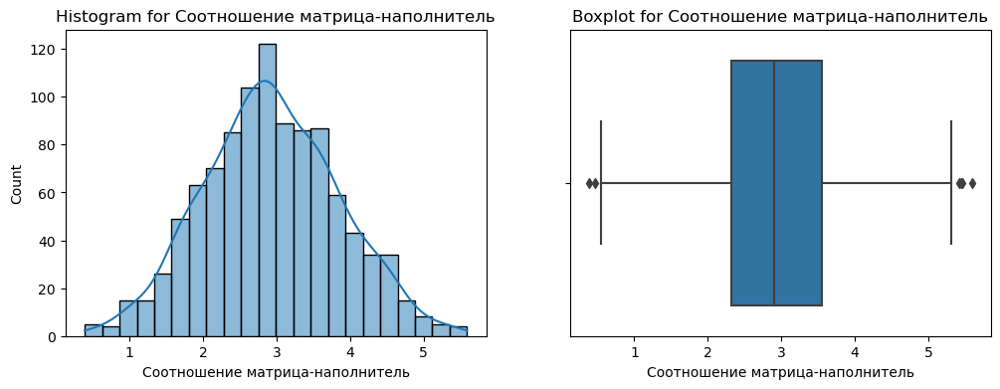

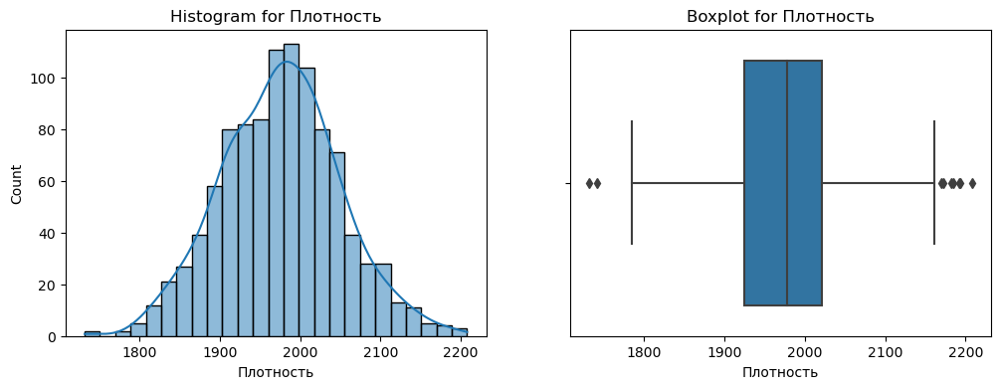

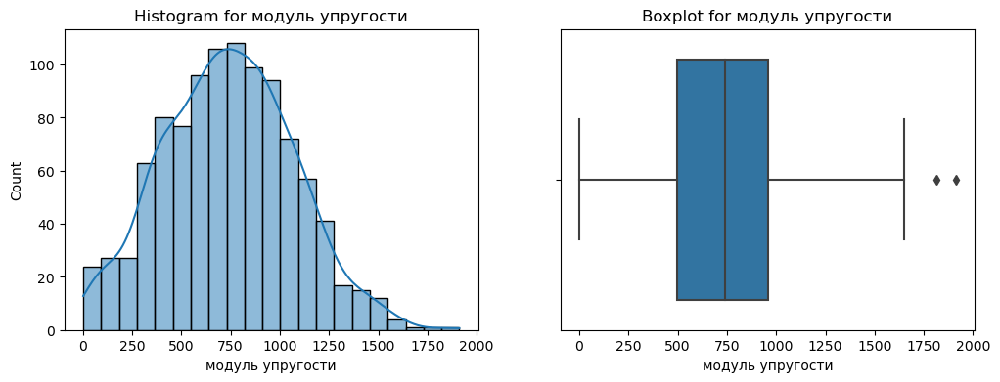

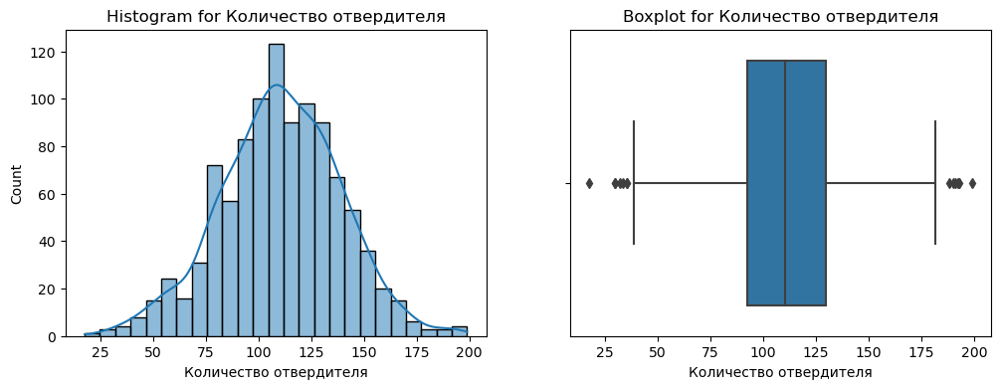

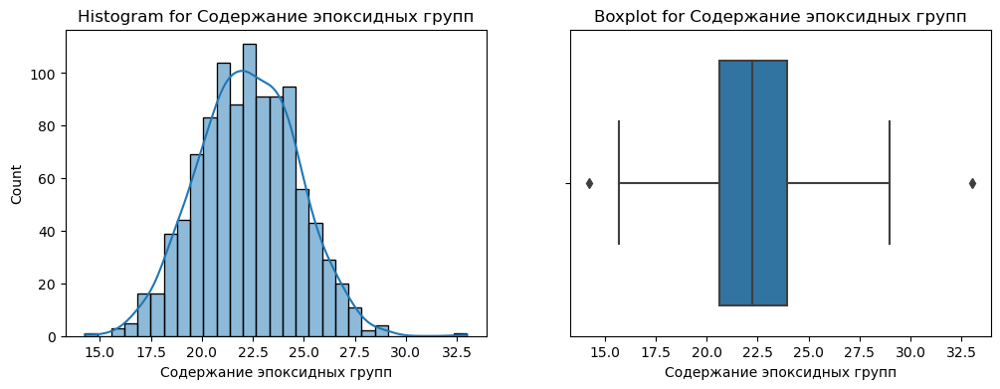

...

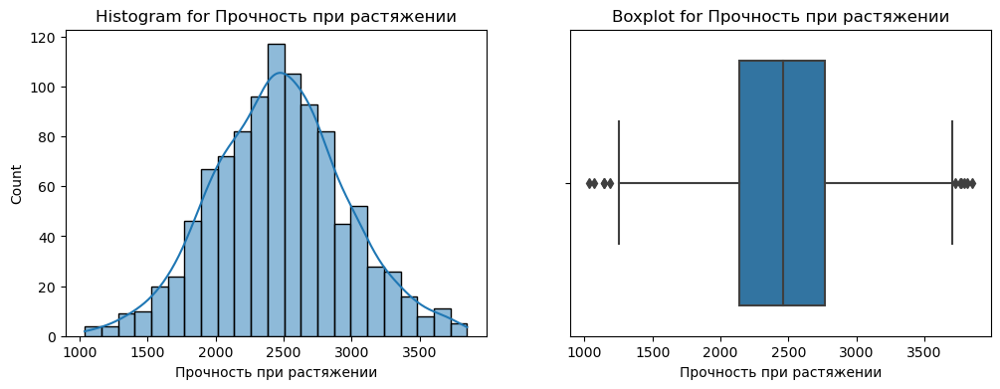

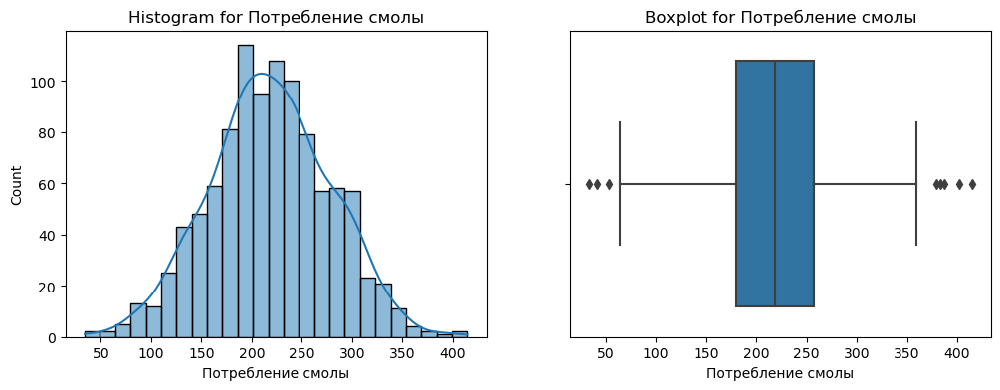

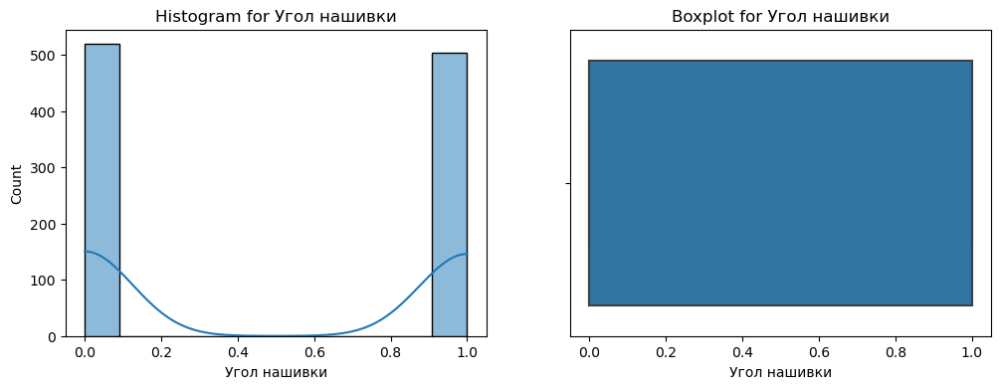

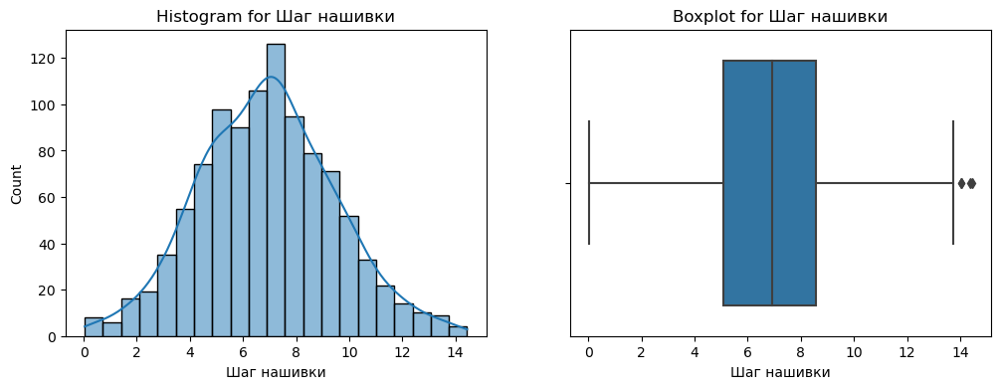

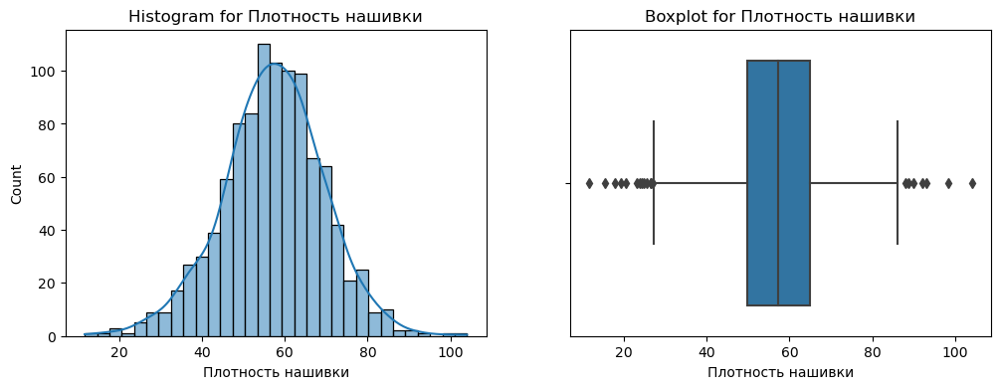

In [18]:
# гистограммы и диаграммы ящика с усами распределения каждой из переменной 
numerical_columns = df_in.columns.tolist()

for col in numerical_columns:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
    sns.histplot(df_in[col], ax=ax1, kde=True)
    ax1.set_title(f'Histogram for {col}')
    sns.boxplot(x=df_in[col], ax=ax2)
    ax2.set_title(f'Boxplot for {col}')
    plt.show()

In [19]:
# Тест на проверку нормальности распределения
numerical_columns = df_in.columns.tolist()

for col in numerical_columns:
    print(f'{col}: {normaltest(df_in[col])}')

Соотношение матрица-наполнитель: NormaltestResult(statistic=3.135507141157227, pvalue=0.20851306651324963)
Плотность: NormaltestResult(statistic=0.8083007930249202, pvalue=0.6675437174719052)
модуль упругости: NormaltestResult(statistic=4.519237353770332, pvalue=0.10439028359427267)
Количество отвердителя: NormaltestResult(statistic=2.1816220526660564, pvalue=0.33594392382235627)
Содержание эпоксидных групп: NormaltestResult(statistic=0.6159430148717809, pvalue=0.7349362579291967)
Температура вспышки: NormaltestResult(statistic=1.9756301929937505, pvalue=0.37238943779925526)
Поверхностная плотность: NormaltestResult(statistic=38.105045468728626, pvalue=5.316116749844541e-09)
Модуль упругости при растяжении: NormaltestResult(statistic=3.913973254927754, pvalue=0.14128351998738303)
Прочность при растяжении: NormaltestResult(statistic=1.061918482081828, pvalue=0.5880406263484683)
Потребление смолы: NormaltestResult(statistic=0.5971137411087343, pvalue=0.7418880890634496)
Угол нашивки: Nor

Выводы: 
- большинство колонок имеет нормальное распределение;
- в большинстве колонок имеются выбросы.

In [20]:
# Смотрим количество выбросов по колонкам
numerical_columns = df_in.columns.tolist()

Q1 = df_in[numerical_columns].quantile(0.25)
Q3 = df_in[numerical_columns].quantile(0.75)
IQR = Q3 - Q1

outliers = ((df_in[numerical_columns] < (Q1 - 1.5 * IQR)) | (df_in[numerical_columns] > (Q3 + 1.5 * IQR)))
print("Количество выбросов по каждому признаку:")
print(outliers.sum())

Количество выбросов по каждому признаку:
Соотношение матрица-наполнитель     6
Плотность                           9
модуль упругости                    2
Количество отвердителя             14
Содержание эпоксидных групп         2
Температура вспышки                 8
Поверхностная плотность             2
Модуль упругости при растяжении     6
Прочность при растяжении           11
Потребление смолы                   8
Угол нашивки                        0
Шаг нашивки                         4
Плотность нашивки                  20
dtype: int64


Исходя из диаграм Boxplot составляю список колонок в которых предполагаю наличие выбросов, которые можно удалить (удалять можно не более 2%, т.е. не более 20 записей). При этом, отвергаю те колонки, где много значений за пределами "Усов" Boxplot-ов. Предполагаю, что это реальные значения (возможно отдельный кластер) признаков.
Список колонок для проверки на выбросы: 'модуль упругости', 'Содержание эпоксидных групп', 'Температура вспышки'

In [21]:
outliers_df = find_outliers_iqr(df_in, 'модуль упругости')
print("Строки с выбросами:")
outliers_df

Анализ выбросов для колонки 'модуль упругости':
Q1 (25-й перцентиль): 499.32
Q3 (75-й перцентиль): 960.47
IQR: 461.14
Нижняя граница: -192.39
Верхняя граница: 1652.18
Найдено выбросов: 2
--------------------------------------------------
Строки с выбросами:


,Соотношение матрица-наполнитель,Плотность,модуль упругости,Количество отвердителя,Содержание эпоксидных групп,Температура вспышки,Поверхностная плотность,Модуль упругости при растяжении,Прочность при растяжении,Потребление смолы,Угол нашивки,Шаг нашивки,Плотность нашивки
592,1.487419,1949.031040,1911.536477,98.380762,19.447283,379.172951,426.917622,75.573334,2814.321842,256.522741,1,8.100387,54.843521
770,2.796648,2007.727318,1815.865170,117.162722,23.688583,300.914088,679.581560,79.518613,3103.000733,179.939702,1,5.108723,55.226873


In [22]:
# Удаление выбросов (Значения сильно выходят за границы "Усов" Boxplot)
df_in = remove_outliers_iqr(df_in, ['модуль упругости'])

In [23]:
outliers_df = find_outliers_iqr(df_in, 'Содержание эпоксидных групп')
print("Строки с выбросами:")
outliers_df

Анализ выбросов для колонки 'Содержание эпоксидных групп':
Q1 (25-й перцентиль): 20.61
Q3 (75-й перцентиль): 23.96
IQR: 3.35
Нижняя граница: 15.58
Верхняя граница: 28.99
Найдено выбросов: 2
--------------------------------------------------
Строки с выбросами:


,Соотношение матрица-наполнитель,Плотность,модуль упругости,Количество отвердителя,Содержание эпоксидных групп,Температура вспышки,Поверхностная плотность,Модуль упругости при растяжении,Прочность при растяжении,Потребление смолы,Угол нашивки,Шаг нашивки,Плотность нашивки
2,1.857143,2030.000000,738.736842,49.900000,33.000000,284.615385,210.000000,70.000000,3000.000000,220.000000,0,4.000000,70.000000
298,2.385109,2129.059629,589.782966,70.760954,14.254985,302.043927,676.050552,76.472254,2529.945213,92.307158,0,4.650262,63.956692


In [24]:
# Удаление выбросов (Значения сильно выходят за границы "Усов" Boxplot)
df_in = remove_outliers_iqr(df_in, ['Содержание эпоксидных групп'])

In [25]:
outliers_df = find_outliers_iqr(df_in, 'Температура вспышки')
print("Строки с выбросами:")
outliers_df

Анализ выбросов для колонки 'Температура вспышки':
Q1 (25-й перцентиль): 259.03
Q3 (75-й перцентиль): 313.04
IQR: 54.01
Нижняя граница: 178.01
Верхняя граница: 394.06
Найдено выбросов: 8
--------------------------------------------------
Строки с выбросами:


,Соотношение матрица-наполнитель,Плотность,модуль упругости,Количество отвердителя,Содержание эпоксидных групп,Температура вспышки,Поверхностная плотность,Модуль упругости при растяжении,Прочность при растяжении,Потребление смолы,Угол нашивки,Шаг нашивки,Плотность нашивки
0,1.857143,2030.000000,738.736842,30.000000,22.267857,100.000000,210.000000,70.000000,3000.000000,220.000000,0,4.000000,57.000000
175,2.011042,2094.769792,1057.597455,168.911556,21.558425,396.898222,447.184425,72.694298,1548.022724,181.404491,0,3.686535,44.369484
322,2.202033,1905.172266,828.691004,67.342235,19.525485,173.484920,269.230234,71.841083,2761.667212,206.436426,0,5.113466,67.063660
378,0.463342,1925.610616,992.760436,88.383137,22.147630,160.255843,951.222629,76.210116,2781.540025,127.652751,0,7.317168,33.326279
649,3.547512,1967.434093,741.259184,92.843804,23.553219,397.151291,438.290234,75.303394,2751.998207,196.822228,1,4.486241,52.235772
721,1.922883,2010.937896,837.613821,110.450712,22.109108,173.973907,585.310794,72.759959,2659.565599,143.805111,1,7.768986,67.045308
791,3.426368,2028.026074,453.458891,105.674852,22.415611,413.273418,586.715020,74.838137,2334.649515,233.293376,1,5.256326,46.966045
938,0.960288,1910.769529,80.081588,150.647888,26.817201,403.652861,756.286684,75.547761,2650.839969,307.937258,1,6.885764,62.784927


In [26]:
# Здесь ,только, одна запись явно выходит за границы и является выбросом - это 0-ая . Удаляю ее.
df_in = remove_outliers_iqr(df_in, ['Температура вспышки'],2)

Вывод: Удалось обнаружить не значительное количество выбросов. Они были удалены. Большинство значений, которые на BoxPlot определяются как выбросы, скорее всего, не являются выбросами. 
Данные в большинстве колонок распределены нормально (pvalue > 0.05). В колонках "Поверхностная плотность" и "Плотность нашивки" тест показывает, что данные распределены не нормально.      

## Анализ зависимостей (на полном датасете 1023 строки)
Выявил, что значимых линейных зависимостей нет. 

Строю матрицу корреляции. Она покажет только линейные корреляции. 

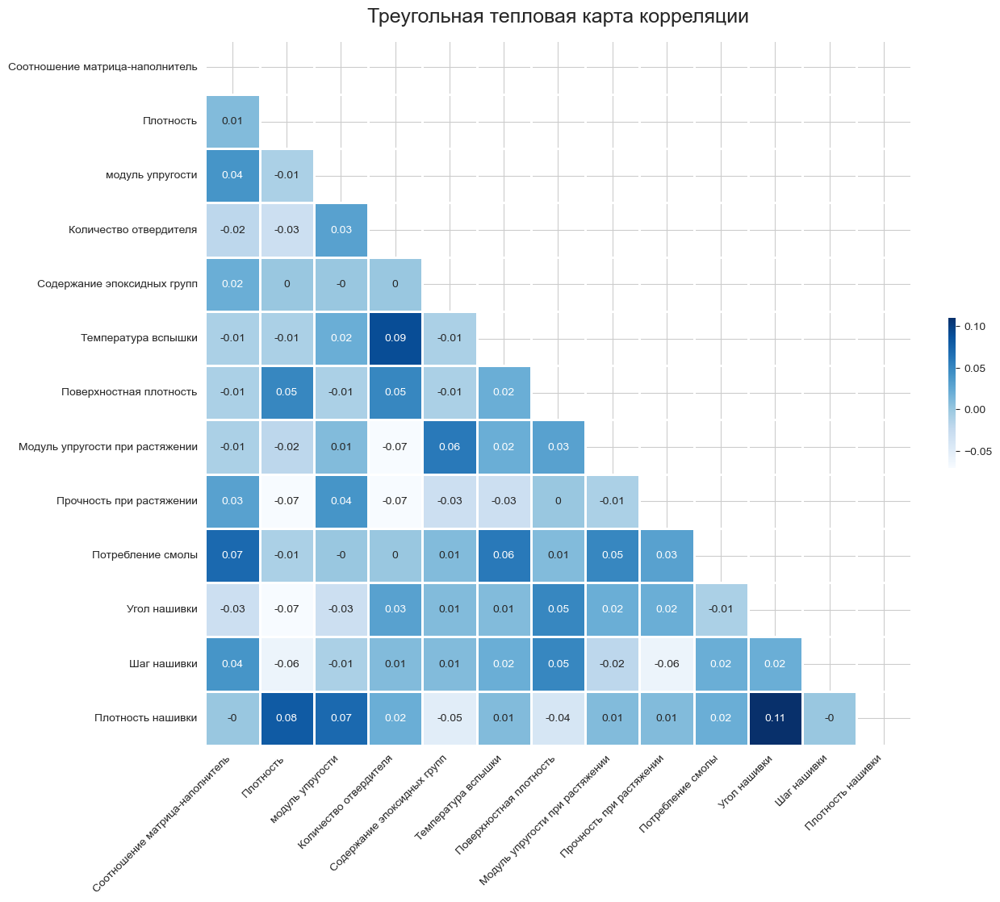

In [27]:
plt.rcParams["figure.figsize"] = (12,12)
#sns.heatmap(df.corr(), annot=True, fmt='0.2f')  
sns.set_style("whitegrid")

# Воспользуемся функциями np.triu, чтобы изолировать верхний треугольник (np.tril нижний)
# функция np.ones_like() изменит все изолированные значения на 1.
mask = np.triu(np.ones_like(df_in.corr(), dtype=bool))

heatmap = sns.heatmap(
    df_in.corr().round(2),
    annot=True,
    square=True,
    cmap="Blues",
    cbar_kws={"fraction": 0.01},
    linewidth=2,
    
    mask=mask,
)

heatmap.set_title(
    "Треугольная тепловая карта корреляции", fontdict={"fontsize": 18}, pad=16
);

heatmap.set_xticklabels(
    heatmap.get_xticklabels(), rotation=45, horizontalalignment="right"
);

Линейные корреляции очень слабые. Предполагаю, что между признаками и целевыми переменными связь нелинейна. 

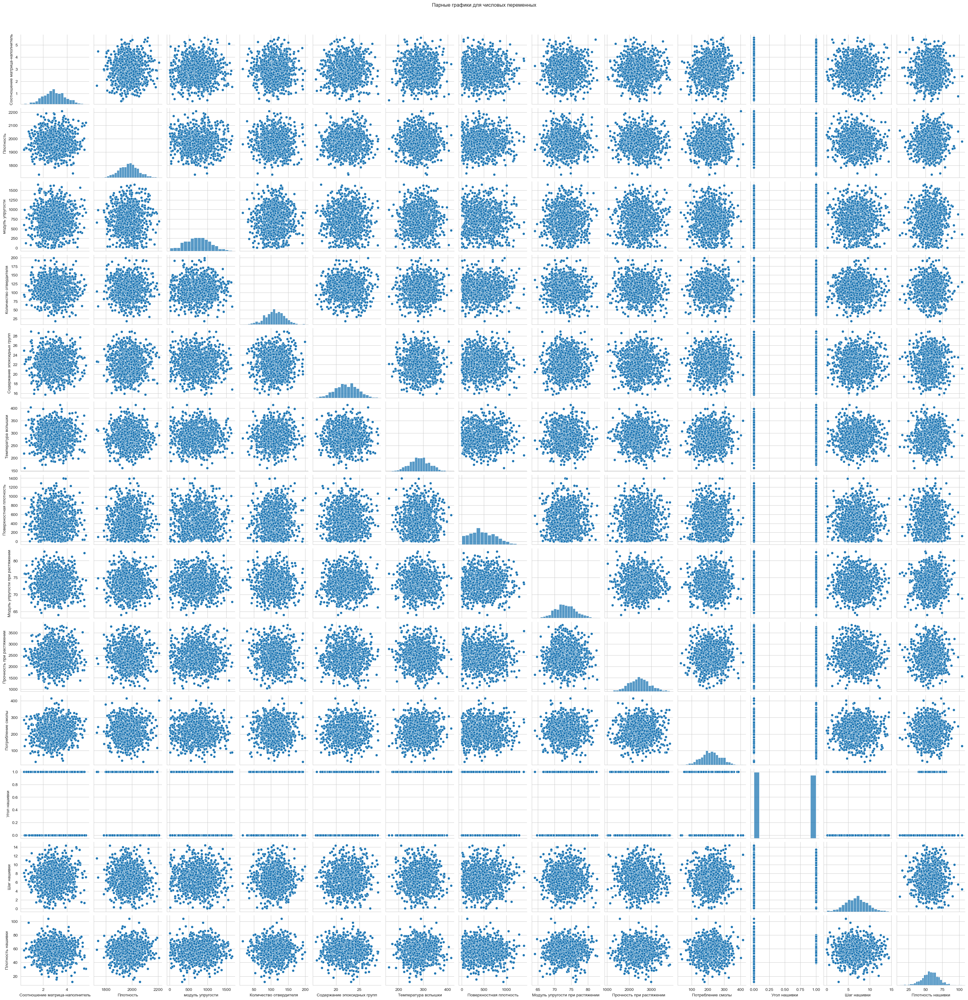

In [28]:
# Парные графики
df_in = df_in.copy()
numerical_columns = df_in.columns.tolist()
#numerical_columns.remove('Угол нашивки')
sns.pairplot(df_in[numerical_columns])
plt.suptitle('Парные графики для числовых переменных', y=1.02)
plt.show()

На парных графиках линейных и явных нелинейных зависимостей не наблюдается. Данные имеют шарообразную форму , поэтому предполагаю, что лучшие результаты будут показывать модели, которые основаны не на линейной регрессии, например KNN или RandomForest. Очевидного деления на кластеры не наблюдается.

## Оценка важности и вариативности признаков (на полном датасете 1023 строки)

С помощью механизма permutation_importance определяю какие признаки более значимы для определения нашего таргета

In [29]:
from sklearn.inspection import permutation_importance
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.pipeline import Pipeline
from sklearn.linear_model import RidgeCV, Ridge
from sklearn.preprocessing import StandardScaler

def plot_prmt_importance(model, X_test, y_test, n_repeats=10):
    # Вычисляем важность признаков
    result = permutation_importance(
        model, X_test, y_test,
        n_repeats=n_repeats,    # количество повторений
        random_state=42
    )

    # Результаты
    importance_scores = result.importances_mean
    importance_std = result.importances_std

    # Сортируем по важности
    sorted_idx = importance_scores.argsort()[::-1]

    plt.figure(figsize=(10, 6))
    plt.bar(range(len(importance_scores)), importance_scores[sorted_idx])
    plt.xticks(range(len(importance_scores)), sorted_idx)
    plt.title("Важность признаков (permutation importance)")
    plt.xlabel("Номер признака")
    plt.ylabel("Важность")
    plt.show() 

def prmt_importance(model, X_test, y_test, feature_names, n_repeats=50):
    
    # Вычисляем важность
    result = permutation_importance(
        model, X_test, y_test,
        n_repeats=n_repeats,
        scoring='r2',
        random_state=42
    )
    
    # Создаем список кортежей (имя, важность, std)
    features_with_importance = []
    for i, name in enumerate(feature_names):
        features_with_importance.append({
            'name': name,
            'importance': result.importances_mean[i],
            'std': result.importances_std[i]
        })
    
    # Сортируем по важности
    features_with_importance.sort(key=lambda x: x['importance'], reverse=True)
    
    # Выводим результаты
    print("ВАЖНОСТЬ ПРИЗНАКОВ:")
    print("-" * 50)
    for feature in features_with_importance:
        print(f"{feature['name']:35}: {feature['importance']:7.3f} ± {feature['std']:.3f}")
    
    return features_with_importance

def get_importance(prm_df, prm_str_y, prm_feature_names):

    X = prm_df.copy()
    y = prm_df[prm_str_y]
    X.drop([prm_str_y],axis=1,inplace=True)

    X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.30,random_state=42)

    #cf = KFold() 
    pipe = Pipeline( 
    [ 
        ('Scaler',StandardScaler()),
        #('Reg', RandomForestRegressor(n_estimators=200,      
        #                              max_depth=None, 
        #                              min_samples_split=2, 
        #                              min_samples_leaf=1,    # Минимальные образцы в листе
        #                              random_state=42,       
        #                              n_jobs=-1)) 
        #('Reg', RidgeCV(cv=cf)) 
        ('Reg', Ridge(alpha=5.0))            
    ] 
    )

    pipe.fit(X_train, y_train)

    # Оценка базового качества
    train_score = pipe.score(X_train, y_train)
    test_score = pipe.score(X_test, y_test)
    print(f"Train score: {train_score:.3f}, Test score: {test_score:.3f}")
    #print("**** на Train ****")
    #df_out = prmt_importance(pipe, X_train, y_train, feature_names)
    #print("\r")
    print("**** на Test ****")
    df_out = prmt_importance(pipe, X_test, y_test, prm_feature_names)
    plot_prmt_importance(pipe, X_test, y_test)
   

Train score: 0.031, Test score: -0.032
**** на Test ****
ВАЖНОСТЬ ПРИЗНАКОВ:
--------------------------------------------------
Плотность                          :   0.010 ± 0.010
Плотность нашивки                  :   0.008 ± 0.009
Количество отвердителя             :   0.004 ± 0.011
модуль упругости                   :   0.003 ± 0.002
Содержание эпоксидных групп        :   0.002 ± 0.003
Температура вспышки                :   0.001 ± 0.002
Угол нашивки                       :   0.001 ± 0.000
Шаг нашивки                        :   0.000 ± 0.001
Соотношение матрица-наполнитель    :  -0.002 ± 0.007
Потребление смолы                  :  -0.008 ± 0.004
Поверхностная плотность            :  -0.012 ± 0.006


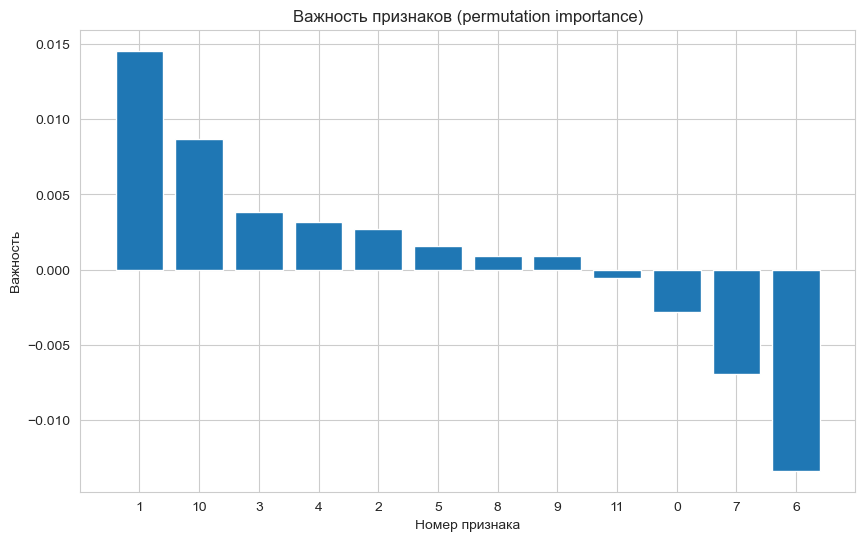

In [30]:
feature_names = ['Соотношение матрица-наполнитель','Плотность','модуль упругости','Количество отвердителя','Содержание эпоксидных групп','Температура вспышки','Поверхностная плотность','Потребление смолы','Угол нашивки','Шаг нашивки','Плотность нашивки']
get_importance(df_in, 'Прочность при растяжении', feature_names)

Train score: 0.021, Test score: -0.019
**** на Test ****
ВАЖНОСТЬ ПРИЗНАКОВ:
--------------------------------------------------
Количество отвердителя             :   0.008 ± 0.008
Содержание эпоксидных групп        :   0.007 ± 0.006
Угол нашивки                       :   0.006 ± 0.004
Поверхностная плотность            :   0.003 ± 0.002
Плотность                          :   0.003 ± 0.003
Шаг нашивки                        :   0.001 ± 0.002
модуль упругости                   :   0.001 ± 0.002
Соотношение матрица-наполнитель    :   0.000 ± 0.002
Потребление смолы                  :  -0.000 ± 0.003
Плотность нашивки                  :  -0.000 ± 0.006
Температура вспышки                :  -0.006 ± 0.005


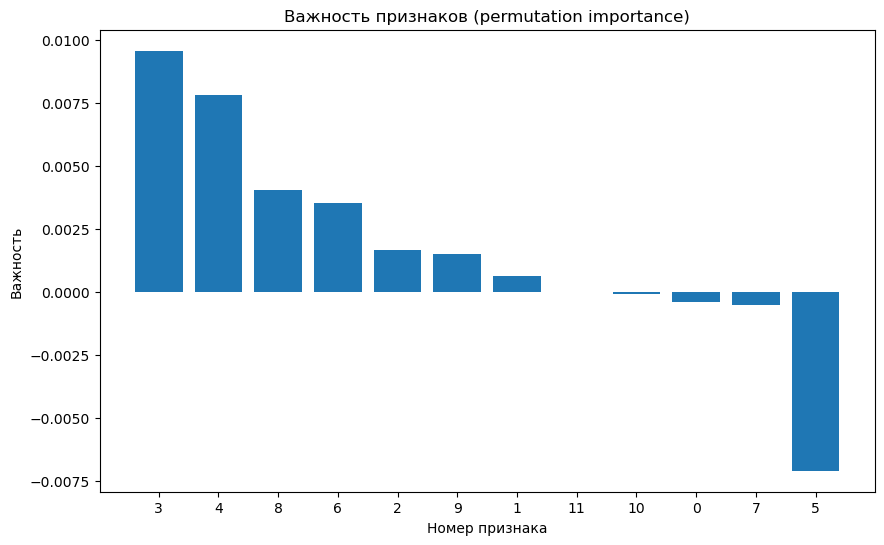

In [23]:
feature_names = ['Соотношение матрица-наполнитель','Плотность','модуль упругости','Количество отвердителя','Содержание эпоксидных групп','Температура вспышки','Поверхностная плотность','Потребление смолы','Угол нашивки','Шаг нашивки','Плотность нашивки']
get_importance(df_in, 'Модуль упругости при растяжении', feature_names)

Выводы:
- на значение целевой переменной "Прочность при растяжении" оказывают основное влияние значения в колонках "Плотность", "Количество отвердителя" и "Плотность нашивки";
- на значение целевой переменной "Модуль упругости при растяжении" оказывают основное влияние значения в колонках "Количество отвердителя", "Содержание эпоксидных групп" и "Угол нашивки".  

Вывод: Колонка 'Соотношение матрица-наполнитель' ухудшает прогностическую способность модели при предсказании значений колонок 'Прочность при растяжении','Модуль упругости при растяжении' . Колонка 'Плотность нашивки' ухудшает прогностическую способность модели при прогнозировании значений колонки 'Соотношение матрица-наполнитель'.    

 

## Кластерный анализ (на полном датасете 1023 строки)
Есть предположение, что данные сильно зашумлены. В начале датасета есть набор визуально отличающихся строк. Поэтому, я делаю попытку разбиения на кластеры в расчете на обнаружение чистых данных в отдельном кластере. Пробовал разделение на большое количество кластеров (40, 50, 80) - расчет на то, что большинство реальных данных окажутся в одном кластере, а не правильные (не родные) данные рассыпятся по остальным кластерам. Пробовал делить на небольшое количество кластеров (3, 4, 6,...) - в расчете на то, что не родные данные могут быть, тоже, согласованными между собой и образуют большие кластеры. Устойчивых кластеров выявить не удалось. Возможно нужно больше времени на это потратить и более внимательно взглянуть.  

### Кластеры

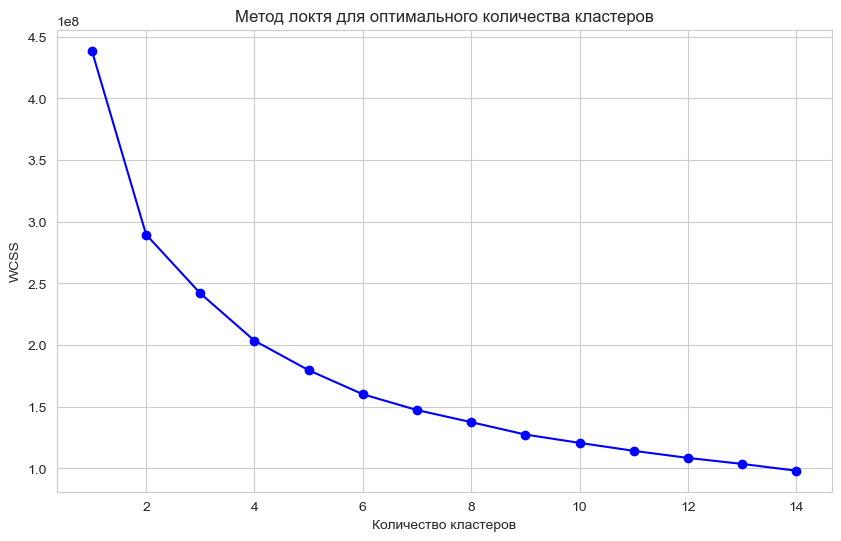

In [31]:
df_cmeans = df_in.copy()
wcss(df_cmeans)

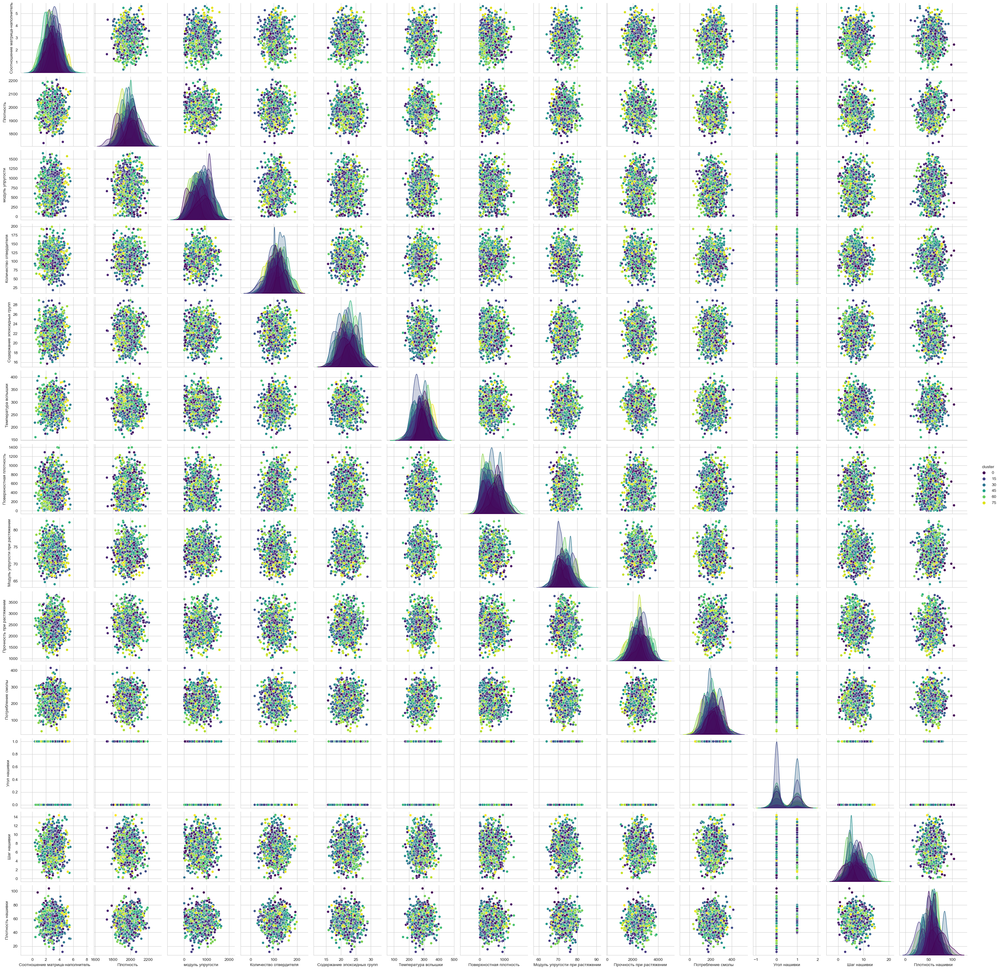

Размеры кластеров:
18    26
26    22
51    22
71    21
29    21
      ..
75     6
25     5
79     4
45     3
76     3
Name: cluster, Length: 80, dtype: int64
Самый большой кластер № 18: 26

Центры кластеров:
          0         1         2         3         4         5         6   \
0  -0.676671  0.567408  0.360398  0.714283  0.497422  0.270841  0.068917   
1  -0.386624  0.715880 -1.237363 -0.488986 -0.449581  0.453708  0.795563   
2   0.392380 -1.745764  0.365379  0.994189  0.135080  0.157135 -0.896988   
3  -0.237494  0.468297 -0.031943  0.732977 -0.586336  0.570931  1.136732   
4  -0.288024  0.336142 -0.090621 -0.083900 -0.823896 -0.281105  0.444397   
..       ...       ...       ...       ...       ...       ...       ...   
75 -0.844493  0.568138 -0.753931 -1.467381  0.560883 -0.697635 -0.077856   
76  2.514607  1.923356  0.754802 -0.369734 -0.467301 -1.660726 -0.840818   
77  1.452586 -0.397025  0.683332  0.162324  0.483058  0.619756 -0.823061   
78  0.639599  0.427575  0.513549

In [32]:
df_cmeans = df_in.copy()
df_cluster = get_Cluster_KMeans(df_cmeans, claster_num = 80)

In [33]:
df1 = df_cluster[df_cluster['cluster'] == 64]
df1


,Соотношение матрица-наполнитель,Плотность,модуль упругости,Количество отвердителя,Содержание эпоксидных групп,Температура вспышки,Поверхностная плотность,Модуль упругости при растяжении,Прочность при растяжении,Потребление смолы,Угол нашивки,Шаг нашивки,Плотность нашивки,cluster
9,3.532338,2100.000000,1421.000000,129.000000,21.250000,300.000000,1010.000000,78.000000,2000.000000,300.000000,0,7.000000,60.000000,64
10,2.919678,2160.000000,933.000000,129.000000,21.250000,300.000000,1010.000000,78.000000,2000.000000,300.000000,0,7.000000,70.000000,64
11,2.877358,1990.000000,1628.000000,129.000000,21.250000,300.000000,1010.000000,78.000000,2000.000000,300.000000,0,9.000000,47.000000,64
221,2.051710,2161.565216,1012.659478,145.167640,24.603621,274.893657,837.480364,81.175231,2011.622551,176.817505,0,5.076483,70.979716,64
223,2.423458,2142.065822,1023.452750,94.895267,22.054219,277.987974,865.085411,78.139785,2964.005840,211.530319,0,6.853963,45.453985,64
310,4.474968,1982.377729,1152.883022,102.653478,20.069592,257.782207,814.741122,78.629422,2748.405735,220.730316,0,7.501821,71.570028,64
364,3.170440,2048.585970,1210.607454,122.710723,21.442178,263.984442,681.714387,75.819722,2896.345346,256.737402,0,7.159747,65.951288,64
376,4.620887,2017.040094,1050.535971,114.644485,23.745495,252.147541,701.842769,80.018778,2170.596710,232.531076,0,7.259911,53.415599,64


# Шаг3:   Предобработка (на полном датасете 1023 строки)

## Функции

In [34]:
# Функция для генерация данных с шумом (была попытка добавить записей в тестовый набор в модели KNRegressor. Реализовал, но эфекта не дало - R2 остался отрицательным)
from copy import deepcopy

def add_smart_noise(dataset, target_col, percentage=50, noise_level=0.1, random_state=42):
   
    #Умное добавление шума с учетом распределения данных
   
    np.random.seed(random_state)
    
    X = dataset.drop(columns=[target_col])
    y = dataset[target_col]
    
    n_new_samples = int(len(dataset) * percentage / 100)
    new_samples = []
    
    # Вычисляем статистики для каждого признака
    stats = {}
    for col in X.columns:
        if pd.api.types.is_numeric_dtype(X[col]):
            stats[col] = {
                'mean': X[col].mean(),
                'std': X[col].std(),
                'min': X[col].min(),
                'max': X[col].max()
            }
    
    for _ in range(n_new_samples):
        # Выбираем случайный образец
        idx = np.random.randint(0, len(dataset))
        original_sample = dataset.iloc[idx].copy()
        new_sample = deepcopy(original_sample)
        
        # Добавляем шум к каждому признаку
        for col in X.columns:
            if pd.api.types.is_numeric_dtype(X[col]):
                if set(X[col].unique()).issubset({0, 1}):  # Бинарный признак
                    if np.random.random() < noise_level * 0.05:
                        new_sample[col] = 1 - new_sample[col]
                else:  # Непрерывный признак
                    noise = np.random.normal(0, noise_level * stats[col]['std'])
                    new_value = new_sample[col] + noise
                    # Ограничиваем значения разумными пределами
                    new_value = max(stats[col]['min'] * 0.9, min(stats[col]['max'] * 1.1, new_value))
                    new_sample[col] = new_value
        
        # Добавляем шум к целевой переменной
        if pd.api.types.is_numeric_dtype(y):
            y_std = y.std()
            y_noise = np.random.normal(0, noise_level * y_std)
            new_sample[target_col] += y_noise
        
        new_samples.append(new_sample)
    
    extended_dataset = pd.concat([dataset, pd.DataFrame(new_samples)], ignore_index=True)
    return extended_dataset

## Фильтрация данных
Здесь была масса неудачных попыток фильтрации, преобразования значений признаков

In [35]:
df_ML = df_in.copy()
df_ML = df_ML.drop(df_ML[df_ML['Шаг нашивки'] == 0].index)  # Удаляем строку с 0-ыми исходными данными

#df_ML = df_ML.drop(df_ML[df_ML['Угол нашивки'] == 90].index)
#df_in.drop(['Угол нашивки'],axis=1,inplace=True)

df_ML.loc[df_ML['Угол нашивки'] == 90, 'Угол нашивки'] = 1
df_ML['Прочность при растяжении'] = df_ML['Прочность при растяжении'] / 1000.0

# Попытки получить какие-то новые более сильные признаки -->
#df_ML['Плотность'] = df_ML['модуль упругости'] * (df_ML['Плотность']**2) #/ df_ML['Количество отвердителя'] 
#df_ML.drop(['модуль упругости'],axis=1,inplace=True)
#df_in['Количество отвердителя'] = df_in['Количество отвердителя'] / df_in['Температура вспышки']
#df_ML.drop(['Температура вспышки'],axis=1,inplace=True)
#df_ML.drop(['Количество отвердителя'],axis=1,inplace=True)
#df_in['Шаг нашивки'] = df_in['Шаг нашивки'] * df_in['Плотность нашивки']
#df_in.drop(['Плотность нашивки'],axis=1,inplace=True)
#df_in['Плотность'] = df_in['модуль упругости'] * 1000 / df_in['Плотность']
# Попытки получить какие-то новые более сильные признаки <--

df_NNW = df_ML.copy()

## Генерация дополнительных данных (тупиковая ветвь - лучше не стало)
Предполагаю, что отрицательный R2 может быть связан с небольшим количеством записей (1000 записей и 12 признаков) и поэтому предполагаю, что искусственное увеличение записей может улучшить показатели (добиться положительного R2).

Алгоритм следующий:
- после разделения на Train и Test беру складываю TrainX + TrainY в TrainXY;
- TrainXY грамотно зашумляю (увеличиваю количество записей с тем же средним с добавкой шума только к признакам);
- Разбиваю  обратно TrainXY на  TrainX и TrainY
- обучаю модель

Результат: ничего не дало - R2 - отрицательный

In [36]:
#df_in = remove_outliers_iqr(df_in)
# Копируем данные в новый датасет (для построения моделей прогнозирования колонок 'Прочность при растяжении','Модуль упругости при растяжении') и удаляем из него колонку 'Соотношение матрица-наполнитель'
df_ML = df_in.copy()
df_NNW = df_in.copy()
#df_ML.drop(['Соотношение матрица-наполнитель','Угол нашивки'],axis=1,inplace=True)
#df_ML.drop(['Соотношение матрица-наполнитель'],axis=1,inplace=True)

Ниже проверка идеи добавления записей с шумом в датасет. Построил BoxPlot-ы до и после по всем колонкам. Проверял, что распределения в колонках останутся прежними. Да, - распределения остались прежними.

In [37]:
df_ML1 = df_in.copy()
#df_ML1.drop(['Модуль упругости при растяжении'],axis=1,inplace=True)
#df_ML_noise = add_smart_noise(df_ML1, 'Прочность при растяжении', percentage=20)
df_ML1.drop(['Прочность при растяжении'],axis=1,inplace=True)
df_ML_noise = add_smart_noise(df_ML1,'Модуль упругости при растяжении' , percentage=20)


In [6]:
# генерация доп. данных
#df_model1 = df_in.copy()
#df_Train_Net = add_smart_noise(df_model1, 'Соотношение матрица-наполнитель', percentage=20)


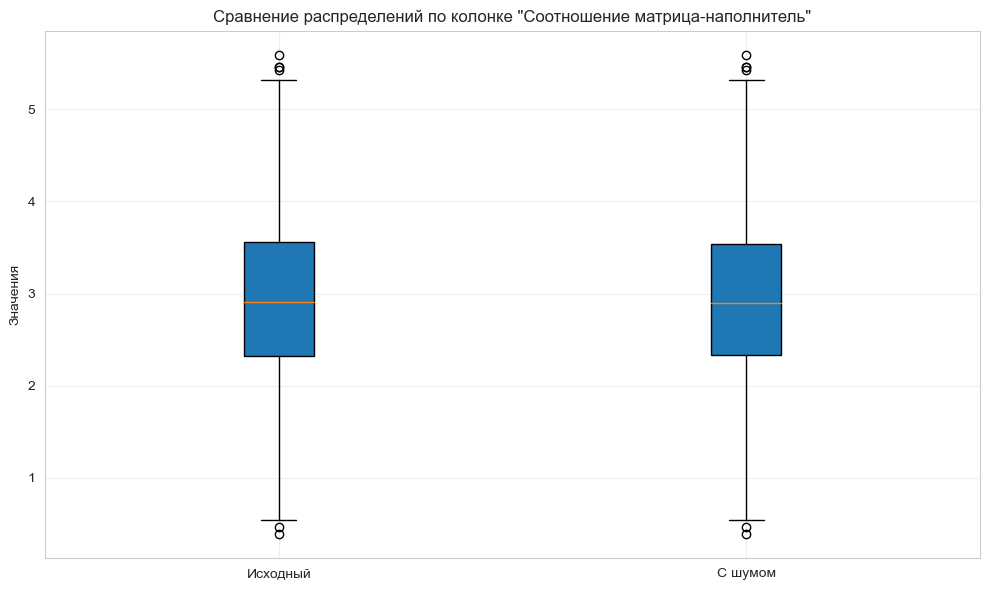

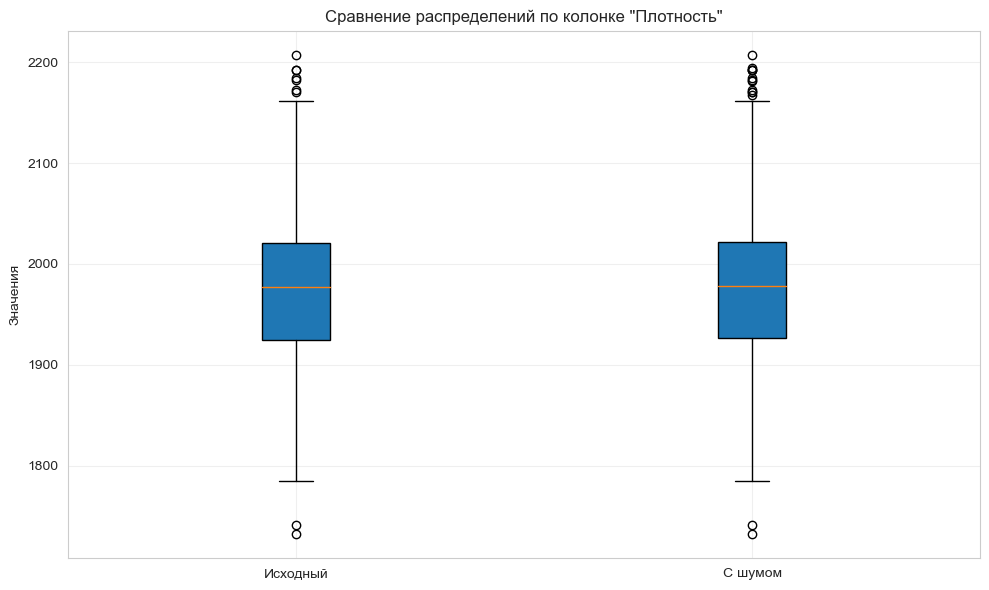

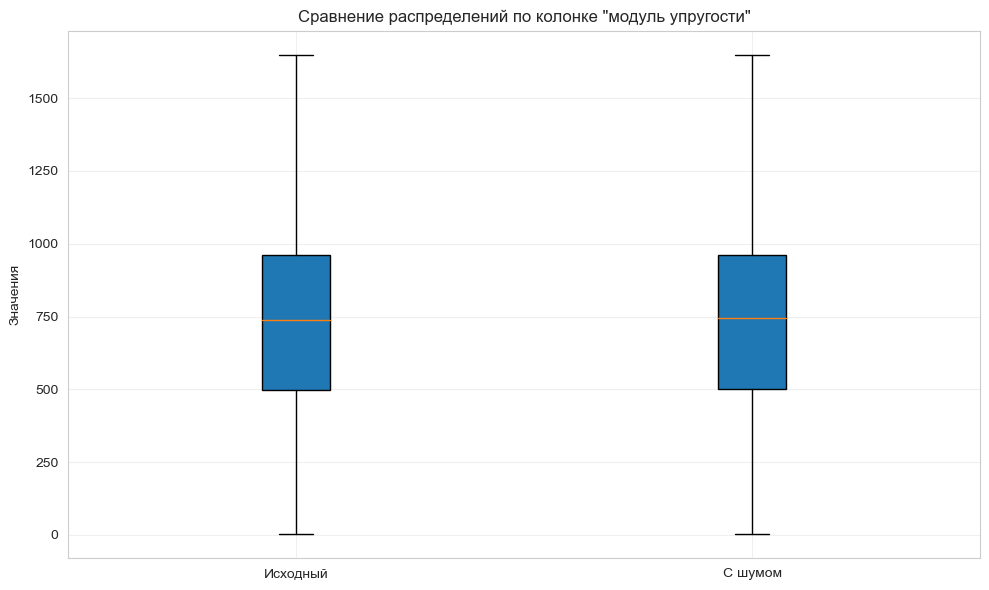

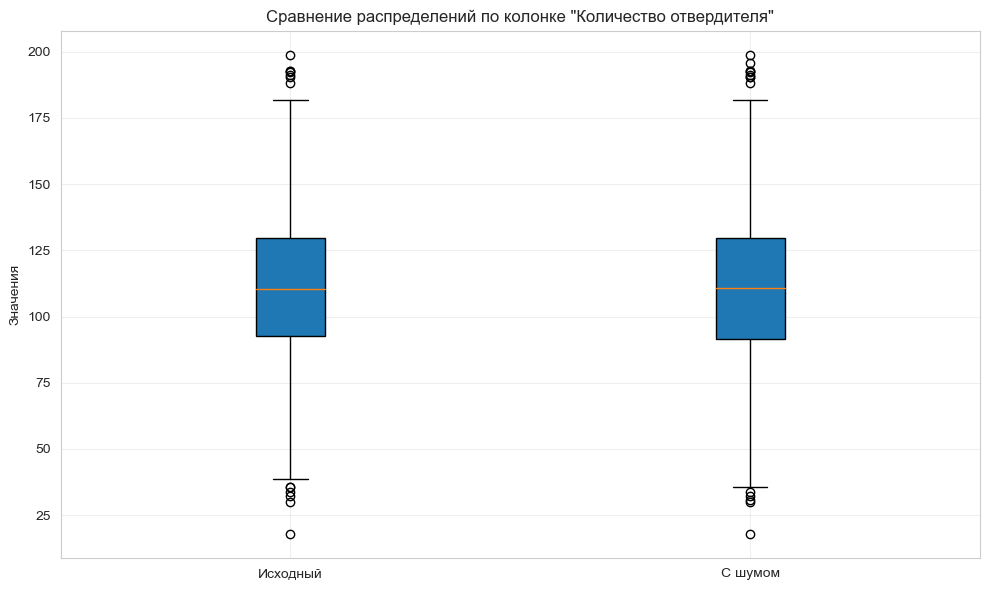

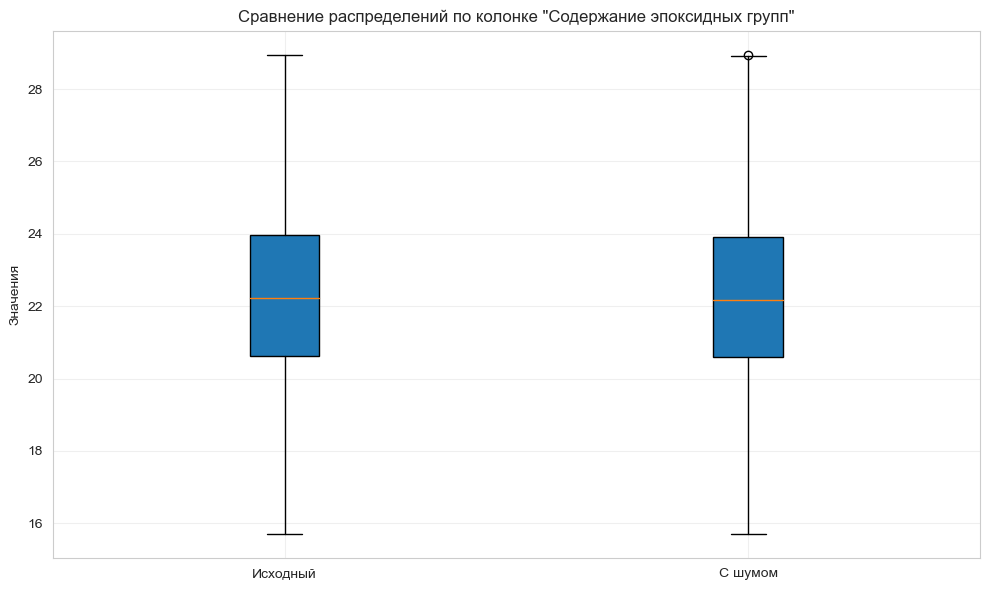

...

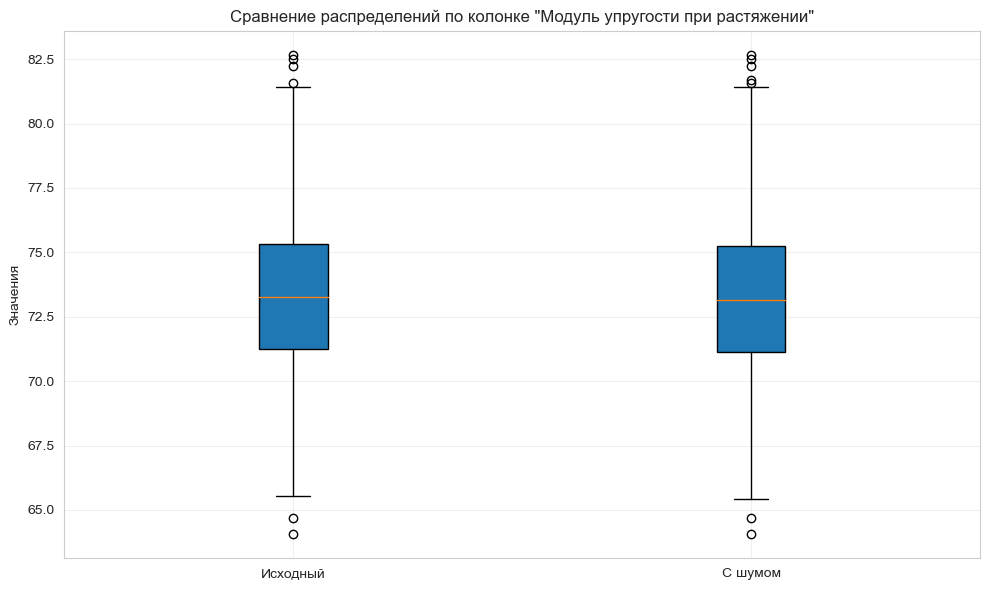

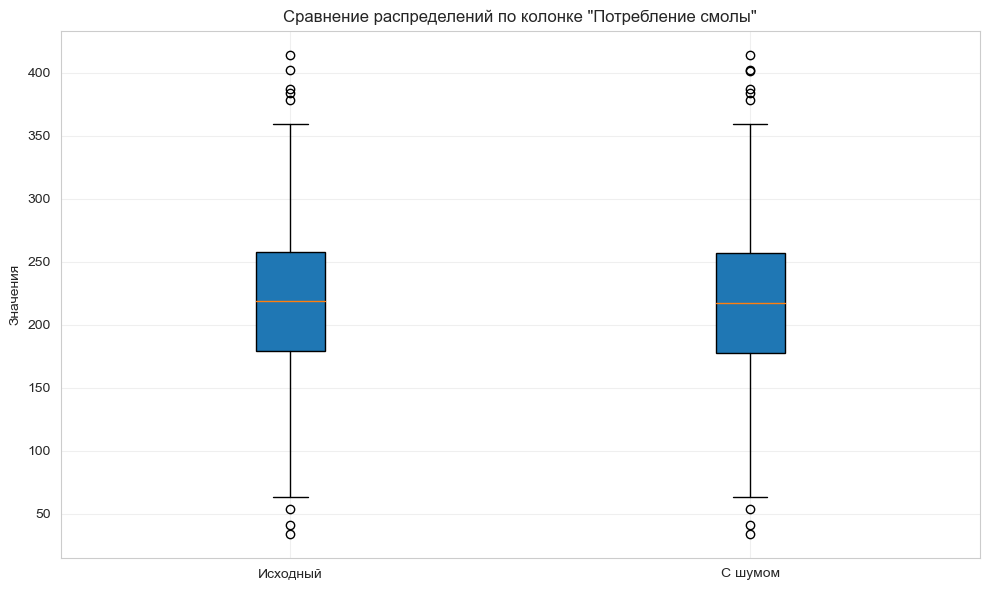

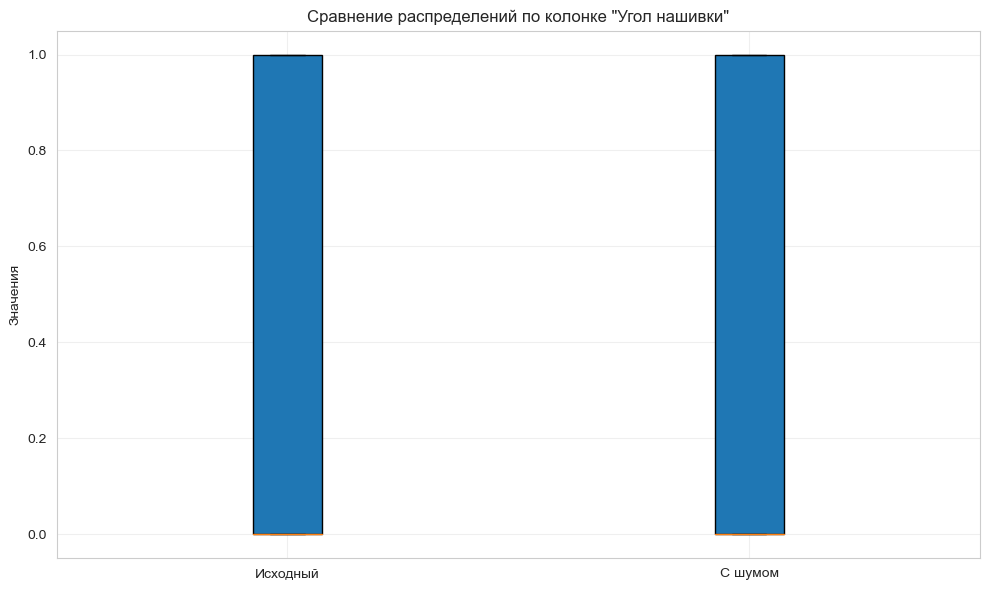

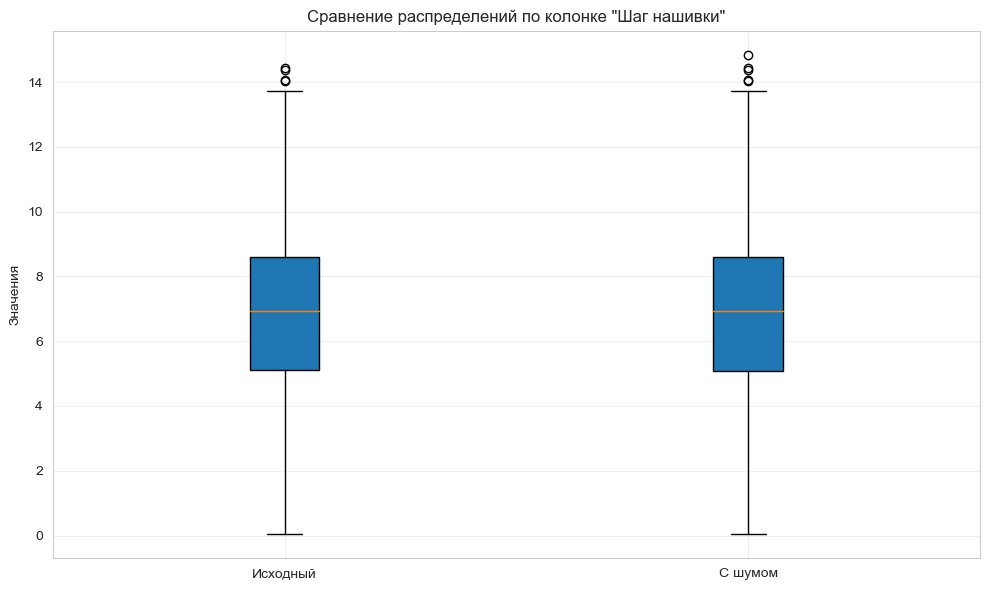

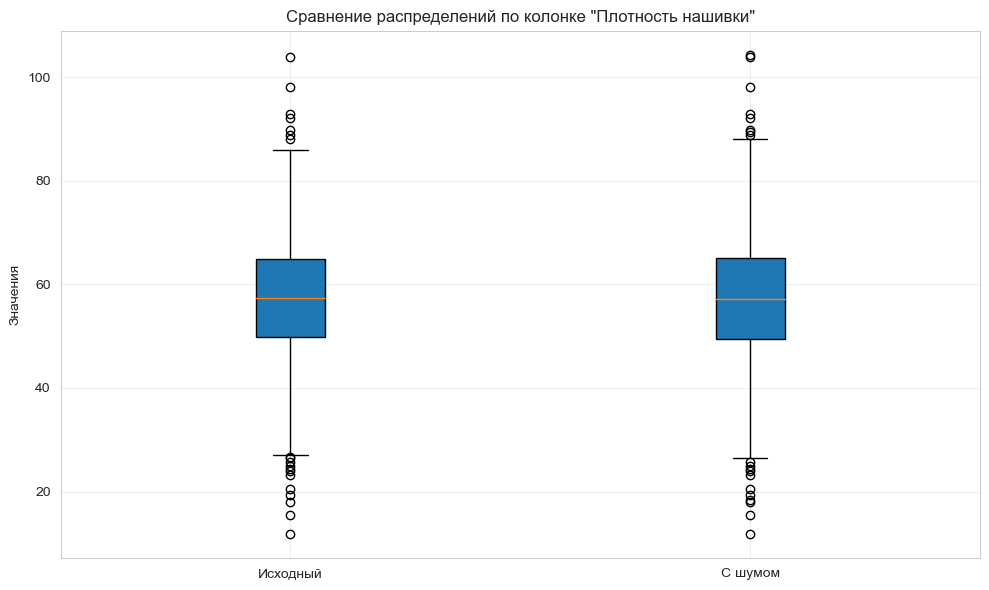

In [38]:
for column in df_ML1.columns:
    # Создаем фигуру и оси
    plt.figure(figsize=(10, 6))
    # Строим boxplot для каждого датасета
    #column = 'Прочность при растяжении'
    plt.boxplot([df_ML1[column], df_ML_noise[column]], 
            labels=['Исходный', 'С шумом'],patch_artist=True)

    # Настройки графика
    plt.title(f'Сравнение распределений по колонке "{column}"')
    plt.ylabel('Значения')
    plt.grid(True, alpha=0.3)

    # Показываем график
    plt.tight_layout()
    plt.show()

## Масштабирование признаков
В исследуемом датасете значения в разных колонках имеют разные размерности и диаппазоны значений. Поэтому, необходимо провести масштабирование признаков. Это улучшит работу алгоритмов, чувствительных к масштабу (KNN, SVM, нейросети, модели использующие градиентный спуск), ускоряется сходимость и повышается стабильность моделей. Из вариантов масштабаторов MinMaxScaler, StandardScaler и RobustScaler я выбрал StandardScaler, т.к. в большинстве колонок значения имеют распределение близкое к нормальному и  StandardScaler достаточно хорошо работает с выбросами. К тому же, я попробовал работу с разными скелерами - практической разницы не выявлено. 

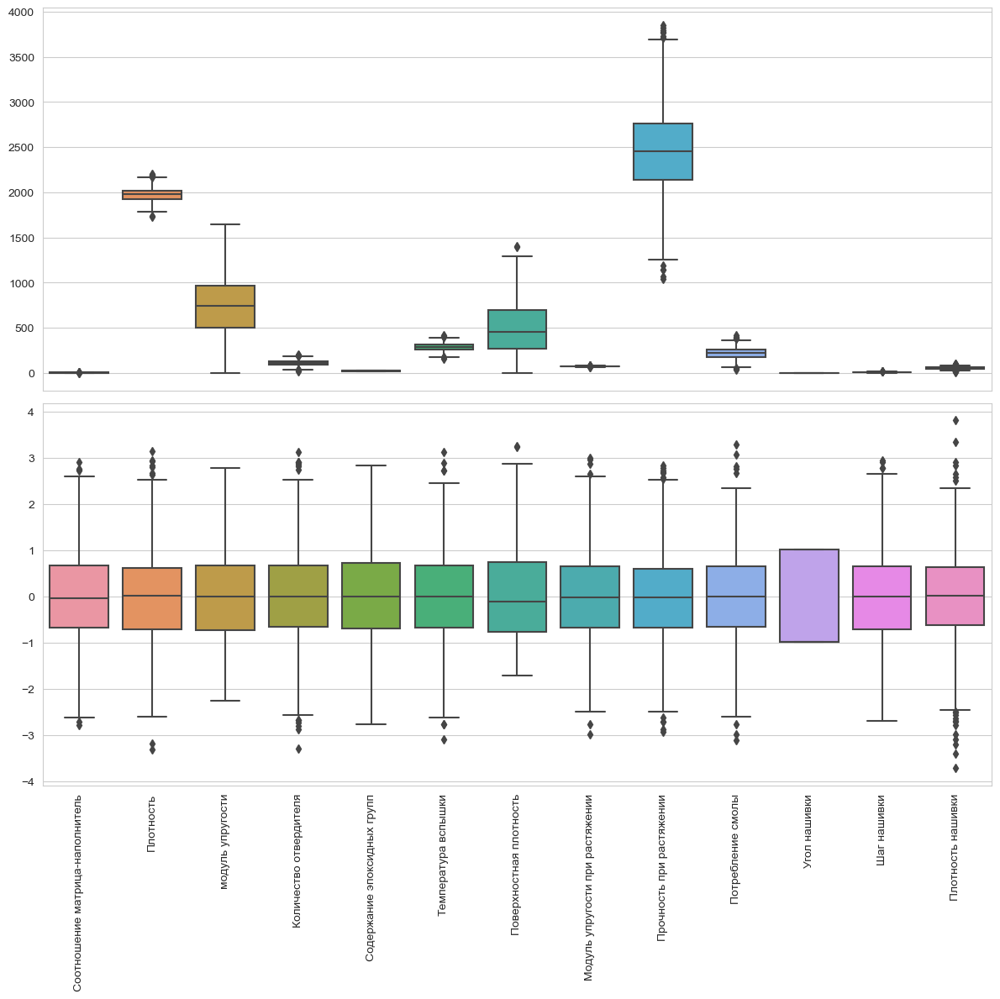

In [39]:
import seaborn as sns

# В случае построения моделей нужно правильно применять fit_transform и fit
#X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.30,random_state=42)
#scaler = StandardScaler() # Стандартизация данных
#scaled_data = scaler.fit_transform(X_train)
#...

scaler = StandardScaler() # Стандартизация данных
df_scaler = scaler.fit_transform(df_in)

fig, axes = plt.subplots(nrows = 2, ncols = 1) 
fig.set_size_inches(12, 12) 

df_scaler1 = pd.DataFrame(df_scaler,columns=df_in.columns, index=df_in.index)
 
#sns.distplot(df_in['Прочность при растяжении'].dropna(), kde = False, ax = axes[0]) 
#sns.distplot(df_scaler1['Прочность при растяжении'], kde = False, ax = axes[1], color = 'red') 
 
sns.boxplot(data = pd.concat([df_in], axis = 1), 
                ax = axes[0])
axes[0].set_xticklabels([]) 

sns.boxplot(data = pd.concat([df_scaler1], axis = 1), 
                ax = axes[1]).set_xticklabels(axes[1].get_xticklabels(), rotation=90)

plt.tight_layout()

In [40]:
df_in.describe().T

,count,mean,std,min,25%,50%,75%,max
Соотношение матрица-наполнитель,1008.0,2.932918,0.914792,0.389403,2.319283,2.908811,3.553931,5.591742
Плотность,1008.0,1975.512338,73.811426,1731.764635,1924.037615,1977.574305,2021.238927,2207.773481
модуль упругости,1008.0,737.676846,327.875816,2.436909,498.577158,739.310747,961.650808,1649.415706
Количество отвердителя,1008.0,110.633495,28.200430,17.740275,92.455582,110.511179,129.728210,198.953207
Содержание эпоксидных групп,1008.0,22.242804,2.371076,15.695894,20.618537,22.230761,23.963510,28.955094
Температура вспышки,1008.0,285.945330,40.644314,160.255843,258.951066,285.922290,313.029126,413.273418
Поверхностная плотность,1008.0,481.957961,281.503411,0.603740,266.978731,451.311408,692.795552,1399.542362
Модуль упругости при растяжении,1008.0,73.314317,3.114345,64.054061,71.233343,73.259230,75.336629,82.682051
Прочность при растяжении,1008.0,2464.627679,487.103648,1036.856605,2134.535871,2455.974462,2761.462095,3848.436732
Потребление смолы,1008.0,218.636134,59.695745,33.803026,179.650551,219.189018,257.563889,414.590628


In [12]:
scaler = StandardScaler() # Стандартизация данных
df_scaler = scaler.fit_transform(df_in)
df_scaler1 = pd.DataFrame(df_scaler,columns=df_in.columns, index=df_in.index)
df_scaler1.describe().T

,count,mean,std,min,25%,50%,75%,max
Соотношение матрица-наполнитель,1023.0,-2.170524e-17,1.000489,-2.783776,-0.671007,-0.025733,0.681760,2.915695
Плотность,1023.0,8.612639e-16,1.000489,-3.310622,-0.699921,0.025603,0.619318,3.148712
модуль упругости,1023.0,3.229740e-16,1.000489,-2.234332,-0.726742,-0.000784,0.672249,3.549589
Количество отвердителя,1023.0,-6.424751e-17,1.000489,-3.282308,-0.640946,-0.000210,0.677447,3.125033
Содержание эпоксидных групп,1023.0,-5.035616e-17,1.000489,-3.321825,-0.680362,-0.005674,0.714119,4.471955
Температура вспышки,1023.0,4.584147e-16,1.000489,-4.542215,-0.655266,0.000358,0.662703,3.112932
Поверхностная плотность,1023.0,7.640244e-17,1.000489,-1.714677,-0.767897,-0.109779,0.748614,3.260615
Модуль упругости при растяжении,1023.0,-1.093944e-16,1.000489,-2.975023,-0.668350,-0.019172,0.650543,3.000355
Прочность при растяжении,1023.0,7.779158e-16,1.000489,-2.946217,-0.682074,-0.015242,0.618616,2.846190
Потребление смолы,1023.0,-2.786953e-16,1.000489,-3.092116,-0.649770,0.012992,0.654174,3.285517


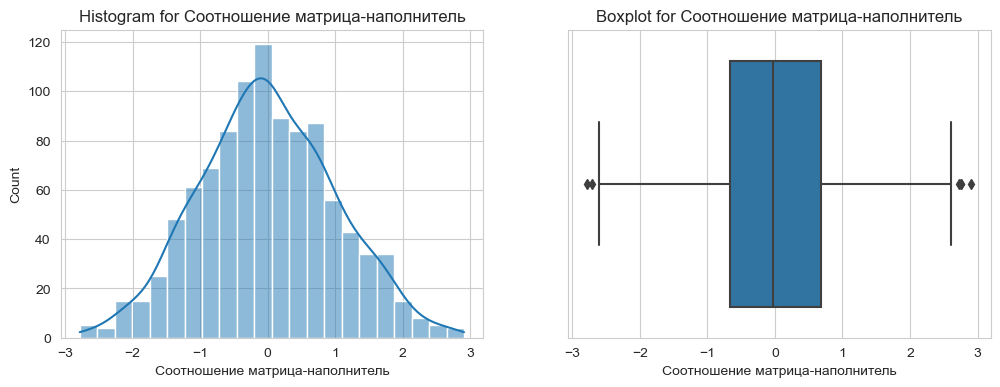

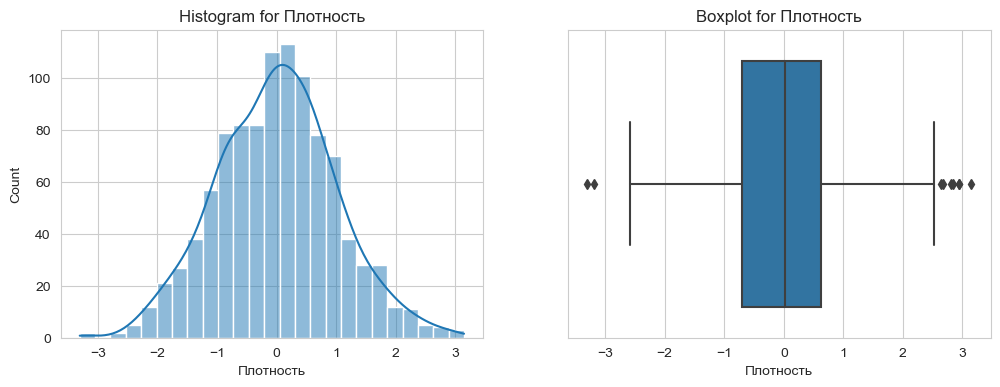

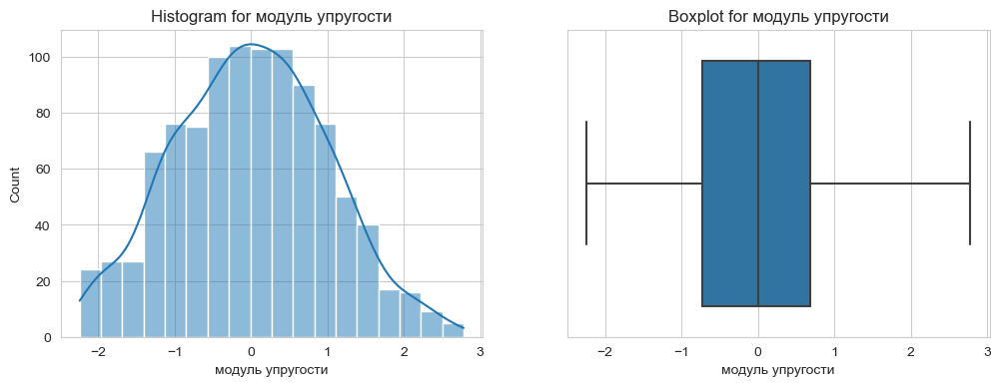

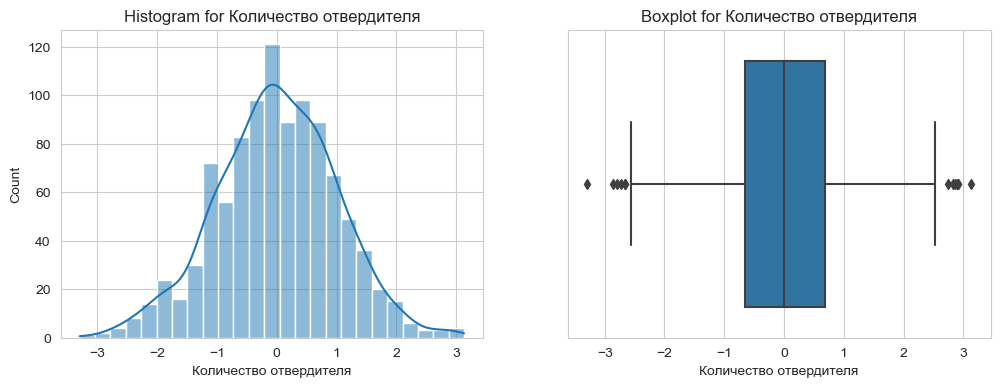

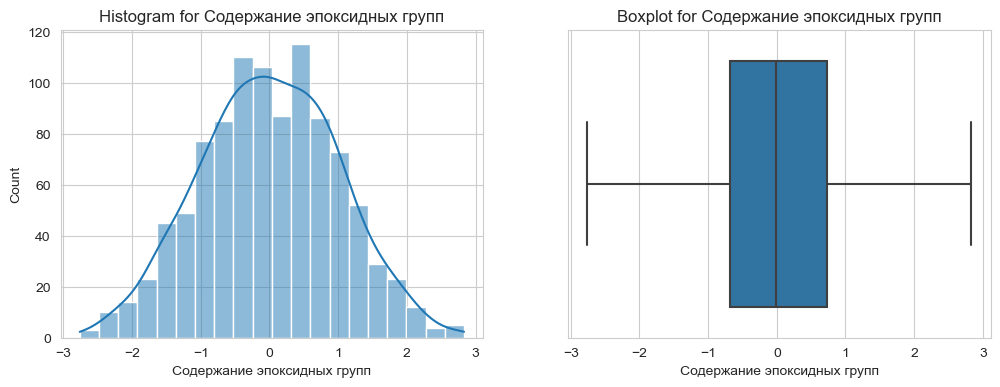

...

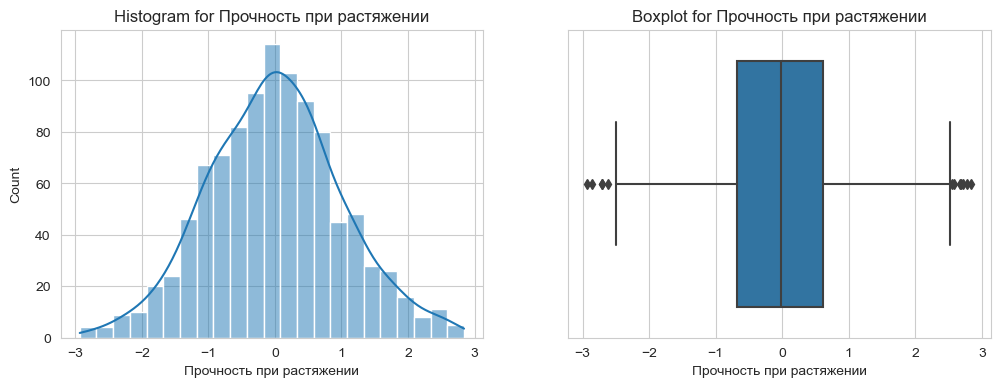

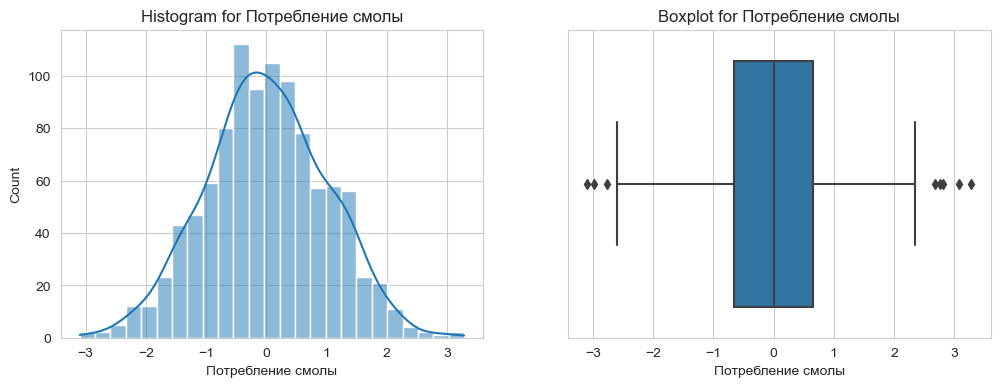

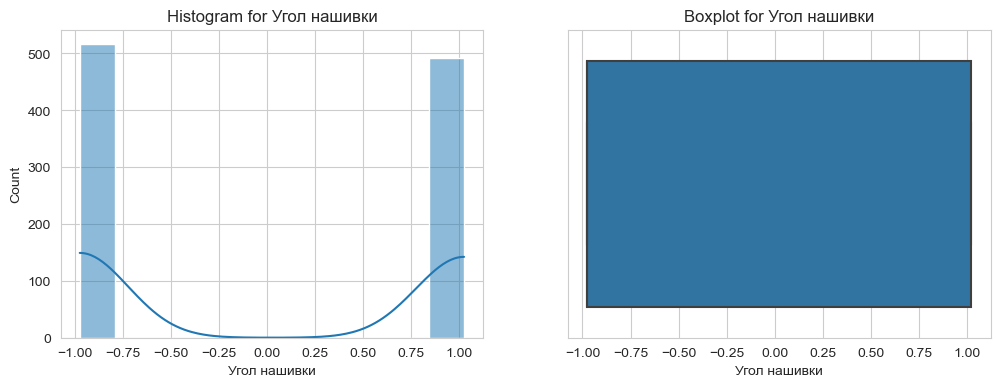

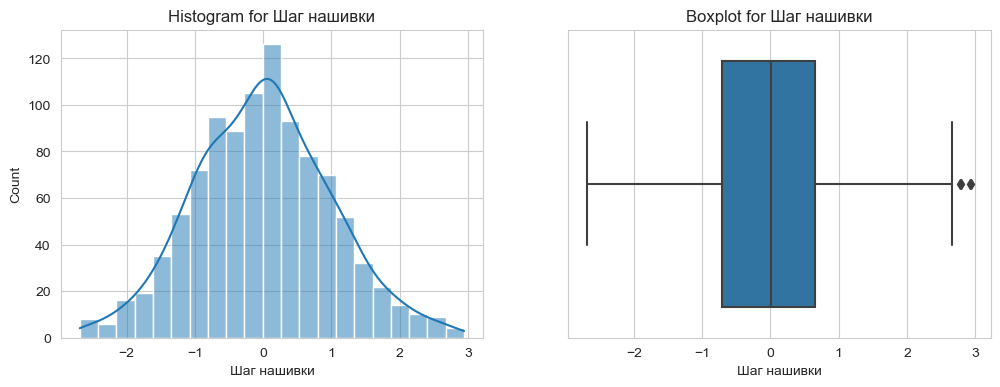

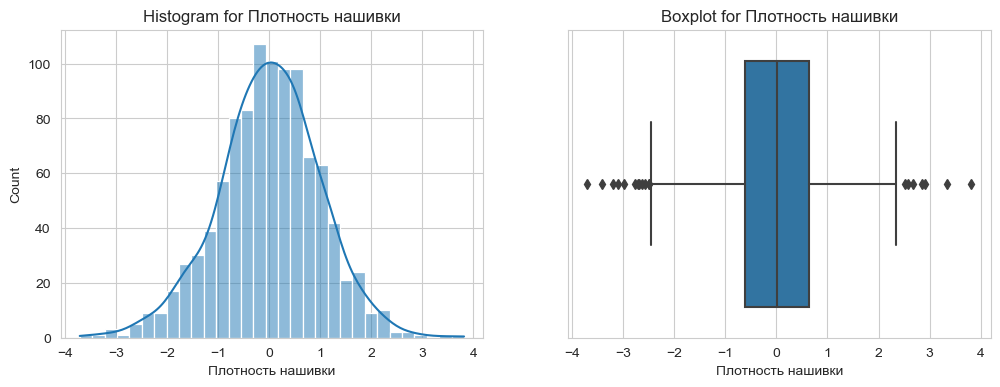

In [41]:
# гистограммы и диаграммы ящика с усами распределения каждой из переменной 
numerical_columns = df_scaler1.columns.tolist()

for col in numerical_columns:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
    sns.histplot(df_scaler1[col], ax=ax1, kde=True)
    ax1.set_title(f'Histogram for {col}')
    sns.boxplot(x=df_scaler1[col], ax=ax2)
    ax2.set_title(f'Boxplot for {col}')
    plt.show()

# Шаг 5:   Предобработка (фильтрация датасета до 40 строк)
- После построения моделей (Шаг 4) выяснилось, что модели обладают плохой предсказательной способностью и показатель R2 имеет отрицательное значение. Выяснилось, что R2 улучшается, если отфильтровать данные по значению колонки "Угла нашивки". Предполагаю, что дело не в реализации моделей, а в данных.
- Если внимательно посмотреть на данные датасета из колонок "Шаг нашивки" и "Плотность нашивки" и учитывая результат обучения моделей на отдельных датасетах с Углом нашивки = 0 и с Углом нашивки = 90, то правильные значения расположены  в записях, где "Шфг нашивки" и "Плотность нашивки" представлены целыми значениями. Это можно подтвердить применив формулу Плотность (стежков/дм²) = 10000 / (Шаг_в_ряду [мм] * Расстояние_между_рядами [мм]) . При этом, при подстановке в формулу выше значений "Шаг нашивки" и "Плотность нашивки", представленных целыми значениями (40 начальных строк в файле X_nup.xlsx) будут согласованными между собой (т.е. изменение расстояния между рядами будет приводить к соответствующему изменению плотности). В остальных строках эта согласованность не наблюдается. Cтрока с нулевыми значениями является контрольным вариантом материала без нашивки.
Поэтому, для дальнейшего исследования отбираем только строки датасета, соответствующие строкам с начальными индексами от 0 до 39 включительно.
- Изучение материалов о композитах показывает, что температура вспышки относится к параметрам безопасности и не определяет механические свойства композита. Поэтому, я исключаю из датасета колонку "температура вспышки".   

In [11]:
df_ML = df_in_idx.copy()
df_ML = df_ML.drop(df_ML[df_ML['Unnamed: 0'] > 39].index)
df_ML.drop(['Unnamed: 0'],axis=1,inplace=True)              # Удаление столбца с индексом из результирующего DataFrame
df_ML.loc[df_in_idx['Угол нашивки'] == 90, 'Угол нашивки'] = 1
df_ML = df_ML.drop(df_ML[df_ML['Шаг нашивки'] == 0].index)  # Удаляем строку с 0-ыми исходными данными

# Удаляю колонки
df_ML.drop(['Температура вспышки'],axis=1,inplace=True) 
#df_ML.drop(['Плотность'],axis=1,inplace=True)
#df_ML.drop(['Содержание эпоксидных групп'],axis=1,inplace=True)

# Создаю два новых признака отталкиваясь от физической сути
#df_ML['Шаг Плотность нашивки'] = (df_ML['Шаг нашивки'] * df_ML['Плотность нашивки']).replace(0, 0.001)
#df_ML['Плотность относительная'] = df_ML['Поверхностная плотность'] / df_ML['Шаг Плотность нашивки']
#df_ML['теоретическая_жесткость'] = df_ML['Соотношение матрица-наполнитель'] * df_ML['модуль упругости']

#df_ML.drop(['Плотность нашивки'],axis=1,inplace=True)
#df_ML.drop([0,1,2,11,26,27,32,36,37,39], inplace=True)
#df_ML.drop([37], inplace=True)

df_NNW = df_ML.copy()
#df_NNW.drop(['модуль упругости','Количество отвердителя','Содержание эпоксидных групп','Поверхностная плотность','Потребление смолы'],axis=1,inplace=True) 


In [12]:
# Функция удаления всех выбросов с возможностью указания колонки
#df_ML = remove_outliers_iqr(df_ML)

## Проверка важности признаков
Проверяю, что можно удалить колонку "Температура вспышки"

Быстрый SHAP анализ:


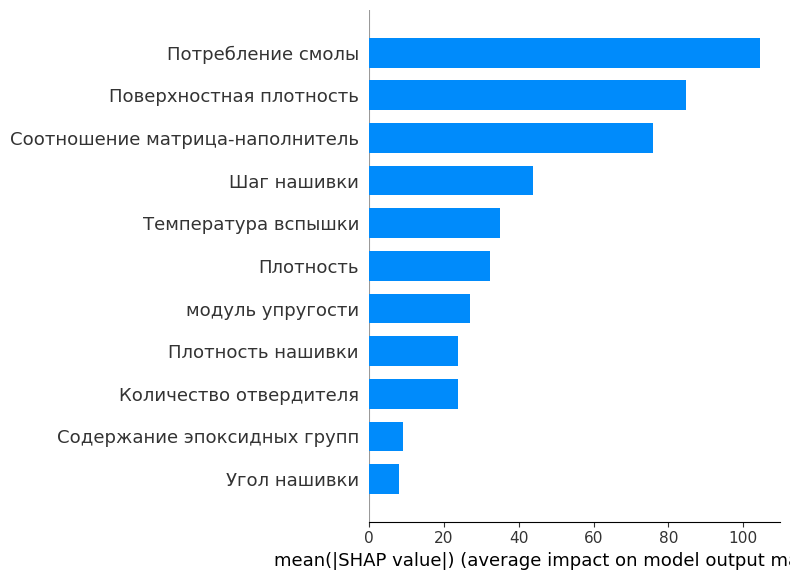

In [14]:
df_ML_exp = df_in_idx.copy()
df_ML_exp = df_ML_exp.drop(df_ML_exp[df_ML_exp['Unnamed: 0'] > 39].index)
df_ML_exp.drop(['Unnamed: 0'],axis=1,inplace=True)   
#df_ML_exp = df_ML.copy()
df_ML_exp.drop(['Модуль упругости при растяжении'],axis=1,inplace=True)
str_y = 'Прочность при растяжении'
quick_shap_analysis(df_ML_exp, str_y)
#detailed_shap_analysis(df_ML_exp, str_y)

Быстрый SHAP анализ:


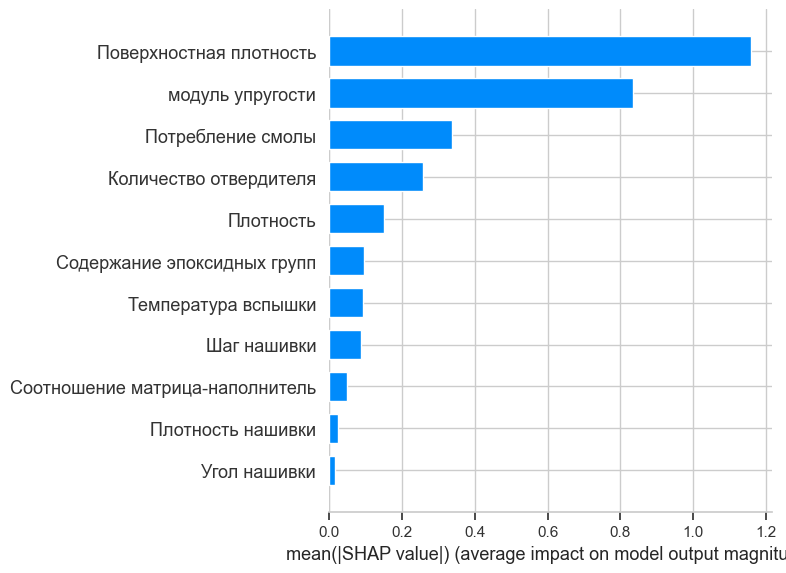

In [168]:

df_ML_exp = df_in_idx.copy()
df_ML_exp = df_ML_exp.drop(df_ML_exp[df_ML_exp['Unnamed: 0'] > 39].index)
df_ML_exp.drop(['Unnamed: 0'],axis=1,inplace=True) 
df_ML_exp.drop(['Прочность при растяжении'],axis=1,inplace=True)
str_y = 'Модуль упругости при растяжении'
quick_shap_analysis(df_ML_exp, str_y)

Вывод: Температура вспышки имеет не высокую значимость и ,поэтому, (и т.к., предполагается, что она не определяет механические свойства) я ее удаляю из датасета.

# Шаг 6:   Анализ данных (на отфильтрованном датасете 40 строк)

## Кластерный анализ
Из кластерного анализа яснее не стало. При делении на 2 или 3 кластера с колонкой "Угол нашивки" или без нее выявляется преобладающий класс из 23 элементов, но его состав сильно меняется при разных вариантах количества кластеров + угол нашивки. Поэтому, пока, принимаю решение, что все 40 записей будут участвовать в построении моделей.

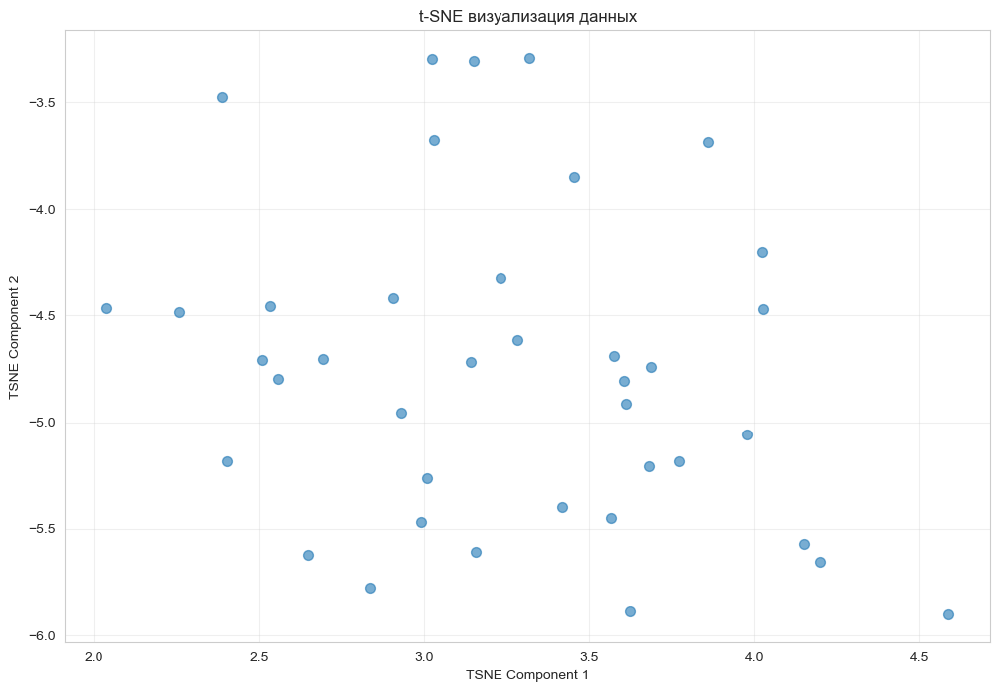

In [45]:
df_cluster = df_ML.copy()
df_cluster = df_cluster.drop(['Угол нашивки'],axis=1)
t_sne(df_cluster,2)

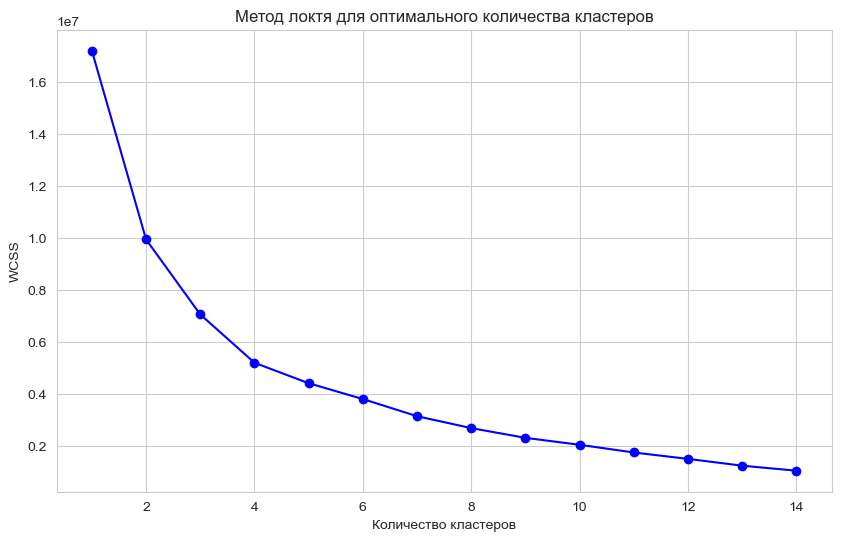

In [46]:
wcss(df_ML)

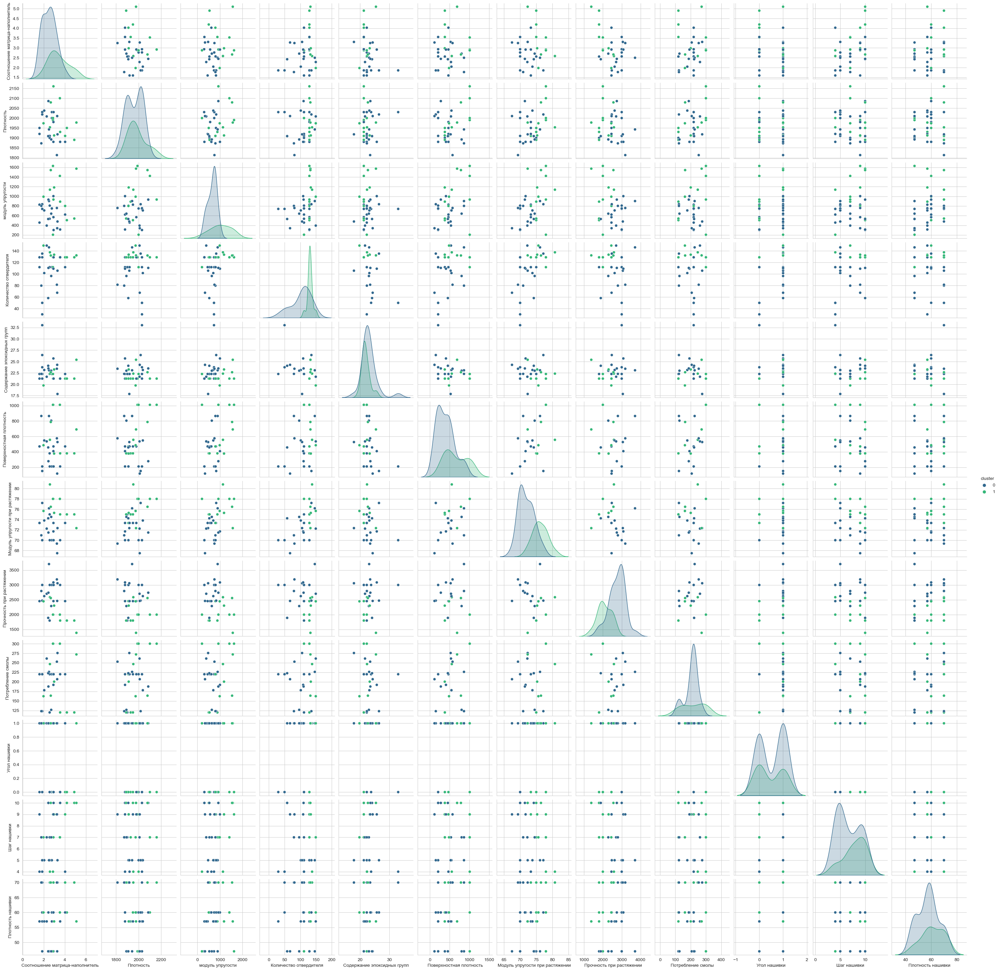

Размеры кластеров:
0    26
1    13
Name: cluster, dtype: int64
Самый большой кластер № 0: 26

Центры кластеров:
         0         1         2         3         4         5         6   \
0 -0.349016 -0.115782 -0.359004 -0.320810  0.159786 -0.333063 -0.470012   
1  0.698032  0.231564  0.718008  0.641621 -0.319571  0.666126  0.940024   

         7         8         9         10        11  
0  0.446830 -0.071310  0.051299 -0.187403 -0.145742  
1 -0.893659  0.142619 -0.102598  0.374806  0.291484  


In [47]:
df_cmeans = df_ML.copy()
#df_cmeans = df_cmeans.drop(['Угол нашивки'],axis=1)
df_cluster = get_Cluster_KMeans(df_cmeans, claster_num = 2)

In [48]:
df1 = df_cluster[df_cluster['cluster'] == 1]
df1

,Соотношение матрица-наполнитель,Плотность,модуль упругости,Количество отвердителя,Содержание эпоксидных групп,Поверхностная плотность,Модуль упругости при растяжении,Прочность при растяжении,Потребление смолы,Угол нашивки,Шаг нашивки,Плотность нашивки,cluster
8,3.557018,1930.000000,889.000000,129.000000,21.250000,380.000000,75.000000,1800.000000,120.000000,0,7.0,57.0,1
9,3.532338,2100.000000,1421.000000,129.000000,21.250000,1010.000000,78.000000,2000.000000,300.000000,0,7.0,60.0,1
10,2.919678,2160.000000,933.000000,129.000000,21.250000,1010.000000,78.000000,2000.000000,300.000000,0,7.0,70.0,1
11,2.877358,1990.000000,1628.000000,129.000000,21.250000,1010.000000,78.000000,2000.000000,300.000000,0,9.0,47.0,1
14,4.029126,1910.000000,800.000000,129.000000,21.250000,470.000000,73.333333,2455.555556,220.000000,0,9.0,70.0,1
17,4.193548,1950.000000,506.000000,129.000000,21.250000,380.000000,75.000000,1800.000000,120.000000,0,10.0,60.0,1
18,4.897959,1890.000000,540.000000,129.000000,21.250000,380.000000,75.000000,1800.000000,120.000000,0,10.0,70.0,1
20,2.877358,2000.000000,205.000000,111.860000,22.267857,1010.000000,78.000000,2000.000000,300.000000,1,4.0,47.0,1
23,2.587348,1953.274926,1136.596135,137.627420,22.344534,555.893453,80.803222,2587.342983,246.613117,1,4.0,70.0,1
30,1.978140,1973.629097,991.724095,149.372128,19.750578,485.453778,75.665701,2448.943079,162.493694,1,7.0,60.0,1


## Выявление выбросов, аномалий 
- Выбросы определяю по методу межквантильного размаха. Однако, точно понять, что это выброс , а не реальное значение не удается. 
- пробовал удалять отдельные предположительно выбросы и строить модели. R2 уходил в минус. Значит отбрасывать эти значения нельзя. Оставляю.
- На Boxplot наблюдаются хвосты, некоторые распределения сдвинуты. Похоже, что нужно еще фильтровать данные.
- в большинстве колонок распределение близко к нормальному.

In [49]:
# Смотрим количество выбросов по колонкам
numerical_columns = df_ML.columns.tolist()

Q1 = df_ML[numerical_columns].quantile(0.25)
Q3 = df_ML[numerical_columns].quantile(0.75)
IQR = Q3 - Q1

outliers = ((df_ML[numerical_columns] < (Q1 - 1.5 * IQR)) | (df_ML[numerical_columns] > (Q3 + 1.5 * IQR)))
print("Количество выбросов по каждому признаку:")
print(outliers.sum())

Количество выбросов по каждому признаку:
Соотношение матрица-наполнитель    1
Плотность                          0
модуль упругости                   3
Количество отвердителя             5
Содержание эпоксидных групп        3
Поверхностная плотность            0
Модуль упругости при растяжении    0
Прочность при растяжении           0
Потребление смолы                  8
Угол нашивки                       0
Шаг нашивки                        0
Плотность нашивки                  0
dtype: int64


In [50]:
outliers_df = find_outliers_iqr(df_ML,'Прочность при растяжении')
print("Строки с выбросами:")
outliers_df

Анализ выбросов для колонки 'Прочность при растяжении':
Q1 (25-й перцентиль): 2144.48
Q3 (75-й перцентиль): 3000.00
IQR: 855.52
Нижняя граница: 861.21
Верхняя граница: 4283.27
Найдено выбросов: 0
--------------------------------------------------
Строки с выбросами:


,Соотношение матрица-наполнитель,Плотность,модуль упругости,Количество отвердителя,Содержание эпоксидных групп,Поверхностная плотность,Модуль упругости при растяжении,Прочность при растяжении,Потребление смолы,Угол нашивки,Шаг нашивки,Плотность нашивки


In [51]:
outliers_df = find_outliers_iqr(df_ML,'Соотношение матрица-наполнитель')
print("Строки с выбросами:")
outliers_df

Анализ выбросов для колонки 'Соотношение матрица-наполнитель':
Q1 (25-й перцентиль): 2.16
Q3 (75-й перцентиль): 3.26
IQR: 1.10
Нижняя граница: 0.52
Верхняя граница: 4.91
Найдено выбросов: 1
--------------------------------------------------
Строки с выбросами:


,Соотношение матрица-наполнитель,Плотность,модуль упругости,Количество отвердителя,Содержание эпоксидных групп,Поверхностная плотность,Модуль упругости при растяжении,Прочность при растяжении,Потребление смолы,Угол нашивки,Шаг нашивки,Плотность нашивки
37,5.098993,1977.339047,1572.096042,132.34306,25.397001,690.364836,72.34164,1386.578973,271.901394,1,10.0,57.0


In [52]:
# Удаление выбросов (Значения сильно выходят за границы "Усов" Boxplot)
df_ML = remove_outliers_iqr(df_ML, ['Соотношение матрица-наполнитель'])
#df_ML.drop(df_ML[df_ML['Соотношение матрица-наполнитель'] == '5.098993'].index, inplace=True)

In [53]:
outliers_df = find_outliers_iqr(df_ML,'модуль упругости')
print("Строки с выбросами:")
outliers_df

Анализ выбросов для колонки 'модуль упругости':
Q1 (25-й перцентиль): 535.00
Q3 (75-й перцентиль): 889.00
IQR: 354.00
Нижняя граница: 4.00
Верхняя граница: 1420.00
Найдено выбросов: 2
--------------------------------------------------
Строки с выбросами:


,Соотношение матрица-наполнитель,Плотность,модуль упругости,Количество отвердителя,Содержание эпоксидных групп,Поверхностная плотность,Модуль упругости при растяжении,Прочность при растяжении,Потребление смолы,Угол нашивки,Шаг нашивки,Плотность нашивки
9,3.532338,2100.0,1421.0,129.0,21.25,1010.0,78.0,2000.0,300.0,0,7.0,60.0
11,2.877358,1990.0,1628.0,129.0,21.25,1010.0,78.0,2000.0,300.0,0,9.0,47.0


In [ ]:
# Удаление выбросов (Значения сильно выходят за границы "Усов" Boxplot)
#df_ML = remove_outliers_iqr(df_ML, ['модуль упругости'])

In [54]:
outliers_df = find_outliers_iqr(df_ML,'Количество отвердителя')
print("Строки с выбросами:")
outliers_df

Анализ выбросов для колонки 'Количество отвердителя':
Q1 (25-й перцентиль): 105.79
Q3 (75-й перцентиль): 129.00
IQR: 23.21
Нижняя граница: 70.97
Верхняя граница: 163.82
Найдено выбросов: 5
--------------------------------------------------
Строки с выбросами:


,Соотношение матрица-наполнитель,Плотность,модуль упругости,Количество отвердителя,Содержание эпоксидных групп,Поверхностная плотность,Модуль упругости при растяжении,Прочность при растяжении,Потребление смолы,Угол нашивки,Шаг нашивки,Плотность нашивки
0,1.857143,2030.000000,738.736842,30.000000,22.267857,210.000000,70.000000,3000.000000,220.000000,0,4.0,57.0
1,1.857143,2030.000000,738.736842,50.000000,23.750000,210.000000,70.000000,3000.000000,220.000000,0,4.0,60.0
2,1.857143,2030.000000,738.736842,49.900000,33.000000,210.000000,70.000000,3000.000000,220.000000,0,4.0,70.0
32,3.277087,2010.047012,339.550423,67.498993,24.280609,117.535234,67.478707,2462.605386,207.018581,1,9.0,47.0
36,2.423876,1908.940601,530.228686,58.262414,24.073549,456.908047,74.244354,1890.505807,222.699487,1,10.0,47.0


In [ ]:
#df_ML.drop([32, 36], inplace=True)

In [55]:
outliers_df = find_outliers_iqr(df_ML,'Содержание эпоксидных групп')
print("Строки с выбросами:")
outliers_df

Анализ выбросов для колонки 'Содержание эпоксидных групп':
Q1 (25-й перцентиль): 21.25
Q3 (75-й перцентиль): 23.15
IQR: 1.90
Нижняя граница: 18.41
Верхняя граница: 25.99
Найдено выбросов: 3
--------------------------------------------------
Строки с выбросами:


,Соотношение матрица-наполнитель,Плотность,модуль упругости,Количество отвердителя,Содержание эпоксидных групп,Поверхностная плотность,Модуль упругости при растяжении,Прочность при растяжении,Потребление смолы,Угол нашивки,Шаг нашивки,Плотность нашивки
2,1.857143,2030.000000,738.736842,49.900000,33.000000,210.000000,70.000000,3000.000000,220.000000,0,4.0,70.0
26,1.856476,2018.220332,836.294382,135.401697,26.435515,150.961449,77.210762,2473.187195,123.344561,1,5.0,60.0
27,3.305535,1917.907506,478.286247,105.786930,17.874100,526.692159,72.345709,3059.032991,275.575880,1,5.0,70.0


In [ ]:
#df_ML.drop([26, 27], inplace=True)

In [56]:
outliers_dfoutliers_df = find_outliers_iqr(df_ML,'Потребление смолы')
print("Строки с выбросами:")
outliers_df

Анализ выбросов для колонки 'Потребление смолы':
Q1 (25-й перцентиль): 187.86
Q3 (75-й перцентиль): 222.70
IQR: 34.84
Нижняя граница: 135.60
Верхняя граница: 274.96
Найдено выбросов: 12
--------------------------------------------------
Строки с выбросами:


,Соотношение матрица-наполнитель,Плотность,модуль упругости,Количество отвердителя,Содержание эпоксидных групп,Поверхностная плотность,Модуль упругости при растяжении,Прочность при растяжении,Потребление смолы,Угол нашивки,Шаг нашивки,Плотность нашивки
2,1.857143,2030.000000,738.736842,49.900000,33.000000,210.000000,70.000000,3000.000000,220.000000,0,4.0,70.0
26,1.856476,2018.220332,836.294382,135.401697,26.435515,150.961449,77.210762,2473.187195,123.344561,1,5.0,60.0
27,3.305535,1917.907506,478.286247,105.786930,17.874100,526.692159,72.345709,3059.032991,275.575880,1,5.0,70.0


In [ ]:
#df_ML.drop([28, 31], inplace=True)

In [57]:
# Смотрим количество выбросов по колонкам
numerical_columns = df_ML.columns.tolist()

Q1 = df_ML[numerical_columns].quantile(0.25)
Q3 = df_ML[numerical_columns].quantile(0.75)
IQR = Q3 - Q1

outliers = ((df_ML[numerical_columns] < (Q1 - 1.5 * IQR)) | (df_ML[numerical_columns] > (Q3 + 1.5 * IQR)))
print("Количество выбросов по каждому признаку:")
print(outliers.sum())

Количество выбросов по каждому признаку:
Соотношение матрица-наполнитель     0
Плотность                           0
модуль упругости                    2
Количество отвердителя              5
Содержание эпоксидных групп         3
Поверхностная плотность             0
Модуль упругости при растяжении     0
Прочность при растяжении            0
Потребление смолы                  12
Угол нашивки                        0
Шаг нашивки                         0
Плотность нашивки                  18
dtype: int64


In [170]:
df_ML.describe().T.round(2) # описательная статистик

,count,mean,std,min,25%,50%,75%,max
Соотношение матрица-наполнитель,39.0,2.81,0.85,1.60,2.16,2.77,3.26,5.10
модуль упругости,39.0,783.48,343.24,205.00,537.50,748.00,916.42,1628.00
Количество отвердителя,39.0,112.50,28.83,30.00,107.51,129.00,129.00,149.37
Содержание эпоксидных групп,39.0,22.61,2.31,17.87,21.25,22.27,23.21,33.00
Поверхностная плотность,39.0,482.75,265.63,117.54,210.00,470.00,565.48,1010.00
Модуль упругости при растяжении,39.0,73.35,3.09,67.48,70.00,73.33,75.15,80.80
Прочность при растяжении,39.0,2532.93,504.57,1386.58,2144.48,2473.19,3000.00,3705.67
Потребление смолы,39.0,209.81,53.50,120.00,183.03,220.00,224.46,300.00
Угол нашивки,39.0,0.51,0.51,0.00,0.00,1.00,1.00,1.00
Шаг нашивки,39.0,7.08,2.29,4.00,5.00,7.00,9.00,10.00


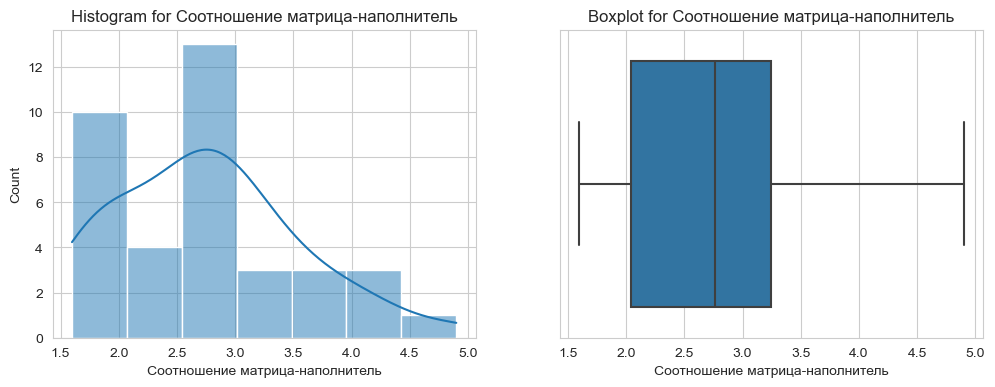

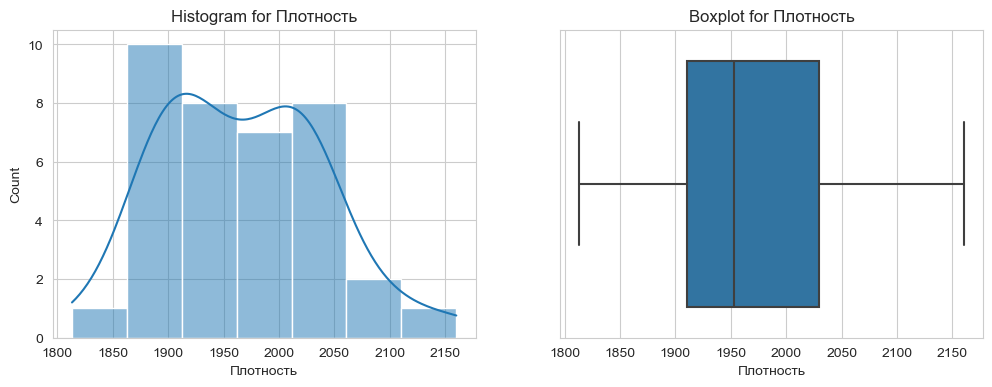

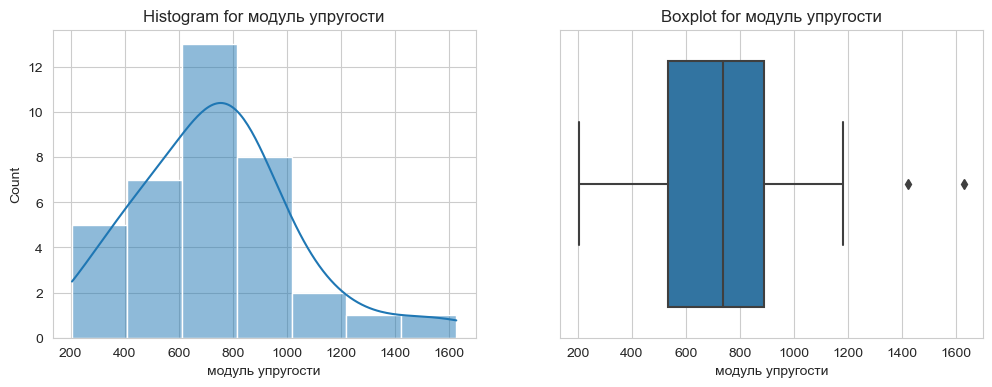

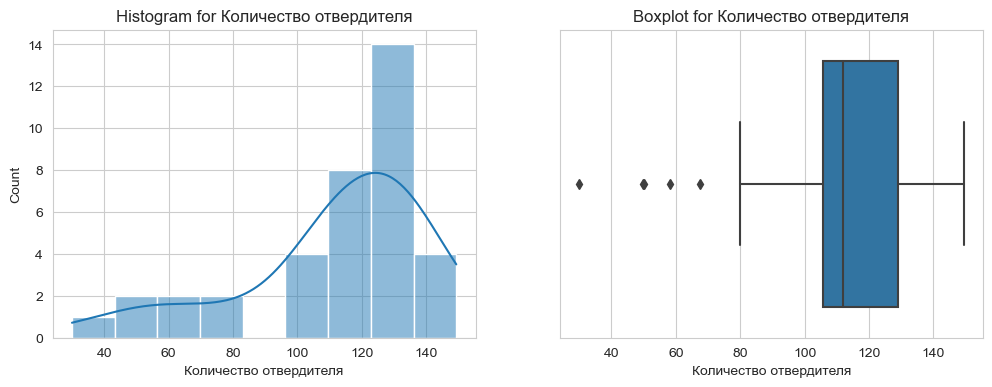

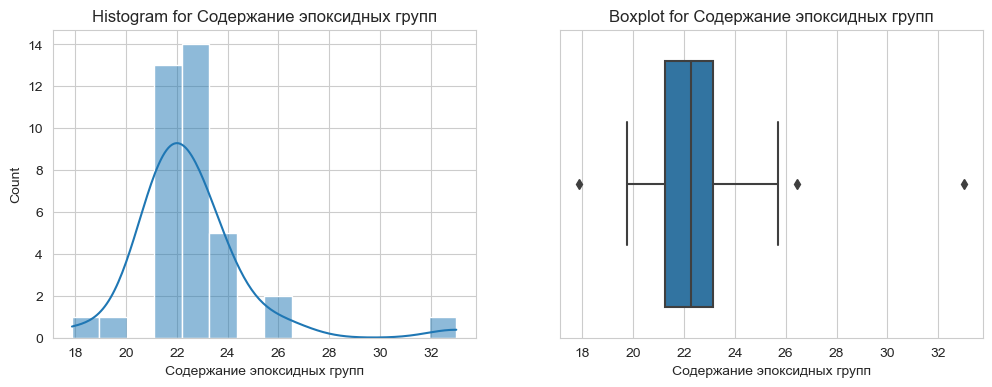

...

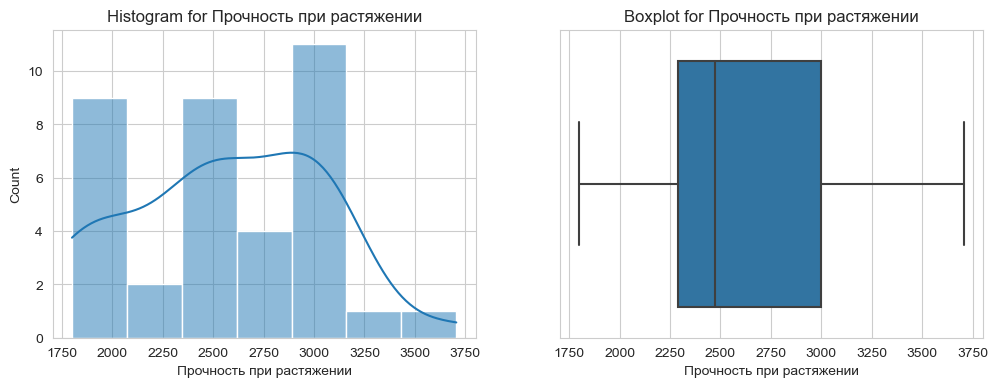

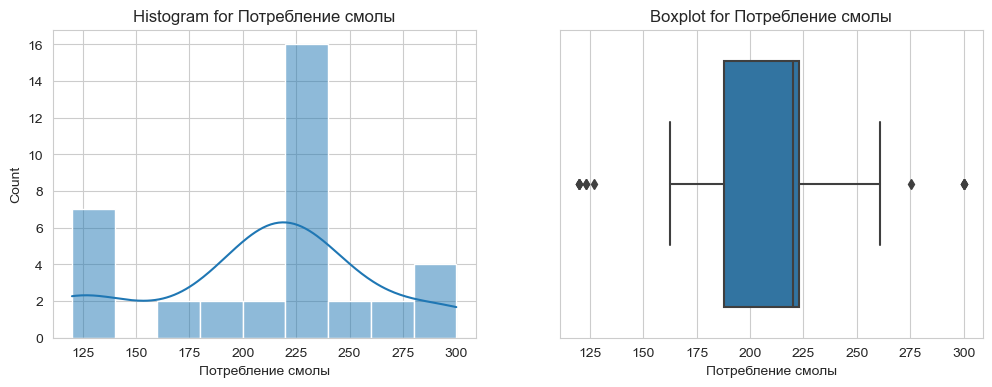

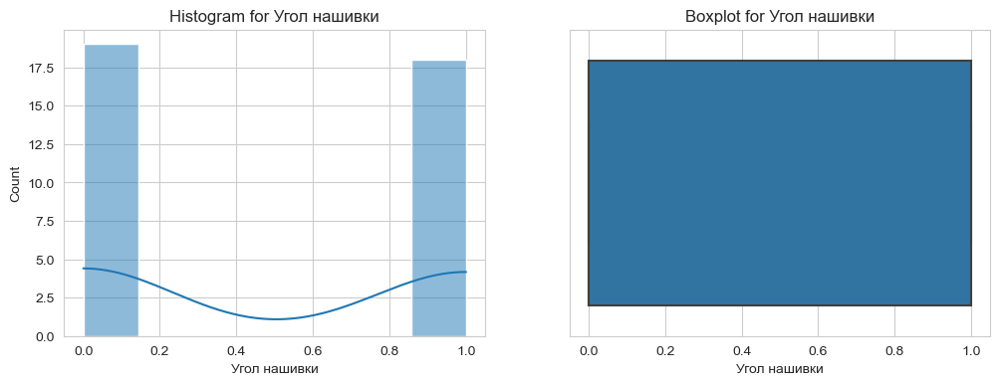

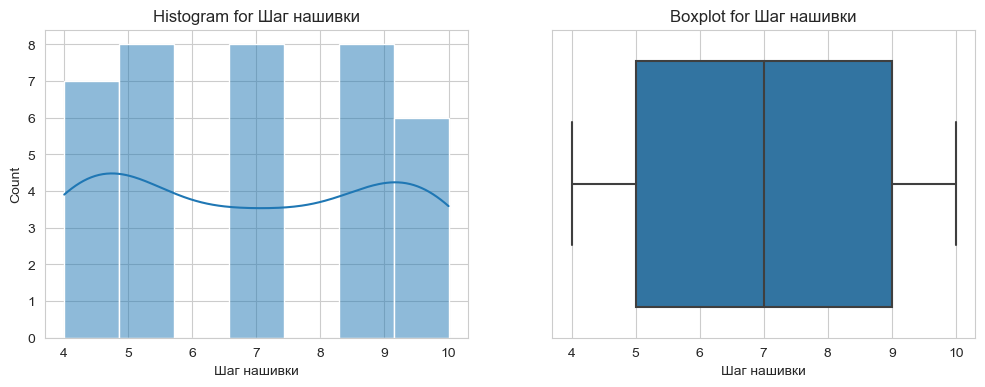

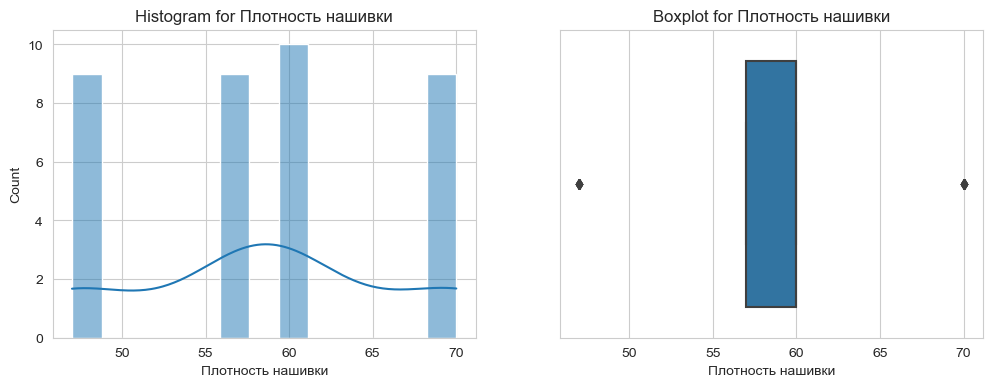

In [58]:
# гистограммы и диаграммы ящика с усами распределения каждой из переменной 
numerical_columns = df_ML.columns.tolist()

for col in numerical_columns:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
    sns.histplot(df_ML[col], ax=ax1, kde=True)
    ax1.set_title(f'Histogram for {col}')
    sns.boxplot(x=df_ML[col], ax=ax2)
    ax2.set_title(f'Boxplot for {col}')
    plt.show()

In [59]:
# Тест на проверку нормальности распределения
numerical_columns = df_in.columns.tolist()

for col in numerical_columns:
    print(f'{col}: {normaltest(df_in[col])}')

Соотношение матрица-наполнитель: NormaltestResult(statistic=2.9335080807509657, pvalue=0.23067302661657985)
Плотность: NormaltestResult(statistic=0.8722839577051198, pvalue=0.6465259264096164)
модуль упругости: NormaltestResult(statistic=8.888317083461528, pvalue=0.011746986472275647)
Количество отвердителя: NormaltestResult(statistic=1.560220539668732, pvalue=0.4583554657371618)
Содержание эпоксидных групп: NormaltestResult(statistic=5.518545576641101, pvalue=0.06333781161237134)
Температура вспышки: NormaltestResult(statistic=0.8278854898750605, pvalue=0.661038798000118)
Поверхностная плотность: NormaltestResult(statistic=38.035157298893274, pvalue=5.50516744992152e-09)
Модуль упругости при растяжении: NormaltestResult(statistic=3.886271069686967, pvalue=0.14325406671662383)
Прочность при растяжении: NormaltestResult(statistic=1.3157712584258652, pvalue=0.5179453059777257)
Потребление смолы: NormaltestResult(statistic=0.5676515626576653, pvalue=0.7528978021354408)
Угол нашивки: Norma

## Линейная корреляция
- Для целевой переменной "Модуль упругости при растяжении" самым прогностическим признаком является "Поверхностная плотность", умеренное влияние оказывает "Количество отвердителя и модуль упругости"
- Целевая переменная "Плотность при растяжении" имеет наибольшую положительную связь с признаком "Содержание эпоксидных групп" и наибольшую отрицательную связь с признаком "Соотношение матрица-наполнитель". Также, на "Плотность при растяжении" оказывает слабую отрицательную связь признак "Поверхностная плотность".
- Целевая переменная "Соотношение матрица-наполнитель" имеет наибольшую положительную связь с признаком "Шаг нашивки" и наибольшую отрицательную связь с признаком "Угол нашивки". Также, на "Соотношение матрица-наполнитель" оказывает слабую отрицательную связь признак "Плотность" и слабую положительную связь признак "Плотность нашивки".
- Наличие корреляций между самими признаками (например, "Плотность" и "Количество отвердителя" = 0.33) может указывать на мультиколлинеарность

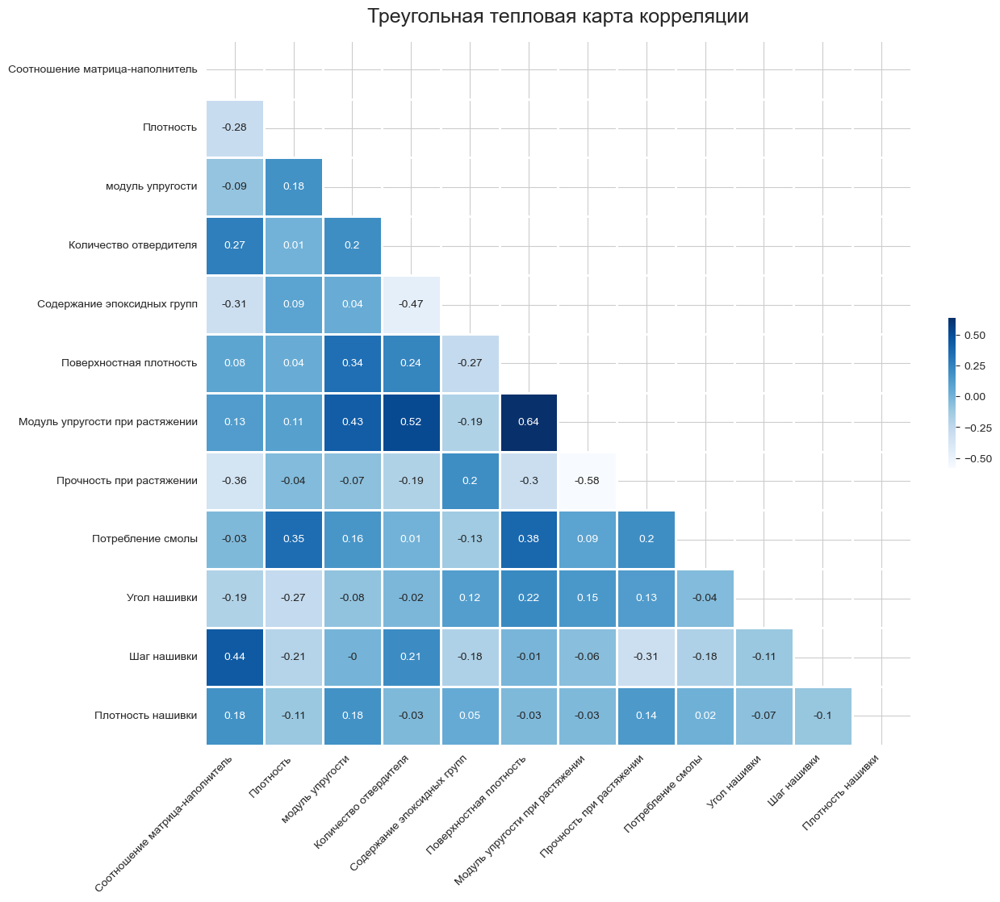

In [60]:
plt.rcParams["figure.figsize"] = (12,12)
#sns.heatmap(df.corr(), annot=True, fmt='0.2f')  
sns.set_style("whitegrid")

# Воспользуемся функциями np.triu, чтобы изолировать верхний треугольник (np.tril нижний)
# функция np.ones_like() изменит все изолированные значения на 1.
mask = np.triu(np.ones_like(df_ML.corr(), dtype=bool))

heatmap = sns.heatmap(
    df_ML.corr().round(2),
    annot=True,
    square=True,
    cmap="Blues",
    cbar_kws={"fraction": 0.01},
    linewidth=2,
    
    mask=mask,
)

heatmap.set_title(
    "Треугольная тепловая карта корреляции", fontdict={"fontsize": 18}, pad=16
);

heatmap.set_xticklabels(
    heatmap.get_xticklabels(), rotation=45, horizontalalignment="right"
);

In [ ]:
# Парные графики
numerical_columns = df_ML.columns.tolist()
#numerical_columns.remove('Угол нашивки')
sns.pairplot(df_ML[numerical_columns])
plt.suptitle('Парные графики для числовых переменных', y=1.02)
plt.show()

# Шаг 4, 7: Построение моделей ML
Здесь 
- на 4 шаге я пытался построить модели и обучил их на полной выборке 1023 строки. Потерпел неудачу (R2 отрицательный). Вернулся к предобработке (шаг 5), где оставил , только первые 40 строк, а остальные удалил из датасета.
- на шаге 7 я уже построенные модели обучил на отфильтрованной выборке из 40 строк (минус строка с нулевыми значениями нашивки). Лучшие результаты ожидаемо показала модель с градиентным бустингом (но настраивать ее - это "квест").


In [63]:
from sklearn.model_selection import train_test_split, KFold, RepeatedKFold, ShuffleSplit, GridSearchCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, PolynomialFeatures
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import LassoCV, RidgeCV, ElasticNetCV, Ridge, Lasso
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR
from sklearn.datasets import make_regression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error, mean_squared_error 
from sklearn.utils import shuffle
from sklearn.pipeline import Pipeline

Я использую следующие модели:
- Модели с линейной регрессией Lasso и Ridge. Простенькие быстрые линейные модели с разными типами регуляризации. С помощью модели Lasso можно выявить значимые признаки.
- KNN использую, как простенькую и быструю модель, которая имеет отличный от предидущих принцип и может предсказывать нелинейные зависимостями.
- SVR с RBF и Poly нелинейными ядрами использую, т.к. предполагаю, что здесь нелинейные зависимости между признаками и таргетом.
- GradientBoostingRegressor использую, как мощный бустинговый алгоритм с хорошими перспективами. 
- GradientBoostingRegressor с PCA сделал как вариант, совмещения мощного бустингового алгоритма с возможностью уменьшения признакового пространства (был низкий R2 и было предположение, что много признаков для такого набора данных).
- RandomForestRegressor ,также, использую, как проходную выигрышную ансамблевую модель, но с беггингом в отличии от  GradientBoostingRegressor.

Примечание:
- Использую StandardScaller, т.к. большинство колонок имеют распределение близкое к нормальному. А также, StandardScaller лучше работает с выбросами.
- Использую Pipline. StandardScaller, также, помещаю в Pipeline.
- PCA, также, помещаю в Pipline и, обязательно, после StandardScaller. 
- Использую GridSearh для подбора лучших параметров;

## Вспомогательные функции

In [61]:
# Функция визуализации результата обучения модели
def plotResult(prm_y_test, prm_y_pred):    

    # Создание DataFrame для визуализации
    results_df = pd.DataFrame({
        'Реальные значения': prm_y_test,
        'Предсказания': prm_y_pred
    })

    
    # Настройка стиля Seaborn
    sns.set(style="whitegrid")
    plt.figure(figsize=(12, 8))

    # График 1: Scatter plot сравнения реальных и предсказанных значений
    plt.subplot(2, 2, 1)
    sns.scatterplot(data=results_df, x='Реальные значения', y='Предсказания', alpha=0.6)
    plt.plot([prm_y_test.min(), prm_y_test.max()], [prm_y_test.min(), prm_y_test.max()], 'r--', lw=2)
    plt.title('Сравнение реальных и предсказанных значений')
    plt.xlabel('Реальные значения')
    plt.ylabel('Предсказания')

    # График 2: Распределение ошибок
    plt.subplot(2, 2, 2)
    errors = prm_y_test - prm_y_pred
    sns.histplot(errors, kde=True, bins=30)
    plt.title('Распределение ошибок предсказания')
    plt.xlabel('Ошибка')
    plt.ylabel('Частота')

    # График 3: Линейный график сравнения (первые 50 образцов)
    plt.subplot(2, 2, 3)
    sample_indices = np.arange(min(50, len(prm_y_test)))
    plt.plot(sample_indices, prm_y_test[:50], 'o-', label='Реальные значения', alpha=0.7)
    plt.plot(sample_indices, prm_y_pred[:50], 's-', label='Предсказания', alpha=0.7)
    plt.title('Сравнение по образцам (первые 50)')
    plt.xlabel('Образец')
    plt.ylabel('Значение')
    plt.legend()

    # График 4: Residual plot
    plt.subplot(2, 2, 4)
    sns.residplot(x=prm_y_pred, y=prm_y_test, lowess=True, line_kws={'color': 'red'})
    plt.title('Residual Plot')
    plt.xlabel('Предсказанные значения')
    plt.ylabel('Остатки')

    plt.tight_layout()
    plt.show()

    # Дополнительная информация
    print(f"R² score: {r2_score(prm_y_test, prm_y_pred):.4f}")
    print(f"RMSE: {np.sqrt(mean_squared_error(prm_y_test, prm_y_pred)):.4f}")
    # Вычисляем среднюю абсолютную процентную ошибку (MAPE)
    print(f"MAPE: {(np.mean(np.abs((prm_y_test - prm_y_pred) / prm_y_test)) * 100):.4f}")

In [62]:
# Визуализация результатов модели SVR
def plot_results(results, X_test=None, y_test=None):
    
    y_test = results['predictions']['y_test']
    y_pred = results['predictions']['y_pred']
    
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))
    
    # 1. Фактические vs Предсказанные значения
    axes[0, 0].scatter(y_test, y_pred, alpha=0.6)
    axes[0, 0].plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
    axes[0, 0].set_xlabel('Фактические значения')
    axes[0, 0].set_ylabel('Предсказанные значения')
    axes[0, 0].set_title('Фактические vs Предсказанные значения')
    axes[0, 0].grid(True, alpha=0.3)
    
    # 2. Ошибки предсказания
    residuals = y_test - y_pred
    axes[0, 1].scatter(y_pred, residuals, alpha=0.6)
    axes[0, 1].axhline(y=0, color='r', linestyle='--')
    axes[0, 1].set_xlabel('Предсказанные значения')
    axes[0, 1].set_ylabel('Ошибки (Residuals)')
    axes[0, 1].set_title('Анализ остатков')
    axes[0, 1].grid(True, alpha=0.3)
    
    # 3. Распределение ошибок
    axes[1, 0].hist(residuals, bins=30, alpha=0.7, edgecolor='black')
    axes[1, 0].axvline(x=0, color='r', linestyle='--')
    axes[1, 0].set_xlabel('Ошибки')
    axes[1, 0].set_ylabel('Частота')
    axes[1, 0].set_title('Распределение ошибок')
    axes[1, 0].grid(True, alpha=0.3)
    
    # 4. Важность параметров (если доступно)
    try:
        # Для линейного ядра можно получить коэффициенты
        if hasattr(results['best_model'].named_steps['svr'], 'coef_'):
            feature_importance = np.abs(results['best_model'].named_steps['svr'].coef_[0])
            features = range(len(feature_importance))
            axes[1, 1].bar(features, feature_importance)
            axes[1, 1].set_xlabel('Номер признака')
            axes[1, 1].set_ylabel('Важность')
            axes[1, 1].set_title('Важность признаков (только для linear kernel)')
        else:
            axes[1, 1].text(0.5, 0.5, 'Важность признаков\nнедоступна для RBF kernel', 
                           ha='center', va='center', transform=axes[1, 1].transAxes)
            axes[1, 1].set_title('Важность признаков')
    except:
        axes[1, 1].text(0.5, 0.5, 'Важность признаков\nнедоступна', 
                       ha='center', va='center', transform=axes[1, 1].transAxes)
        axes[1, 1].set_title('Важность признаков')
    
    axes[1, 1].grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    # Вывод метрик на графике
    print("\n=== ВИЗУАЛИЗАЦИЯ РЕЗУЛЬТАТОВ ===")
    print(f"R² Score: {results['metrics']['r2']:.4f}")
    print(f"RMSE: {results['metrics']['rmse']:.4f}")
    print(f"MAE: {results['metrics']['mae']:.4f}")

In [ ]:
# Добавление шума (только к признакам и только для Train) 
#def add_noise_to_features(X, noise_level=0.1):    
#    noise = np.random.normal(0, noise_level, X.shape)
#    return X + noise

## Модели

In [64]:
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.neighbors import KNeighborsRegressor

# Функция для прикидочного экспресс-анализа по R2
def express_model_test(prm_df,prm_y):
    
    X = prm_df.drop([prm_y], axis=1)     

    y = prm_df[prm_y] 

    X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.30,random_state=42)

    models = {
    'Random Forest': RandomForestRegressor(n_estimators=100, random_state=42),
    'Gradient Boosting': GradientBoostingRegressor(n_estimators=100, random_state=42),
    'Linear Regression': LinearRegression(),
    'Ridge Regression': Ridge(alpha=1.0),
    'Lasso Regression': Lasso(alpha=1.0),
    'KNN': KNeighborsRegressor(n_neighbors=5)
    }

    # Быстрое сравнение моделей
    for name, model in models.items():
        model.fit(X_train, y_train)
        train_score = model.score(X_train, y_train)
        test_score = model.score(X_test, y_test)
        print(f"{name}: Train R² = {train_score:.3f}, Test R² = {test_score:.3f}")

    #if importance_fuches == True:
    #    model = RandomForestRegressor(n_estimators=100, random_state=42)
    #    model.fit(X_train, y_train)
    #    importance_fuches_SHAP(model,X_train)


In [65]:
# Ridge - модель
def RidgeRegressor(prm_df,prm_y, prm_X = [],plotRes = False, prm_verbos = 0):
    
    if len(prm_X) == 0:
        X = prm_df.drop([prm_y], axis=1) 
    else:        
        X = prm_df.drop(prm_X, axis=1) 

    y = prm_df[prm_y] 

    X_train, X_test, Y_train, Y_test = train_test_split(X,y, test_size=0.30,random_state=42)

    #kf = KFold(n_splits=3, shuffle=True, random_state=42)
    if (prm_y == 'Модуль упругости при растяжении'):
        pipe = Pipeline( 
            [ 
                ('Scaler',StandardScaler()),
                #('Robust', RobustScaler()),
                #('Reg', RidgeCV(cv=cf)) 
                ('Reg', Ridge(alpha=200))  # 0.001, 0.01, 0.1, 1.0, 10.0, 100.0 
            ] 
                        )   
    else: # ветка для Прочности при растяжении
        pipe = Pipeline( 
            [ 
                ('Scaler',StandardScaler()),
                #('Robust', RobustScaler()),
                #('Reg', RidgeCV(cv=cf)) 
                ('Reg', Ridge(alpha=15.0))  # 0.001, 0.01, 0.1, 1.0, 10.0, 100.0 
            ] 
                        )      
 
    pipe.fit(X_train, Y_train)
    #X_test_sc = scaler.transform(X_test)
    predict =  pipe.predict(X_test)
    predict_tr =  pipe.predict(X_train)
    ret_r2 = pipe.score(X_test, Y_test)
    ret_r2_train = pipe.score(X_train, Y_train)
    ret_MAE = mean_absolute_error(Y_test, predict)
    test_error = np.sqrt(np.mean((predict - Y_test)**2))
    ret_MAPE = np.mean(np.abs((Y_test - predict) / Y_test)) * 100
    
    from sklearn.model_selection import cross_val_score
    
    cv_scores = cross_val_score(pipe, X, y, cv=3, scoring='r2')
    ret_r2_cv = cv_scores.mean()
    ret_r2_std = cv_scores.std()
    ret_r2_str = f'{ret_r2_cv:.4f} (+/-{ret_r2_std:.4f})'

    print("-"*40)
    print("Модель: Ridge")
    print("-"*40)
    if plotRes == True:
        plotResult(Y_test, predict)

    return [{'Модель' : 'Ridge', 'MAPE' : ret_MAPE, 'MAE' : ret_MAE, 'RMSE' : test_error, 'R2_Train' : ret_r2_train, 'R2_Test' : ret_r2, 'R2_Cross' : ret_r2_str}]

In [66]:
# Lasso
def LassoRegressor(prm_df,prm_y, prm_X = [],plotRes = False, prm_verbos = 0):
    
    if len(prm_X) == 0:
        X = prm_df.drop([prm_y], axis=1) 
    else:        
        X = prm_df.drop(prm_X, axis=1) 

    y = prm_df[prm_y] 

    X_train, X_test, Y_train, Y_test = train_test_split(X,y, test_size=0.30,random_state=42)

    #cf = KFold(n_splits=3, shuffle=True, random_state=42) 
    pipe = Pipeline( 
    [ 
        #('Scaler',MinMaxScaler()), 
        ('Scaler',StandardScaler()),
        #('Robust', RobustScaler()),        
        #('Reg', RidgeCV(cv=cf)) 
        ('Reg', Lasso(alpha=200))  
        #('Reg', LassoCV(n_alphas=15, cv=3))  
        #('Reg',LinearRegression())
    ] 
    )

    pipe.fit(X_train, Y_train)
    #X_test_sc = scaler.transform(X_test)
    predict =  pipe.predict(X_test)
    predict_tr =  pipe.predict(X_train)
    ret_r2 = pipe.score(X_test, Y_test)
    ret_r2_train = pipe.score(X_train, Y_train)
    ret_MAE = mean_absolute_error(Y_test, predict)
    test_error = np.sqrt(np.mean((predict - Y_test)**2))
    ret_MAPE = np.mean(np.abs((Y_test - predict) / Y_test)) * 100
    
    # Кросс-валидация с лучшими параметрами
    from sklearn.model_selection import cross_val_score
    
    cv_scores = cross_val_score(pipe, X, y, cv=3, scoring='r2')
    ret_r2_cv = cv_scores.mean()
    ret_r2_std = cv_scores.std()
    ret_r2_str = f'{ret_r2_cv:.4f} (+/-{ret_r2_std:.4f})'

    print("-"*40)
    print("Модель: Lasso")
    print("-"*40)
    if plotRes == True:
        plotResult(Y_test, predict)

    return [{'Модель' : 'Lasso', 'MAPE' : ret_MAPE, 'MAE' : ret_MAE, 'RMSE' : test_error, 'R2_Train' : ret_r2_train, 'R2_Test' : ret_r2, 'R2_Cross' : ret_r2_str}]

In [67]:
# KNN
def KNRegressor(prm_df,prm_y, prm_X = [], plotRes = False, prm_verbos = 0):
    
    if len(prm_X) == 0:
        X = prm_df.drop([prm_y], axis=1) 
    else:        
        X = prm_df.drop(prm_X, axis=1) 

    Y = prm_df[prm_y] 

    # Создание данных
    #X, y = make_regression(n_samples=100, n_features=2, noise=0.1)

    X_train, X_test, y_train, y_test = train_test_split(X,Y, test_size=0.30,random_state=42)
    '''
    train_data = X_train1.copy()
    train_data[prm_y] = y_train1
    
    # 3. Применяем аугментацию (ТОЛЬКО к тренировочным данным)
    #print(f"Исходный размер тренировочных данных: {len(train_data)}")
    augmented_train_data = add_smart_noise(
        dataset=train_data,
        target_col=prm_y,
        percentage=50,
        noise_level=0.1
    )
    #print(f"Размер после аугментации: {len(augmented_train_data)}")
    
    # 4. Разделяем аугментированные данные обратно на X и y
    X_train = augmented_train_data.drop(columns=[prm_y])
    y_train = augmented_train_data[prm_y]
    '''

    pipe = Pipeline( 
    [ 
        #('Scaler',MinMaxScaler()), 
        ('Scaler',StandardScaler()),
        ('knn', KNeighborsRegressor())#(n_neighbors=58, weights='distance'))  
    ] 
    )

    # Определяем параметры для поиска
    param_grid = { 
    'knn__n_neighbors': [5, 7, 10, 15],
    'knn__weights': ['uniform'],
    'knn__p': [1, 2]  # 1: манхэттенское расстояние, 2: евклидово  
    }
    
    grid_search = GridSearchCV(
        estimator=pipe,
        param_grid=param_grid,
        cv=5,
        scoring='neg_mean_squared_error',
        n_jobs=-1,
        verbose=prm_verbos
        )
    
    # Запускаем поиск
    grid_search.fit(X_train, y_train)  

    print("-"*40)
    print("Модель: KNeighborsRegressor")
    print("-"*40)

    # Лучшие параметры
    if prm_verbos > 0:
        print("Лучшие параметры:", grid_search.best_params_)
        print("Лучший score:", grid_search.best_score_)   
    
    model = grid_search.best_estimator_
    
    # Оценка на тестовых данных
    y_pred = model.predict(X_test)
    ret_r2_best = model.score(X_test, y_test)
    ret_MAE = mean_absolute_error(y_test, y_pred)
    ret_RMSE = np.sqrt(np.mean((y_pred - y_test)**2))
    ret_r2 = r2_score(y_test, y_pred)
    ret_MAPE = np.mean(np.abs((y_test - y_pred) / y_test)) * 100 
    
    # Оценка на обучающих данных
    y_pred_tr = model.predict(X_train)
    ret_r2_train = r2_score(y_train, y_pred_tr)
    ret_MSE_train = mean_squared_error(y_train, y_pred_tr)

    # Кросс-валидация с лучшими параметрами
    from sklearn.model_selection import cross_val_score
    
    cv_scores = cross_val_score(model, X, Y, cv=5, scoring='r2')
    ret_r2_cv = cv_scores.mean()
    ret_r2_std = cv_scores.std()
    ret_r2_str = f'{ret_r2_cv:.4f} (+/-{ret_r2_std:.4f})'
    
    
    if plotRes == True:
        plotResult(y_test, y_pred)

    return [{'Модель' : 'KNN', 'MAPE' : ret_MAPE, 'MAE' : ret_MAE, 'RMSE' : ret_RMSE, 'R2_Train' : ret_r2_train, 'R2_Test' : ret_r2, 'R2_Cross' : ret_r2_str}]

In [68]:
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score

def SVR_rbf_regressor(prm_df,prm_y, prm_X = [], plotRes = False, prm_verbos = 0, kernel = 'rbf'):
        
    if len(prm_X) == 0:
        X = prm_df.drop([prm_y], axis=1) 
    else:        
        X = prm_df.drop(prm_X, axis=1) 

    y = prm_df[prm_y] 

    # Разделение данных
    X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.30,random_state=42)

    # Создание пайплайна
    if kernel == "rbf":                # RBF - ядро
        SVRegressor_name = 'SVR_RBF'
        pipeline = Pipeline([
        ('scaler', StandardScaler()),  # Стандартизация данных
        ('svr', SVR(kernel='rbf'))     # SVM с RBF ядром
        ])  
        
        # Параметры для GridSearch
        param_grid = {
            'svr__C': [0.1, 1, 10],           # Параметр регуляризации
            'svr__gamma': [0.01, 0.1, 'scale'],  # Параметр ядра RBF (регулирует степень нелинейности)            
            'svr__epsilon': [0.1, 0.5]        # Параметр для epsilon-SVR
        }
    else:                                     # Poly - ядро
        SVRegressor_name = 'SVR_Poly'          
        pipeline = Pipeline([
        ('scaler', StandardScaler()),  # Стандартизация данных
        ('svr', SVR(kernel='poly',degree=2,coef0=1))     # SVM с полиномиальным ядром
        ])      
        
        # Параметры для GridSearch
        param_grid = {
            'svr__C': [0.1,100],           # Параметр регуляризации
            'svr__gamma': ['auto',0.01],  # Параметр ядра RBF (регулирует степень нелинейности)            
            'svr__epsilon': [0.01,0.1]        # Параметр для epsilon-SVR
        }
       
        
    # Настройка GridSearchCV
    grid_search = GridSearchCV(
        estimator=pipeline,
        param_grid=param_grid,
        cv=5,                    # Кросс-валидация
        scoring='neg_mean_squared_error',  # Метрика для оптимизации
        n_jobs=-1,                      # Использование всех ядер процессора
        verbose=1                       # Прогресс выполнения
    )
    
    # Обучение модели
    grid_search.fit(X_train, y_train)
    
    # Лучшая модель и параметры
    best_model = grid_search.best_estimator_
    best_params = grid_search.best_params_
    
    print("-"*40)
    print(f'Модель: {SVRegressor_name}')
    print("-"*40)

    if prm_verbos > 0:
        print(f"Лучшие параметры: {best_params}")
        print(f"Лучший score (neg MSE): {grid_search.best_score_:.4f}")
        print()
    
    # Предсказания на тестовых данных
    y_pred = best_model.predict(X_test)
    
    # Расчет метрик
    ret_MSE = mean_squared_error(y_test, y_pred)
    ret_MAE = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    #ret_RMSE = np.sqrt(np.mean((y_pred - y_test)**2))
    ret_RMSE = np.sqrt(ret_MSE)
    #ret_Accuracy = (prm_df[prm_y].mean() - ret_MAE) / prm_df[prm_y].mean()
    ret_MAPE = np.mean(np.abs((y_test - y_pred) / y_test)) * 100
    
    # Кросс-валидация на всех данных    
    from sklearn.model_selection import cross_val_score
    cv_scores = cross_val_score(best_model, X, y, cv=5, scoring='r2')
        
    ret_r2_cv = f'{cv_scores.mean():.4f} (+/- {cv_scores.std() * 2:.4f})'

    # Оценка на обучающих данных
    y_pred_tr = best_model.predict(X_train)
    ret_r2_train = r2_score(y_train, y_pred_tr)
    
    results = {
        'best_model': best_model,
        'best_params': best_params,
        'grid_search': grid_search,
        'metrics': {
            'mse': ret_MSE,
            'rmse': ret_RMSE,
            'mae': ret_MAE,
            'r2': r2,
            'cv_r2_mean': cv_scores.mean(),
            'cv_r2_std': cv_scores.std()
        },
        'predictions': {
            'y_test': y_test,
            'y_pred': y_pred
        }
    }

    
    if plotRes == True:
        #plot_results(results, X_test, y_test)
        plotResult(y_test, y_pred)
    
    return [{'Модель' : SVRegressor_name, 'MAPE' : ret_MAPE, 'MAE' : ret_MAE, 'RMSE' : ret_RMSE, 'R2_Train' : ret_r2_train, 'R2_Test' : r2, 'R2_Cross' : ret_r2_cv}]

In [69]:
# Ridge регрессия с использованием PolynomialFeatures
def PNRegressor(prm_df,prm_y, prm_X = [], plotRes = False, prm_verbos = 0):
    # Проверка
    #np.random.seed(42)
    #X = np.random.rand(100, 1) * 10  # признак
    #y = 2.5 * X**2 + 3.2 * X + 1.8 + np.random.randn(100, 1) * 5  # целевая переменная

    if len(prm_X) == 0:
        X = prm_df.drop([prm_y], axis=1) 
    else:        
        X = prm_df.drop(prm_X, axis=1) 

    Y = prm_df[prm_y] 

    # Разделение данных на обучающую и тестовую выборки
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42,shuffle=True)

    # Создание модели полиномиальной регрессии
    degree = 2  # степень полинома
    alpha  = 300
    model = Pipeline([
        ('poly', PolynomialFeatures(degree=degree)),
        ('scaler', StandardScaler()),
        #('linear', LinearRegression())
        ('linear', Ridge(alpha=alpha))
    ])

    # Обучение модели
    model.fit(X_train, y_train)

    # Оценка на тестовых данных
    y_pred = model.predict(X_test)
    ret_r2_best = model.score(X_test, y_test)
    ret_MAE = mean_absolute_error(y_test, y_pred)
    #ret_Accuracy = (prm_df[prm_y].mean() - ret_MAE) / prm_df[prm_y].mean()      
    ret_RMSE = np.sqrt(np.mean((y_pred - y_test)**2))
    r2 = r2_score(y_test, y_pred)
    ret_MAPE = np.mean(np.abs((y_test - y_pred) / y_test)) * 100 
    
    # Оценка на обучающих данных
    y_pred_tr = model.predict(X_train)
    ret_r2_train = r2_score(y_train, y_pred_tr)
    ret_MSE_train = mean_squared_error(y_train, y_pred_tr)

    # Кросс-валидация с лучшими параметрами
    from sklearn.model_selection import cross_val_score
    
    cv_scores = cross_val_score(model, X, Y, cv=5, scoring='r2')
    ret_r2_cv = cv_scores.mean()
    ret_r2_std = cv_scores.std()
    ret_r2_str = f'{ret_r2_cv:.4f} (+/-{ret_r2_std:.4f})'
    
    print("-"*40)    
    print('Модель: Ridge_PolynomialFeatures')
    print("-"*40)
    if plotRes == True:
        plotResult(y_test, y_pred)

    return [{'Модель' : 'Ridge_Poly', 'MAPE' : ret_MAPE, 'MAE' : ret_MAE, 'RMSE' : ret_RMSE, 'R2_Train' : ret_r2_train, 'R2_Test' : r2, 'R2_Cross' : ret_r2_str}]

In [75]:
#from sklearn.ensemble import RandomForestRegressor
#from sklearn.pipeline import make_pipeline
from sklearn.ensemble import GradientBoostingRegressor
#from sklearn.datasets import make_regression
import pickle

# GradientBoostingRegressor
def GBRegressor_best(prm_df,prm_y, prm_X = [], plotRes = False, prm_verbos = 0, prm_pikl = 0):
    
    df_X = prm_df.copy()
    if (prm_y == 'Прочность при растяжении'): 
        df_X['Матрица плотность'] = df_X['Соотношение матрица-наполнитель'] * df_X['Поверхностная плотность']     
    
    X = df_X.drop([prm_y], axis=1) 
    Y = df_X[prm_y]     

    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42,shuffle=True)
    
    # Определяем параметры для поиска
    if (prm_y == 'Прочность при растяжении'):
        param_grid = {
            'gbr__n_estimators': [40],      # 50
            'gbr__learning_rate': [0.1],    # 0.1
            'gbr__max_depth': [3],          # 3
            'gbr__min_samples_leaf': [2],   # 4
            'gbr__min_samples_split': [5],  # 12
            'gbr__subsample': [0.8],        # 0.8
            'gbr__max_features': [0.8],     # 0.9
            'gbr__random_state': [42]
        }        
    else:
        param_grid = {
            'gbr__n_estimators': [30], # 50
            'gbr__learning_rate': [0.1], 
            'gbr__max_depth': [3],     # 3
            'gbr__min_samples_leaf': [2], # 2
            'gbr__min_samples_split': [5], # 5
            'gbr__subsample': [0.8], # 0.8 
            'gbr__max_features': [0.8], # 0.9
            'gbr__random_state': [42]
        }        
    
    pipeline = Pipeline([
        ('gbr', GradientBoostingRegressor(random_state=42))
    ])

    # Настройка кросс-валидации
    kfold = KFold(n_splits=5, shuffle=True, random_state=42)

    # Настраиваем поиск по сетке
    grid_search = GridSearchCV(
        estimator=pipeline,
        param_grid=param_grid,
        scoring='neg_mean_absolute_error',
        cv=kfold,
        n_jobs=-1,
        verbose=prm_verbos   
    )

    # Запускаем поиск
    grid_search.fit(X_train, y_train)  

    print("-"*40)
    print('Модель: GradientBoostingRegressor')
    print("-"*40)

    # Лучшие параметры
    if prm_verbos > 0:
        print(f"Лучшие параметры: {grid_search.best_params_}")
        print(f"Лучший score: {grid_search.best_score_}")  
    
    best_model = grid_search.best_estimator_

    if prm_pikl > 0:
        with open('./models/gradient_boosting_model.pkl', 'wb') as f:
            pickle.dump(best_model, f)

    # Оценка на тестовых данных
    y_pred = best_model.predict(X_test)  
    r2 = best_model.score(X_test, y_test)
    ret_MAE = mean_absolute_error(y_test, y_pred)    
    ret_RMSE = np.sqrt(np.mean((y_pred - y_test)**2))
    ret_r2 = r2_score(y_test, y_pred)
    ret_MAPE = np.mean(np.abs((y_test - y_pred) / y_test)) * 100
    
    # Оценка на обучающих данных       
    y_pred_tr = best_model.predict(X_train)
    ret_r2_train = r2_score(y_train, y_pred_tr)
    ret_MSE_train = mean_squared_error(y_train, y_pred_tr)
        
    # Кросс-валидация с лучшими параметрами
    from sklearn.model_selection import cross_val_score
    
    kfold = KFold(n_splits=5, shuffle=True, random_state=42)
    #cv_scores = cross_val_score(best_model, X, Y, cv=5, scoring='r2')
    cv_scores = cross_val_score(best_model, X, Y, cv=kfold, scoring='r2')
    ret_r2_cv = cv_scores.mean()
    ret_r2_std = cv_scores.std()
    ret_r2_str = f'{ret_r2_cv:.4f} (+/-{ret_r2_std:.4f})'
    
    
    if plotRes == True:    
        plotResult(y_test, y_pred)  

    return [{'Модель' : 'GradientBoostingRegressor', 'MAPE' : ret_MAPE, 'MAE' : ret_MAE, 'RMSE' : ret_RMSE, 'R2_Train' : ret_r2_train, 'R2_Test' : r2, 'R2_Cross' : ret_r2_str}]

In [71]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.pipeline import make_pipeline
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.datasets import make_regression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.pipeline import Pipeline
from sklearn.metrics import r2_score, mean_squared_error, make_scorer

def GBRegressor_PCA(prm_df,prm_y, prm_X = [], plotRes = False, prm_verbos = 0):
    
    if len(prm_X) == 0:
        X = prm_df.drop([prm_y], axis=1) 
    else:        
        X = prm_df.drop(prm_X, axis=1) 

    Y = prm_df[prm_y] 

    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42,shuffle=True)

    
    # Создание пайплайна с StandardScaler и PCA
    pipeline = Pipeline([
        ('scaler', StandardScaler()),
        #('scaler',MinMaxScaler()),
        ('pca', PCA()),
        ('gbr', GradientBoostingRegressor(random_state=42))
    ])

    # Определяем параметры для поиска
    if (prm_y == 'Прочность при растяжении'):
        param_grid = {
            'gbr__n_estimators': [40],      # 50
            'gbr__learning_rate': [0.1],    # 0.1
            'gbr__max_depth': [3],          # 3
            'gbr__min_samples_leaf': [2],   # 4
            'gbr__min_samples_split': [5],  # 12
            'gbr__subsample': [0.8],        # 0.8
            'gbr__max_features': [0.8],     # 0.9
            'gbr__random_state': [42]
        }        
    else:
        param_grid = {
            'gbr__n_estimators': [30], # 50
            'gbr__learning_rate': [0.1], 
            'gbr__max_depth': [3],     # 3
            'gbr__min_samples_leaf': [2], # 2
            'gbr__min_samples_split': [5], # 5
            'gbr__subsample': [0.8], # 0.8 
            'gbr__max_features': [0.8], # 0.9
            'gbr__random_state': [42]
        }

    # Настройка кросс-валидации
    kfold = KFold(n_splits=5, shuffle=True, random_state=42)

    # Создание и обучение GridSearchCV
    # Используем R² в качестве основной метрики
    scorer = make_scorer(r2_score, greater_is_better=True)

    grid_search = GridSearchCV(
        estimator=pipeline,
        param_grid=param_grid,
        cv=kfold,
        scoring=scorer,
        n_jobs=-1,          # Использовать все доступные ядра процессора
        verbose=prm_verbos,  
        return_train_score=True
    )

    #print("Начинаем подбор параметров...")
    grid_search.fit(X_train, y_train)

    print("-"*40)
    print('Модель: GradientBoostingRegressor_PCA')
    print("-"*40)

    # Лучшие параметры
    if prm_verbos > 0:
        print(f"Лучшие параметры: {grid_search.best_params_}")
        print(f"Лучший score: {grid_search.best_score_}")

    # Вывод результатов
    #ret_r2_train = r2_score(y_train, y_pred_tr)
    ret_r2_train = grid_search.best_score_ # Лучший R² на кросс-валидации    

    # Оценка на тестовой выборке
    best_model = grid_search.best_estimator_
    y_pred = best_model.predict(X_test)
    r2 = r2_score(y_test, y_pred)
    test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    ret_MAE = mean_absolute_error(y_test, y_pred)
    #ret_Accuracy = (prm_df[prm_y].mean() - ret_MAE) / prm_df[prm_y].mean()
    ret_MAPE = np.mean(np.abs((y_test - y_pred) / y_test)) * 100
    
    from sklearn.model_selection import cross_val_score
    
    cv_scores = cross_val_score(best_model, X, Y, cv=5, scoring='r2')
    ret_r2_cv = cv_scores.mean()
    ret_r2_std = cv_scores.std()
    ret_r2_str = f'{ret_r2_cv:.4f} (+/-{ret_r2_std:.4f})'

    
    if plotRes == True:
        plotResult(y_test, y_pred)

    return [{'Модель' : 'GradientBoostingRegr_PCA', 'MAPE' : ret_MAPE, 'MAE' : ret_MAE, 'RMSE' : test_rmse, 'R2_Train' : ret_r2_train, 'R2_Test' : r2, 'R2_Cross' : ret_r2_str}]

In [72]:
from sklearn.preprocessing import RobustScaler

# RandomForestRegressor
def RFRegressor(prm_df,prm_y, prm_X = [], plotRes = False, prm_verbos = 0):
    
    if len(prm_X) == 0:
        X = prm_df.drop([prm_y], axis=1) 
    else:        
        X = prm_df.drop(prm_X, axis=1) 

    Y = prm_df[prm_y] 

    #X, Y = make_regression(n_samples=1000, n_features=10, noise=0.1, random_state=42)
    # Разделение данных на обучающую и тестовую выборки
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42,shuffle=True)
    
    # Создание пайплайна
    pipeline = Pipeline([                        
                        #('scaler', RobustScaler()),  # устойчив к выбросам
                        ('rf', RandomForestRegressor(random_state=42))
                        ])   

    
    if (prm_y == 'Прочность при растяжении'):
        param_grid = {
        'rf__n_estimators': [30, 50],
        'rf__max_depth': [3, 5, None],
        'rf__min_samples_split': [2, 4], #[2, 5, 10],
        'rf__min_samples_leaf': [1, 2, 3], #[1, 2, 4],
        'rf__max_features': [0.6,0.8] #['sqrt', 5]
        #criterion='squared_error'   
        }
    else:        
        param_grid = {
        'rf__n_estimators': [30, 50, 70],
        'rf__max_depth': [3, 5, None],
        'rf__min_samples_split': [2, 4], #[2, 5, 10],
        'rf__min_samples_leaf': [1, 2], #[1, 2, 4],
        'rf__max_features': [0.6,0.8] #['sqrt', 5]
        #criterion='squared_error'   
        }           
  

    # Настройка кросс-валидации
    #kfold = KFold(n_splits=3, shuffle=True, random_state=42)

    # Поиск лучших параметров
    grid_search = GridSearchCV(
    estimator=pipeline,
    param_grid=param_grid,
    cv=3,
    scoring='neg_mean_squared_error',
    n_jobs=-1,
    verbose=prm_verbos
    )

    # Обучение с поиском параметров    
    grid_search.fit(X_train, y_train)

    print("-"*40)
    print('Модель: RandomForestRegressor')
    print("-"*40)

    # Лучшие параметры
    if prm_verbos > 0:
        print(f"Лучшие параметры: {grid_search.best_params_}")
        print(f"Лучший score: {grid_search.best_score_}")

    # Создание финальной модели с лучшими параметрами
    best_model = grid_search.best_estimator_

    # Оценка на тестовых данных
    y_pred = best_model.predict(X_test)
    r2 = best_model.score(X_test, y_test)
    ret_MAE = mean_absolute_error(y_test, y_pred)
    #ret_Accuracy = (prm_df[prm_y].mean() - ret_MAE) / prm_df[prm_y].mean()    
    #ret_Accuracy = int((np.mean(np.abs((y_test - y_pred) / y_test)) *100))  # Доля предсказаний с ошибкой (аналог точности)  
    ret_RMSE = np.sqrt(np.mean((y_pred - y_test)**2))
    ret_r2 = r2_score(y_test, y_pred)
    ret_MAPE = np.mean(np.abs((y_test - y_pred) / y_test)) * 100 # Доля предсказаний с ошибкой (аналог точности)
    
    # Оценка на обучающих данных
    y_pred_tr = best_model.predict(X_train)
    ret_r2_train = r2_score(y_train, y_pred_tr)
    ret_MSE_train = mean_squared_error(y_train, y_pred_tr)

    # Кросс-валидация с лучшими параметрами
    from sklearn.model_selection import cross_val_score
    
    #kfold = KFold(n_splits=5, shuffle=True, random_state=42)
    cv_scores = cross_val_score(best_model, X, Y, cv=3, scoring='r2')
    ret_r2_cv = cv_scores.mean()
    ret_r2_std = cv_scores.std()
    ret_r2_str = f'{ret_r2_cv:.4f} (+/-{ret_r2_std:.4f})'    

    
    if plotRes == True:
        plotResult(y_test, y_pred)
   

    return [{'Модель' : 'RandomForestRegressor', 'MAPE' : ret_MAPE, 'MAE' : ret_MAE, 'RMSE' : ret_RMSE, 'R2_Train' : ret_r2_train, 'R2_Test' : r2, 'R2_Cross' : ret_r2_str}]

## Шаг 4:   Обучение моделей (на полном датасете 1023 строки)
На полном датасете (1023 строки) ни одна модель машинного обучения ни дала удовлетворительного результата. У всех моделей метрика R2 выдает отрицательное значение. Для построения моделей лучшего качества требуется преобразование (очистка) данных датасета.  

Выводы по обучению на не фильтрованом датасете:
- R2 на тестовых данных имеет отрицательное значение;
- подстройка параметров моделей не дает значимых результатов R2;
- удаление выбросов по методу межквартильного размаха, тоже, не улучшает R2; 
- генерация дополнительно данных, тоже, не дает эффекта;
- деление датасета на 2-а датасета по значению угла нашивки дало эфект. Для датасета с данными с угол нашивки 0, R2 стало положительным. Для датасета с данными с угол нашивки 90, R2 осталось отрицательным. Значит дело в данных, т.е. требуется их дополнительная обработка.

### Обучение на полном датасете

In [40]:
# Экспресс-обучение моделей для быстрого прикидочного расчета
df_ML_exp = df_ML.copy()
df_ML_exp.drop(['Модуль упругости при растяжении'],axis=1,inplace=True)
str_y = 'Прочность при растяжении'
#df_ML.drop(['Прочность при растяжении'],axis=1,inplace=True)
#str_y = 'Модуль упругости при растяжении'
express_model_test(df_ML_exp,str_y)

Random Forest: Train R² = 0.851, Test R² = -0.033
Gradient Boosting: Train R² = 0.459, Test R² = -0.067
Linear Regression: Train R² = 0.025, Test R² = -0.036
Ridge Regression: Train R² = 0.025, Test R² = -0.036
Lasso Regression: Train R² = 0.010, Test R² = -0.031
KNN: Train R² = 0.235, Test R² = -0.271


Fitting 5 folds for each of 96 candidates, totalling 480 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 96 candidates, totalling 480 fits
Лучшие параметры: {'gbr__learning_rate': 0.01, 'gbr__max_depth': 5, 'gbr__max_features': 'sqrt', 'gbr__min_samples_leaf': 4, 'gbr__n_estimators': 300, 'gbr__subsample': 0.8}
Лучший score: -0.38230934001340194


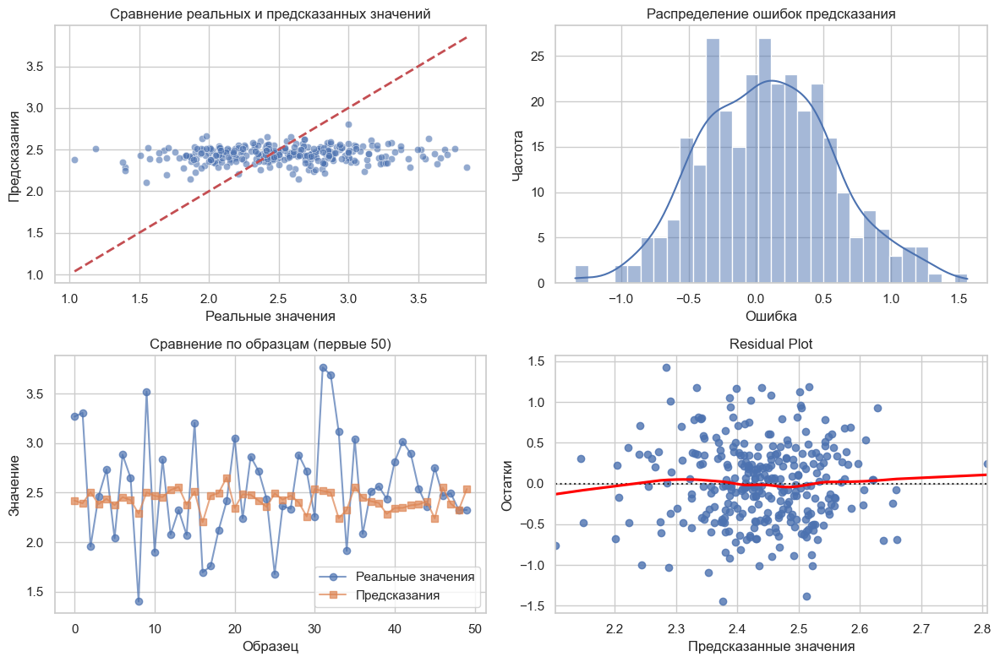

R² score: -0.0199
RMSE: 0.4994
MAPE: 16.5111


,Модель,Точность,MAE,RMSE,R2_Train,R2_Test,R2_Cross
0,KNRegressor,0.830074,0.419273,0.522437,0.099572,-0.116003,-0.1196 (+/-0.0585)
1,RidgeRegressor,0.836344,0.403802,0.503309,0.025296,-0.035780,-0.0077 (+/-0.0217)
2,LassoRegressor,0.838338,0.398881,0.500903,0.000000,-0.025900,-0.0019 (+/-0.0028)
3,SVR_RBF,0.837261,0.401539,0.503714,0.999573,-0.037447,-0.0095 (+/- 0.0280)
4,SVR_Poly,0.836623,0.403114,0.504941,0.034832,-0.042508,-0.0015 (+/- 0.0317)
5,PNRegressor,0.836237,0.404065,0.503933,0.055584,-0.038351,-0.0056 (+/-0.0176)
6,GradientBoostingRegressor,0.838190,0.399247,0.499429,0.422065,-0.019871,-0.0278 (+/-0.0313)
7,GradientBoostingRegr_PCA,0.836934,0.402345,0.507488,-0.052669,-0.053050,-0.0549 (+/-0.0441)
8,RFRegressor,0.838577,0.398293,0.499144,0.088381,-0.018708,-0.0064 (+/-0.0177)


In [43]:
df_ML1 = df_ML.copy()
#df_ML = remove_outliers_iqr(df_ML)
df_ML1.drop(['Модуль упругости при растяжении'],axis=1,inplace=True)
str_y = 'Прочность при растяжении'
#df_ML1.drop(['Прочность при растяжении'],axis=1,inplace=True)
#str_y = 'Модуль упругости при растяжении'
lst_X = []

df_model = pd.DataFrame(KNRegressor(df_ML1,str_y,lst_X))
df_model = pd.concat([df_model, pd.DataFrame(RidgeRegressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(LassoRegressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(SVR_rbf_regressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(SVR_rbf_regressor(df_ML1,str_y,lst_X,kernel='Poly'))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(PNRegressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(GBRegressor_best(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(GBRegressor_PCA(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(RFRegressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model

### Обучение на части датасета (Угол нашивки = 0) 

In [18]:
# Экспресс-обучение моделей для быстрого прикидочного расчета
df_ML_exp = df_ML.copy()
df_ML_exp = df_ML_exp.drop(df_ML_exp[df_ML_exp['Угол нашивки'] != 0].index)
df_ML_exp.drop(['Модуль упругости при растяжении'],axis=1,inplace=True)
str_y = 'Прочность при растяжении'
#df_ML.drop(['Прочность при растяжении'],axis=1,inplace=True)
#str_y = 'Модуль упругости при растяжении'
express_model_test(df_ML_exp,str_y)

Random Forest: Train R² = 0.856, Test R² = 0.037
Gradient Boosting: Train R² = 0.701, Test R² = -0.034
Linear Regression: Train R² = 0.049, Test R² = 0.024
Ridge Regression: Train R² = 0.049, Test R² = 0.024
Lasso Regression: Train R² = 0.049, Test R² = 0.025
KNN: Train R² = 0.192, Test R² = -0.229


In [24]:
df_ML1 = df_ML.copy()
df_ML1 = df_ML1.drop(df_ML1[df_ML1['Угол нашивки'] != 0].index)
df_ML1.drop(['Модуль упругости при растяжении'],axis=1,inplace=True)
str_y = 'Прочность при растяжении'
#df_ML1.drop(['Прочность при растяжении'],axis=1,inplace=True)
#str_y = 'Модуль упругости при растяжении'
lst_X = []

df_model = pd.DataFrame(KNRegressor(df_ML1,str_y,lst_X))
df_model = pd.concat([df_model, pd.DataFrame(RidgeRegressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(LassoRegressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(SVR_rbf_regressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(SVR_rbf_regressor(df_ML1,str_y,lst_X,kernel='Poly'))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(PNRegressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(GBRegressor_best(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(GBRegressor_PCA(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(RFRegressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model

Fitting 5 folds for each of 96 candidates, totalling 480 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits


,Модель,Точность,MAE,RMSE,R2_Train,R2_Test,R2_Cross
0,KNRegressor,0.847986,373.307757,461.631386,1.000000,0.042194,-0.1006 (+/-0.0202)
1,RidgeRegressor,0.843827,383.521996,465.933747,0.049439,0.024258,0.0112 (+/-0.0479)
2,LassoRegressor,0.844062,382.944780,471.875569,0.000000,-0.000787,-0.0070 (+/-0.0104)
3,SVR_RBF,0.844539,381.772914,470.861646,0.278257,0.003509,-0.0054 (+/- 0.0230)
4,SVR_Poly,0.844370,382.188298,471.213509,0.002030,0.002019,-0.0054 (+/- 0.0250)
5,PNRegressor,0.844364,382.203471,463.858363,0.066810,0.032931,0.0094 (+/-0.0447)
6,GradientBoostingRegressor,0.848512,372.018011,463.102478,0.588858,0.036080,-0.0050 (+/-0.0270)
7,GradientBoostingRegr_PCA,0.840501,391.688943,487.590719,-0.147416,-0.068557,-0.0567 (+/-0.0776)
8,RFRegressor,0.846499,376.961314,462.705514,0.168246,0.037732,0.0144 (+/-0.0152)


In [25]:
### Обучение на части датасета (Угол нашивки != 0) 

In [26]:
# Экспресс-обучение моделей для быстрого прикидочного расчета
df_ML_exp = df_ML.copy()
df_ML_exp = df_ML_exp.drop(df_ML_exp[df_ML_exp['Угол нашивки'] == 0].index)
df_ML_exp.drop(['Модуль упругости при растяжении'],axis=1,inplace=True)
str_y = 'Прочность при растяжении'
#df_ML.drop(['Прочность при растяжении'],axis=1,inplace=True)
#str_y = 'Модуль упругости при растяжении'
express_model_test(df_ML_exp,str_y)

Random Forest: Train R² = 0.852, Test R² = -0.051
Gradient Boosting: Train R² = 0.693, Test R² = -0.145
Linear Regression: Train R² = 0.020, Test R² = -0.010
Ridge Regression: Train R² = 0.020, Test R² = -0.010
Lasso Regression: Train R² = 0.020, Test R² = -0.009
KNN: Train R² = 0.195, Test R² = -0.130


In [27]:
df_ML1 = df_ML.copy()
df_ML1 = df_ML1.drop(df_ML1[df_ML1['Угол нашивки'] == 0].index)
df_ML1.drop(['Модуль упругости при растяжении'],axis=1,inplace=True)
str_y = 'Прочность при растяжении'
#df_ML1.drop(['Прочность при растяжении'],axis=1,inplace=True)
#str_y = 'Модуль упругости при растяжении'
lst_X = []

df_model = pd.DataFrame(KNRegressor(df_ML1,str_y,lst_X))
df_model = pd.concat([df_model, pd.DataFrame(RidgeRegressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(LassoRegressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(SVR_rbf_regressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(SVR_rbf_regressor(df_ML1,str_y,lst_X,kernel='Poly'))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(PNRegressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(GBRegressor_best(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(GBRegressor_PCA(df_ML1,str_y,lst_X))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(RFRegressor(df_ML1,str_y,lst_X))], ignore_index=True)
df_model

Fitting 5 folds for each of 96 candidates, totalling 480 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits


,Модель,Точность,MAE,RMSE,R2_Train,R2_Test,R2_Cross
0,KNRegressor,0.831639,417.277972,526.064651,0.116330,-0.146864,-0.1537 (+/-0.0515)
1,RidgeRegressor,0.842613,390.079072,493.573367,0.020317,-0.009572,-0.0412 (+/-0.0315)
2,LassoRegressor,0.842573,390.177411,491.370461,0.000000,-0.000580,-0.0096 (+/-0.0135)
3,SVR_RBF,0.842554,390.225393,491.790074,0.002109,-0.002290,-0.0080 (+/- 0.0251)
4,SVR_Poly,0.842587,390.144610,491.645164,-0.000213,-0.001699,-0.0080 (+/- 0.0272)
5,PNRegressor,0.841842,391.989005,497.196817,0.048715,-0.024449,-0.0463 (+/-0.0318)
6,GradientBoostingRegressor,0.837686,402.289615,511.840867,0.550753,-0.085684,-0.0973 (+/-0.0231)
7,GradientBoostingRegr_PCA,0.836137,406.129807,515.027999,-0.170508,-0.099247,-0.1052 (+/-0.0561)
8,RFRegressor,0.842507,390.342514,493.955432,0.144784,-0.011135,-0.0347 (+/-0.0188)


## Шаг 7: Обучение моделей (на датасете 40 строк)
- Для прогнозирования целевой переменной "Прочность при растяжении" лучшей моделью оказалась Ridge(alpha=15.0) с результатом: MAPE=17.4% R2(Test)=0.345. Линейная модель показала лучшую обобщающую способность.
- Для прогнозирования целевой переменной "Модуль упругости при растяжении" лучшей моделью оказалась GradientBoostingRegressor с результатом: MAPE=1.59% R2(Test)=0.188. У модели оказалась исключительная точность предсказаний.
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
- RandomForest показал хорошие результаты на прогнозировании "Прочность при растяжении", но плохие (отрицательный R2) на "Модуль упругости при растяжении"
- Модели KNN, SVR (на маленькой выборке не успевает подобрать критические параметры C, gamma, epsilon) оказались не успешными (отрицательный R2)
- применение PCA в данном случае ухудшает качество (теряются зависимости - размываются по компонентам)
- Применение модели Rige с полинома (PolynomialFeatures) оказалось не удачным, т.к. модель породила много признаков, но из-за малого объема данных не смогла заучить устойчивые зависимости.
-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
- качество данных: 40 строк в датасете недостаточно для сложных моделей; требуется работа с выбросами, но датасет маленький - нужно не ошибиться
- "Прочность при растяжении" имеет более линейные зависимости (смогла справиться линейная модель Ridge), а "Модуль упругости при растяжении" - сложные нелинейные.

In [91]:
# Экспресс-обучение моделей для быстрого прикидочного расчета
#df_ML_exp = df_ML.copy()
#df_ML_exp.drop(['Модуль упругости при растяжении'],axis=1,inplace=True)
#str_y = 'Прочность при растяжении'
#df_ML.drop(['Прочность при растяжении'],axis=1,inplace=True)
#str_y = 'Модуль упругости при растяжении'
#express_model_test(df_ML_exp,str_y)


In [ ]:
# Выгрузка лучшей модели
# Обучаем модели для прогнозирования целевой переменной 'Прочность при растяжении'
df_ML1 = df_ML.copy()
df_ML1.drop(['Модуль упругости при растяжении'],axis=1,inplace=True)
str_y = 'Прочность при растяжении'
lst_X = []
df_model = pd.concat([df_model, pd.DataFrame(GBRegressor_best(df_ML1,str_y,lst_X,True,1,1))], ignore_index=True)

Fitting 5 folds for each of 8 candidates, totalling 40 fits
----------------------------------------
Модель: KNeighborsRegressor
----------------------------------------
Лучшие параметры: {'knn__n_neighbors': 15, 'knn__p': 1, 'knn__weights': 'uniform'}
Лучший score: -238628.94695121114


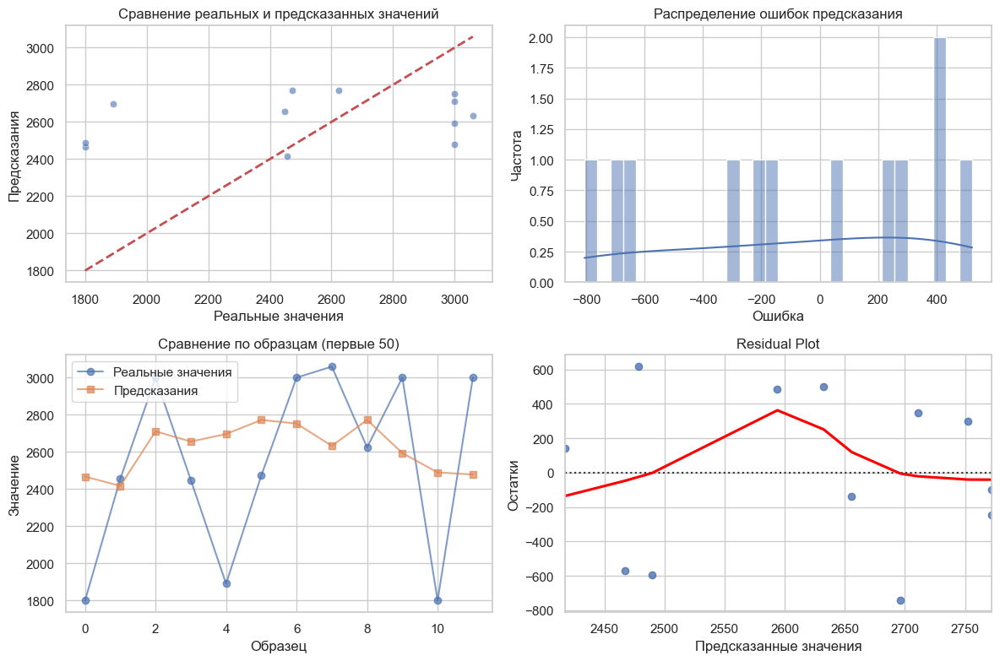

R² score: 0.0640
RMSE: 455.4410
MAPE: 17.3734
----------------------------------------
Модель: Ridge
----------------------------------------


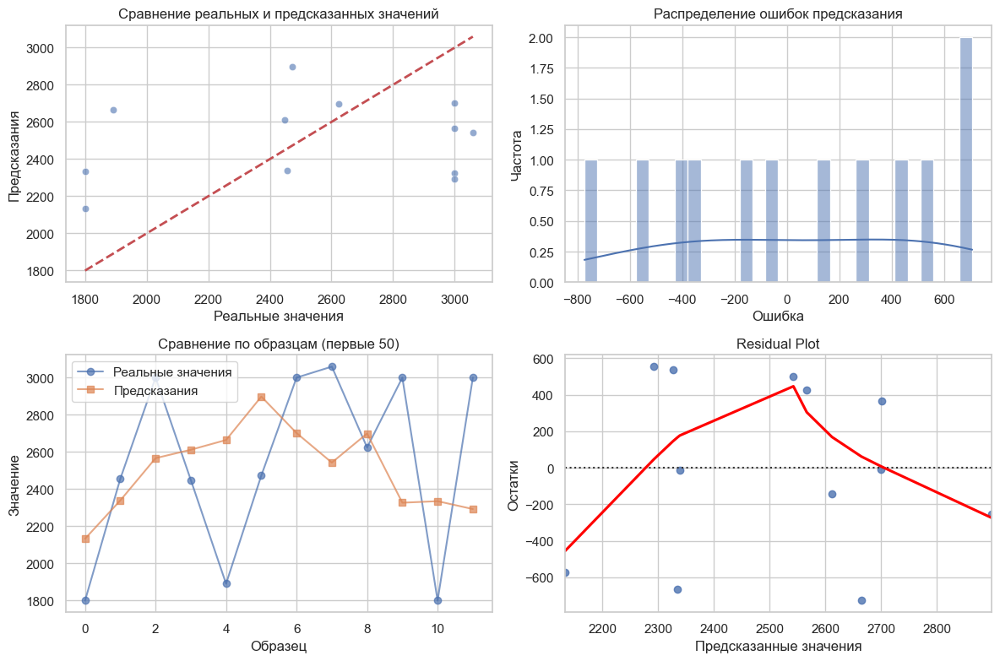

R² score: -0.0225
RMSE: 476.0356
MAPE: 17.3219
----------------------------------------
Модель: Lasso
----------------------------------------


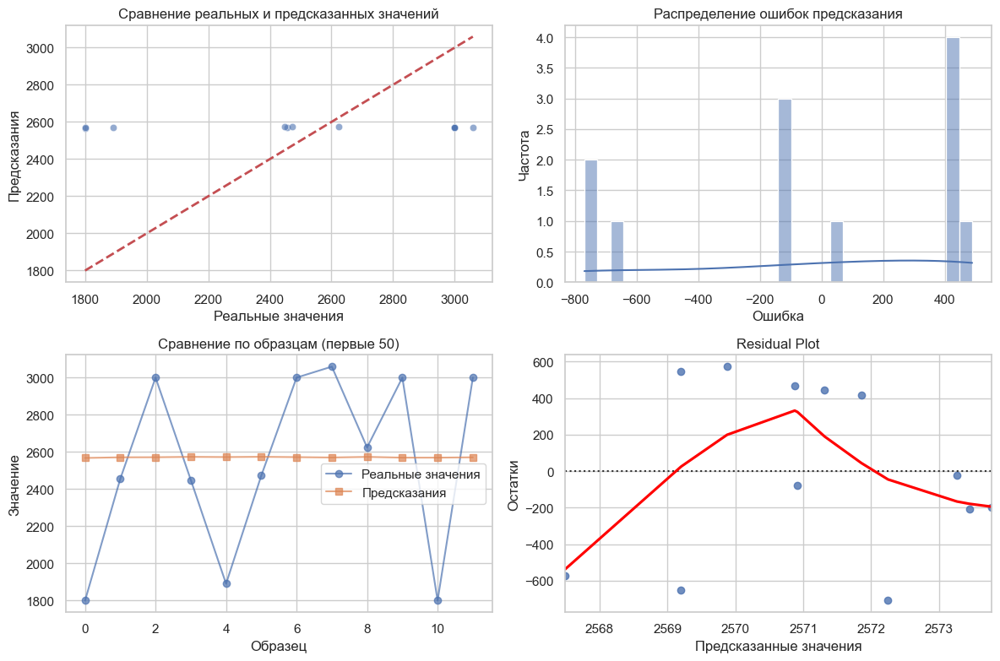

R² score: -0.0014
RMSE: 471.0871
MAPE: 17.5360
Fitting 5 folds for each of 18 candidates, totalling 90 fits
----------------------------------------
Модель: SVR_RBF
----------------------------------------
Лучшие параметры: {'svr__C': 10, 'svr__epsilon': 0.5, 'svr__gamma': 0.01}
Лучший score (neg MSE): -278382.5811



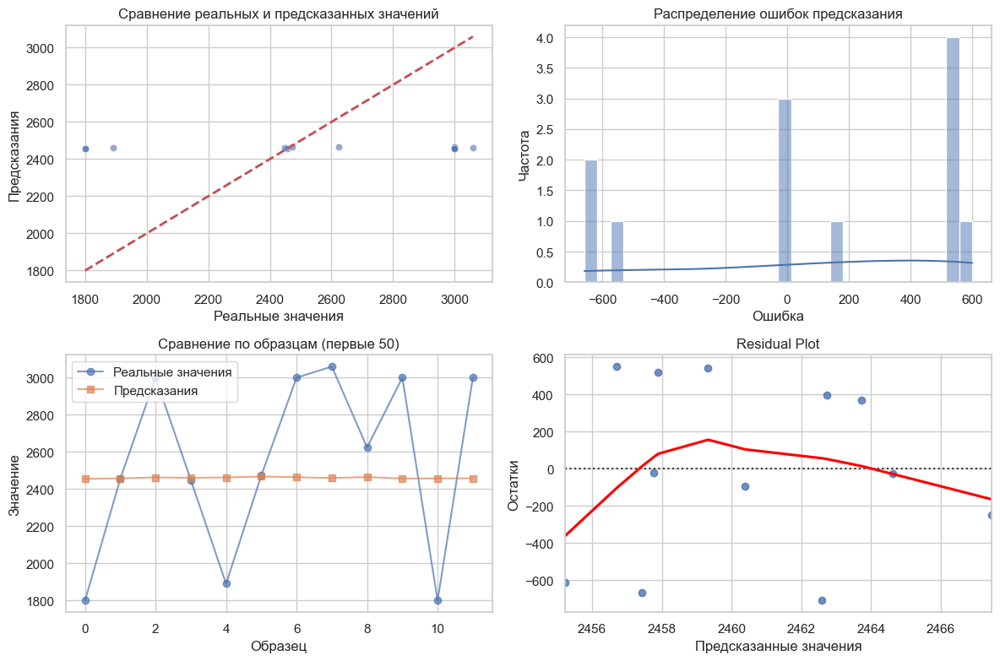

R² score: -0.0301
RMSE: 477.7861
MAPE: 16.8017
Fitting 5 folds for each of 8 candidates, totalling 40 fits
----------------------------------------
Модель: SVR_Poly
----------------------------------------
Лучшие параметры: {'svr__C': 100, 'svr__epsilon': 0.1, 'svr__gamma': 'auto'}
Лучший score (neg MSE): -253482.5463



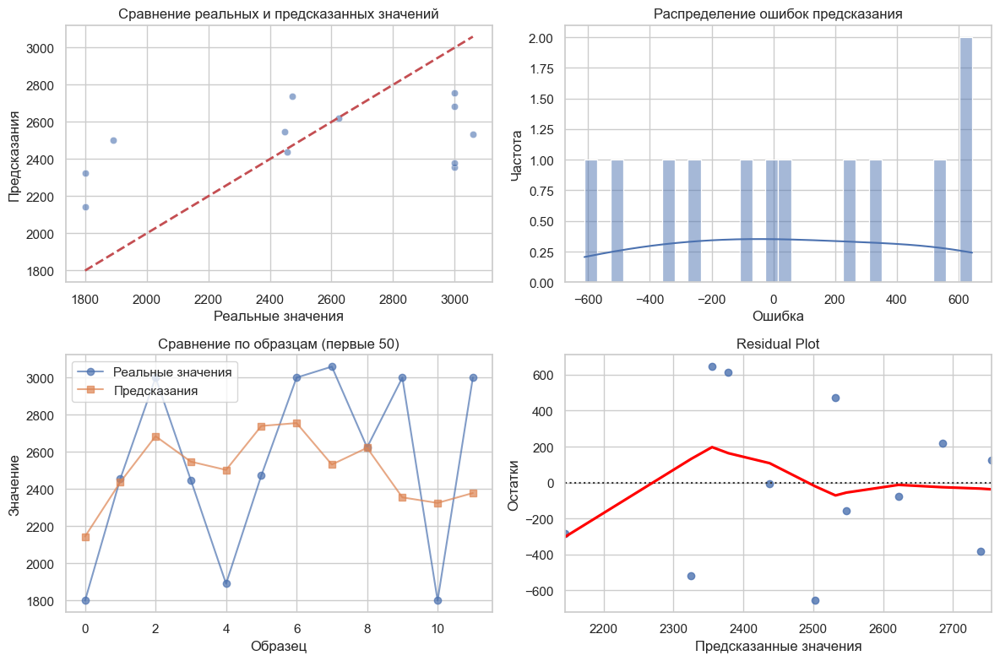

R² score: 0.2141
RMSE: 417.3232
MAPE: 14.5366
----------------------------------------
Модель: Ridge_PolynomialFeatures
----------------------------------------


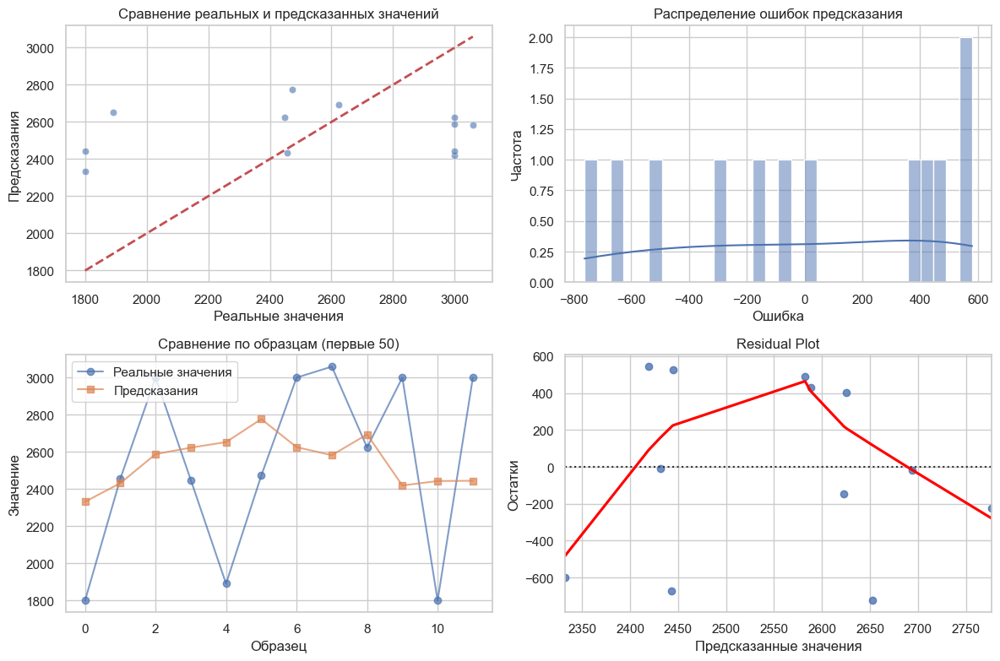

R² score: 0.0265
RMSE: 464.4873
MAPE: 17.3602
Fitting 5 folds for each of 1 candidates, totalling 5 fits
----------------------------------------
Модель: GradientBoostingRegressor
----------------------------------------
Лучшие параметры: {'gbr__learning_rate': 0.1, 'gbr__max_depth': 3, 'gbr__max_features': 0.8, 'gbr__min_samples_leaf': 2, 'gbr__min_samples_split': 5, 'gbr__n_estimators': 40, 'gbr__random_state': 42, 'gbr__subsample': 0.8}
Лучший score: -335.6072279551598


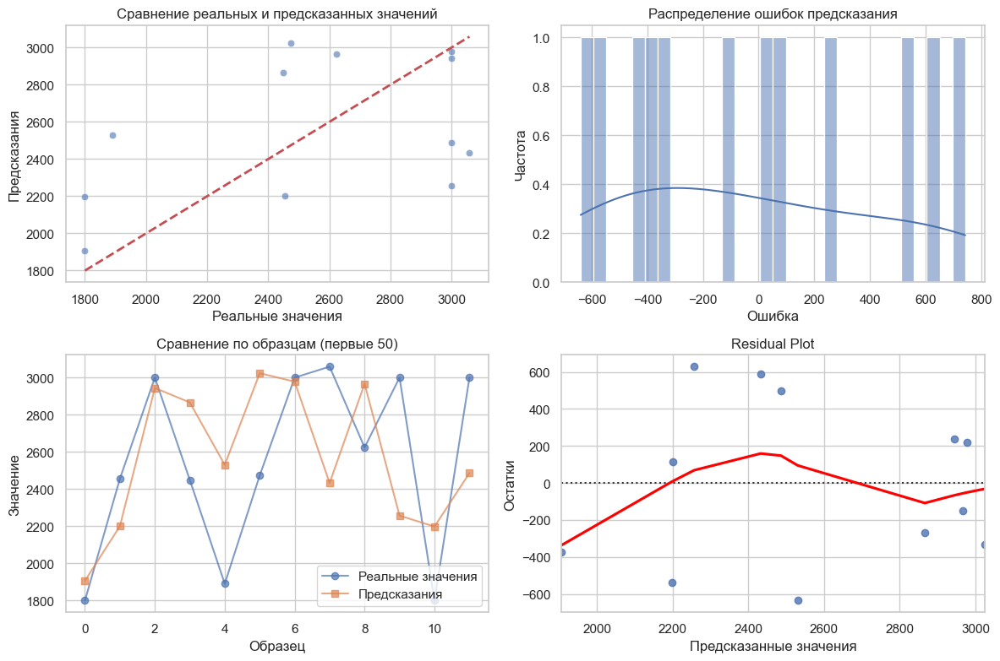

R² score: 0.0782
RMSE: 451.9658
MAPE: 15.8012
Fitting 5 folds for each of 1 candidates, totalling 5 fits
----------------------------------------
Модель: GradientBoostingRegressor_PCA
----------------------------------------
Лучшие параметры: {'gbr__learning_rate': 0.1, 'gbr__max_depth': 3, 'gbr__max_features': 0.8, 'gbr__min_samples_leaf': 2, 'gbr__min_samples_split': 5, 'gbr__n_estimators': 40, 'gbr__random_state': 42, 'gbr__subsample': 0.8}
Лучший score: -0.48327019788277453


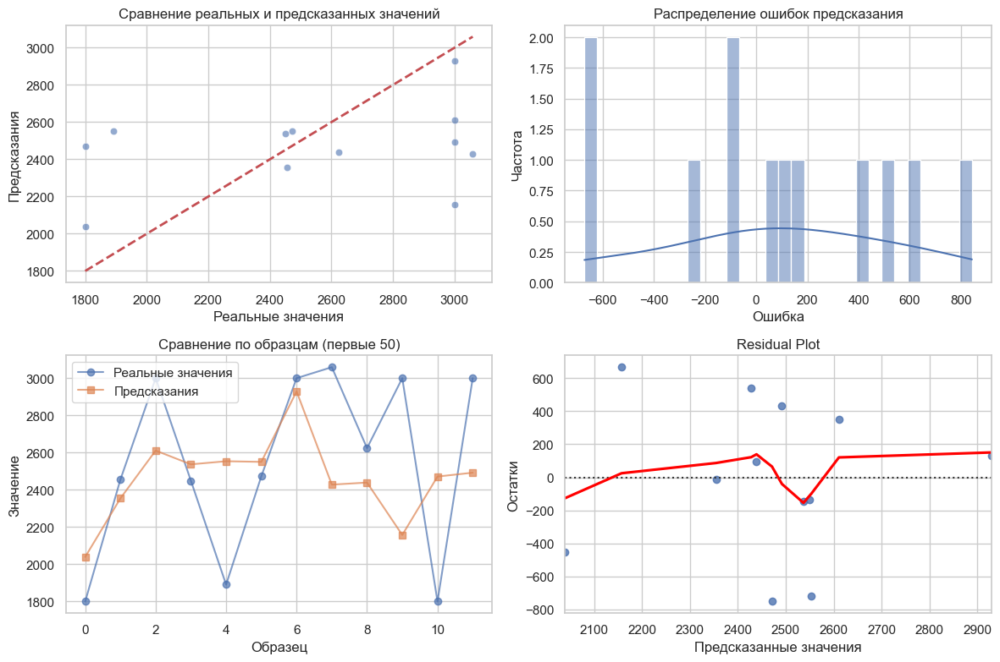

R² score: 0.0492
RMSE: 459.0391
MAPE: 15.3780
Fitting 3 folds for each of 72 candidates, totalling 216 fits
----------------------------------------
Модель: RandomForestRegressor
----------------------------------------
Лучшие параметры: {'rf__max_depth': 5, 'rf__max_features': 0.6, 'rf__min_samples_leaf': 1, 'rf__min_samples_split': 2, 'rf__n_estimators': 50}
Лучший score: -203740.81705825767


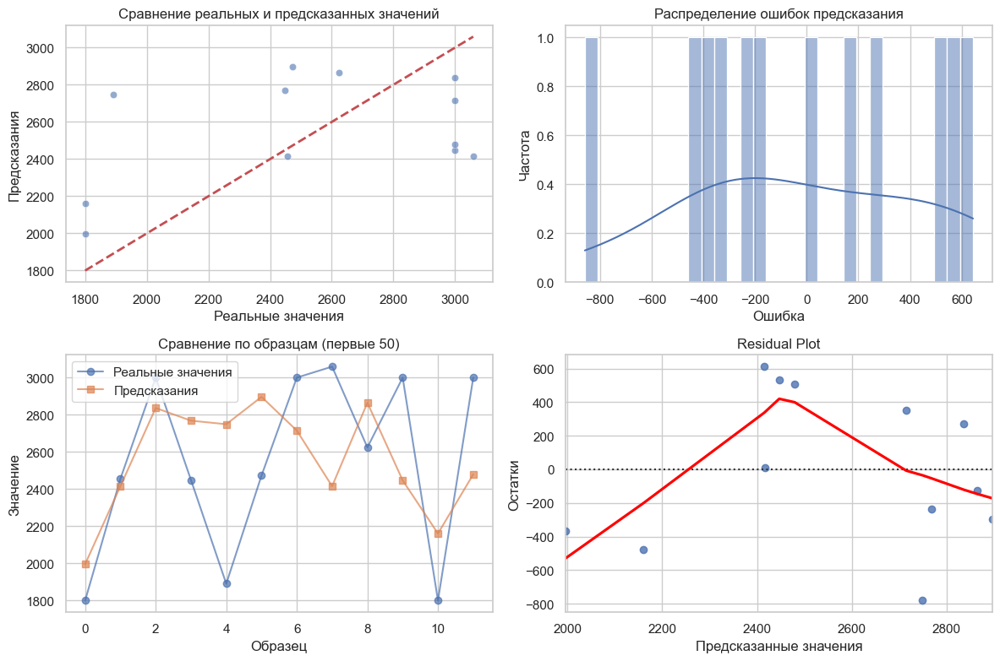

R² score: 0.1180
RMSE: 442.1233
MAPE: 15.7555


,Модель,MAPE,MAE,RMSE,R2_Train,R2_Test,R2_Cross
0,KNN,17.373414,395.446497,455.440976,0.176684,0.064017,-0.5190 (+/-0.4053)
1,Ridge,17.321918,420.814221,476.035608,0.390158,-0.022546,-0.1936 (+/-0.1397)
2,Lasso,17.536023,401.296329,471.087097,0.003863,-0.001397,-0.0475 (+/-0.0410)
3,SVR_RBF,16.801702,401.850170,477.786127,-0.042855,-0.030080,-0.7540 (+/- 0.8577)
4,SVR_Poly,14.536586,351.723401,417.323199,0.486578,0.214133,-0.9056 (+/- 1.3865)
5,Ridge_Poly,17.360240,409.054126,464.487343,0.289439,0.026465,-0.9050 (+/-0.7363)
6,GradientBoostingRegressor,15.801185,389.306563,451.965787,0.980071,0.078246,-0.8017 (+/-2.0852)
7,GradientBoostingRegr_PCA,15.378002,372.241505,459.039054,-0.483270,0.049169,-1.1719 (+/-0.7712)
8,RandomForestRegressor,15.755479,383.689462,442.123280,0.902716,0.117955,-0.2261 (+/-0.3065)


In [73]:
# Обучаем модели для прогнозирования целевой переменной 'Прочность при растяжении'
df_ML1 = df_ML.copy()
df_ML1.drop(['Модуль упругости при растяжении'],axis=1,inplace=True)
str_y = 'Прочность при растяжении'
lst_X = []

df_model = pd.DataFrame(KNRegressor(df_ML1,str_y,lst_X,True,1))
df_model = pd.concat([df_model, pd.DataFrame(RidgeRegressor(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(LassoRegressor(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(SVR_rbf_regressor(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(SVR_rbf_regressor(df_ML1,str_y,lst_X,True,1,kernel='Poly'))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(PNRegressor(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(GBRegressor_best(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(GBRegressor_PCA(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(RFRegressor(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model

Fitting 5 folds for each of 8 candidates, totalling 40 fits
----------------------------------------
Модель: KNeighborsRegressor
----------------------------------------
Лучшие параметры: {'knn__n_neighbors': 7, 'knn__p': 1, 'knn__weights': 'uniform'}
Лучший score: -7.045646103216657


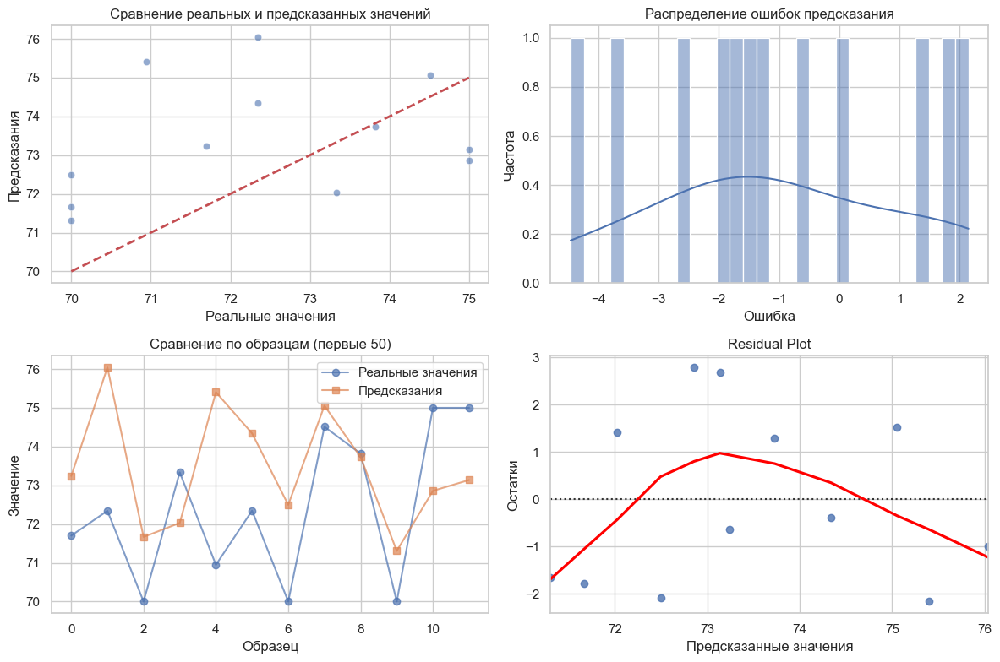

R² score: -0.4895
RMSE: 2.2487
MAPE: 2.6734
----------------------------------------
Модель: Ridge
----------------------------------------


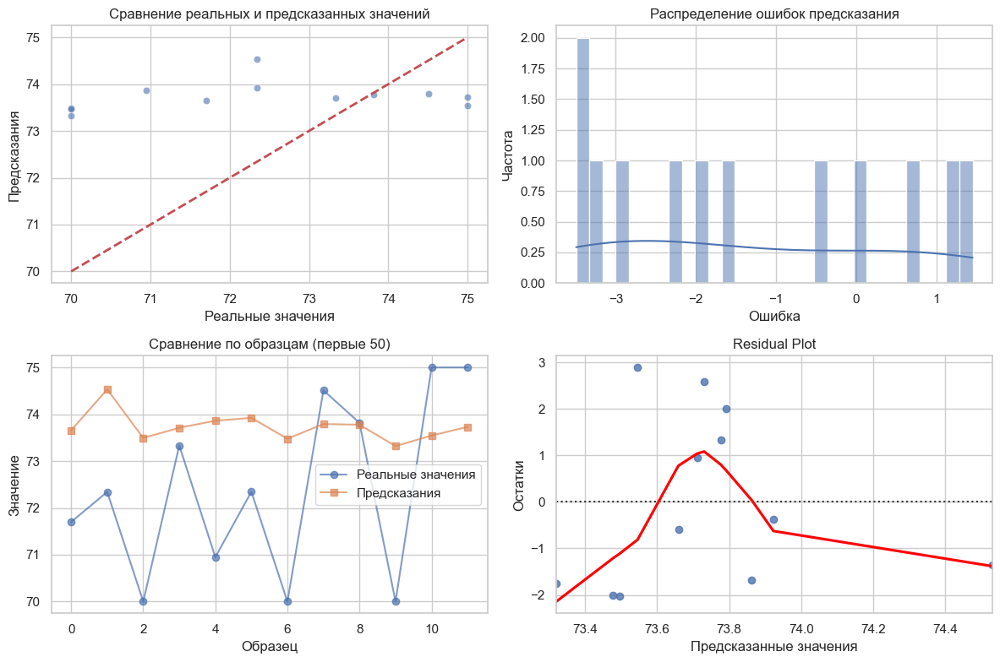

R² score: -0.4566
RMSE: 2.2237
MAPE: 2.6598
----------------------------------------
Модель: Lasso
----------------------------------------


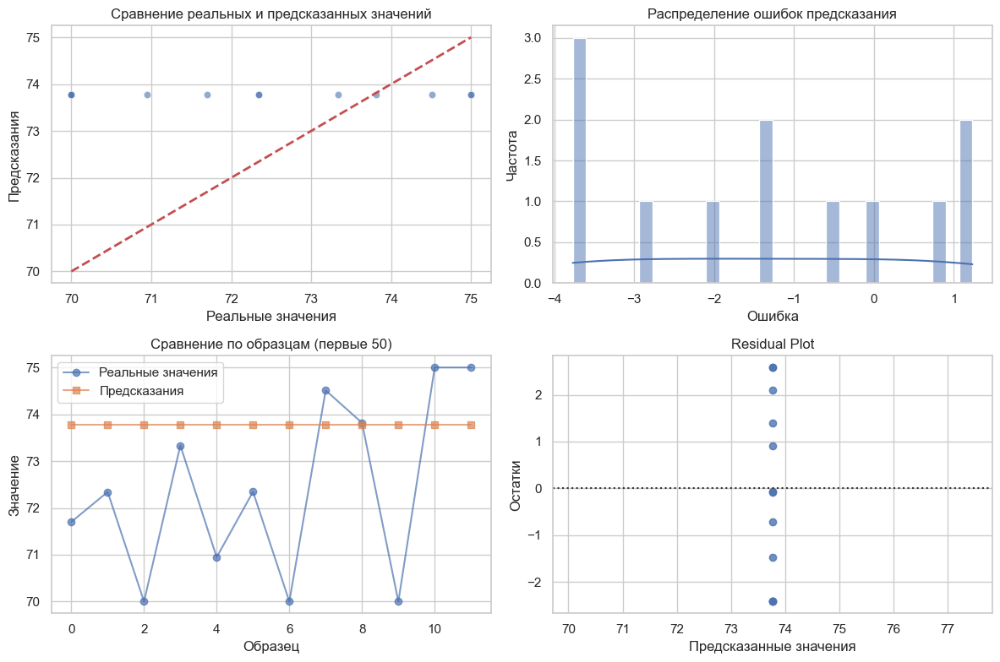

R² score: -0.5382
RMSE: 2.2852
MAPE: 2.6573
Fitting 5 folds for each of 18 candidates, totalling 90 fits
----------------------------------------
Модель: SVR_RBF
----------------------------------------
Лучшие параметры: {'svr__C': 10, 'svr__epsilon': 0.5, 'svr__gamma': 0.01}
Лучший score (neg MSE): -7.7286



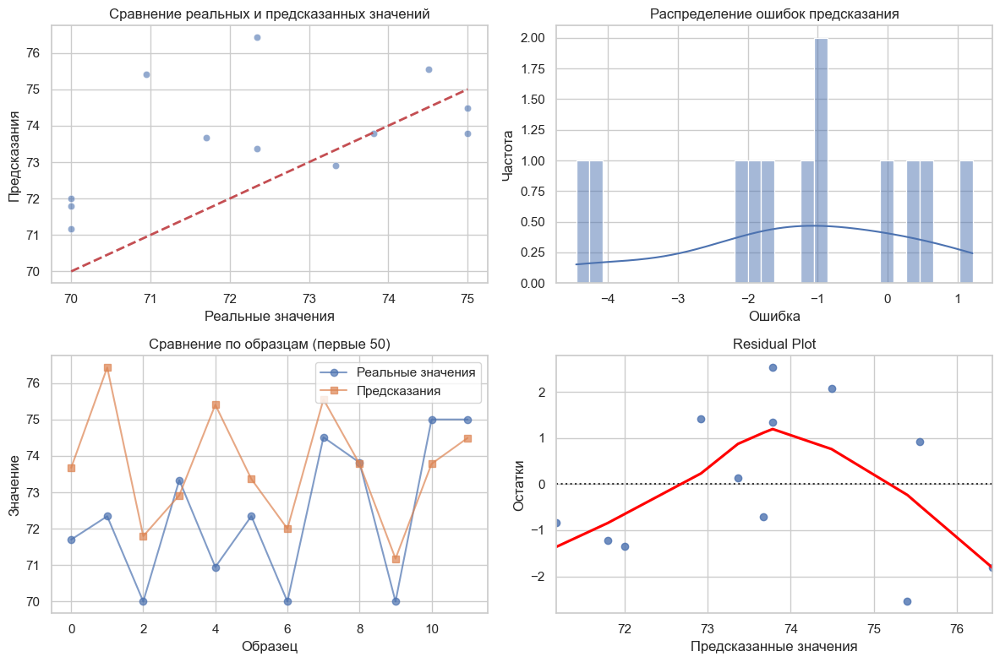

R² score: -0.3031
RMSE: 2.1033
MAPE: 2.2921
Fitting 5 folds for each of 8 candidates, totalling 40 fits
----------------------------------------
Модель: SVR_Poly
----------------------------------------
Лучшие параметры: {'svr__C': 100, 'svr__epsilon': 0.1, 'svr__gamma': 0.01}
Лучший score (neg MSE): -8.1837



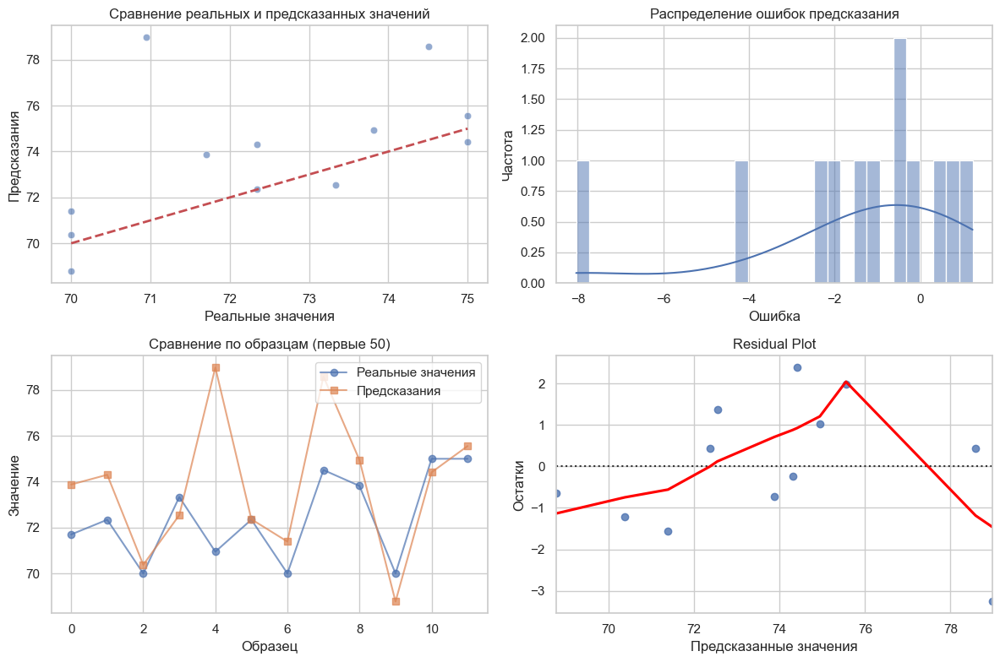

R² score: -1.3537
RMSE: 2.8267
MAPE: 2.5810
----------------------------------------
Модель: Ridge_PolynomialFeatures
----------------------------------------


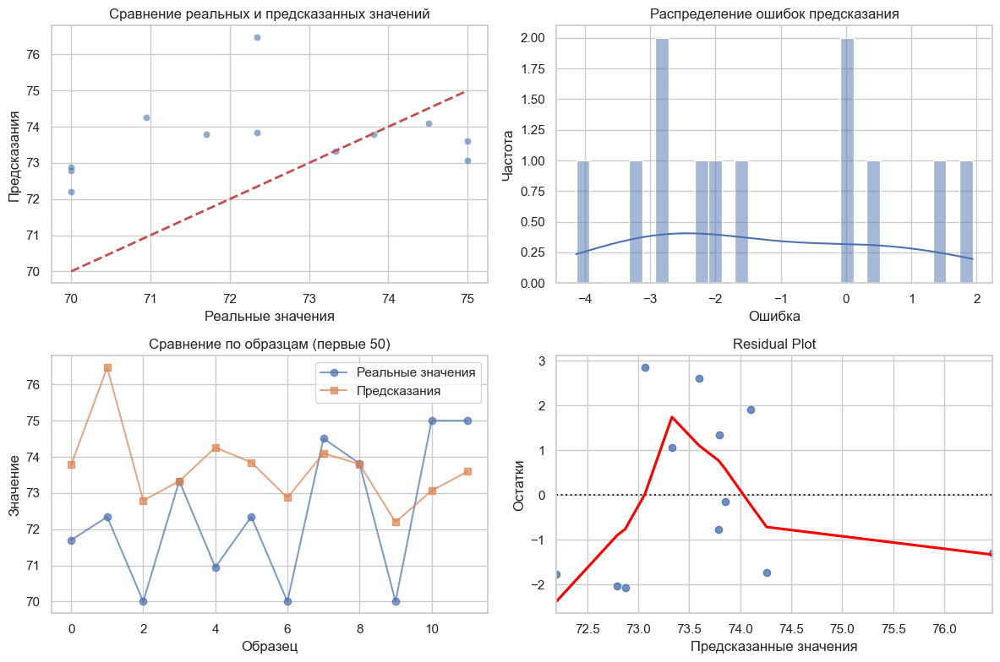

R² score: -0.5067
RMSE: 2.2616
MAPE: 2.6352
Fitting 5 folds for each of 1 candidates, totalling 5 fits
----------------------------------------
Модель: GradientBoostingRegressor
----------------------------------------
Лучшие параметры: {'gbr__learning_rate': 0.1, 'gbr__max_depth': 3, 'gbr__max_features': 0.8, 'gbr__min_samples_leaf': 2, 'gbr__min_samples_split': 5, 'gbr__n_estimators': 30, 'gbr__random_state': 42, 'gbr__subsample': 0.8}
Лучший score: -1.9828962247476671


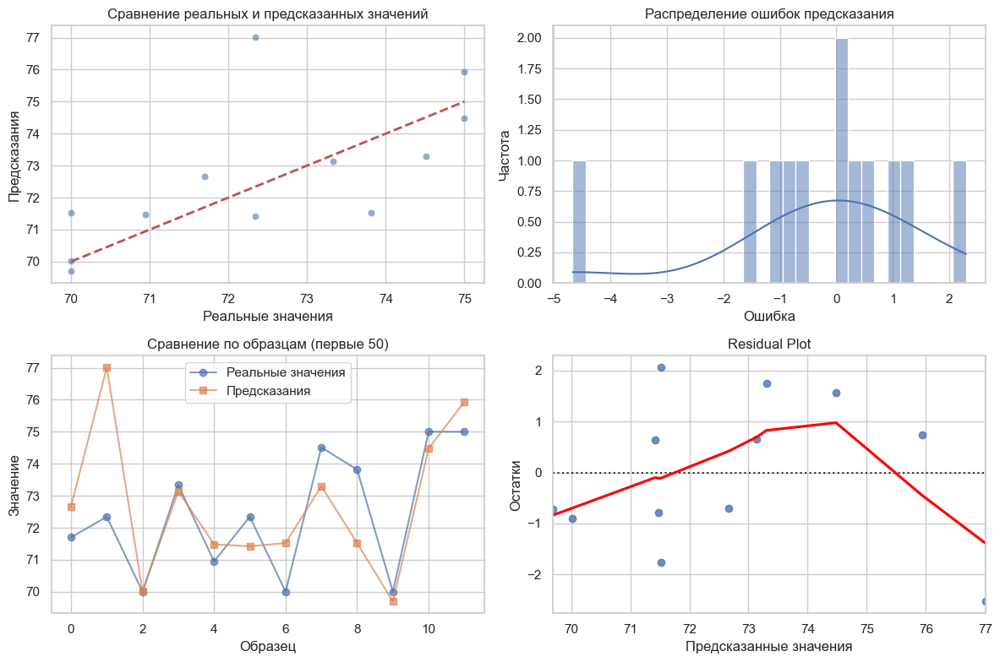

R² score: 0.1610
RMSE: 1.6877
MAPE: 1.6166
Fitting 5 folds for each of 1 candidates, totalling 5 fits
----------------------------------------
Модель: GradientBoostingRegressor_PCA
----------------------------------------
Лучшие параметры: {'gbr__learning_rate': 0.1, 'gbr__max_depth': 3, 'gbr__max_features': 0.8, 'gbr__min_samples_leaf': 2, 'gbr__min_samples_split': 5, 'gbr__n_estimators': 30, 'gbr__random_state': 42, 'gbr__subsample': 0.8}
Лучший score: 0.009031159919712284


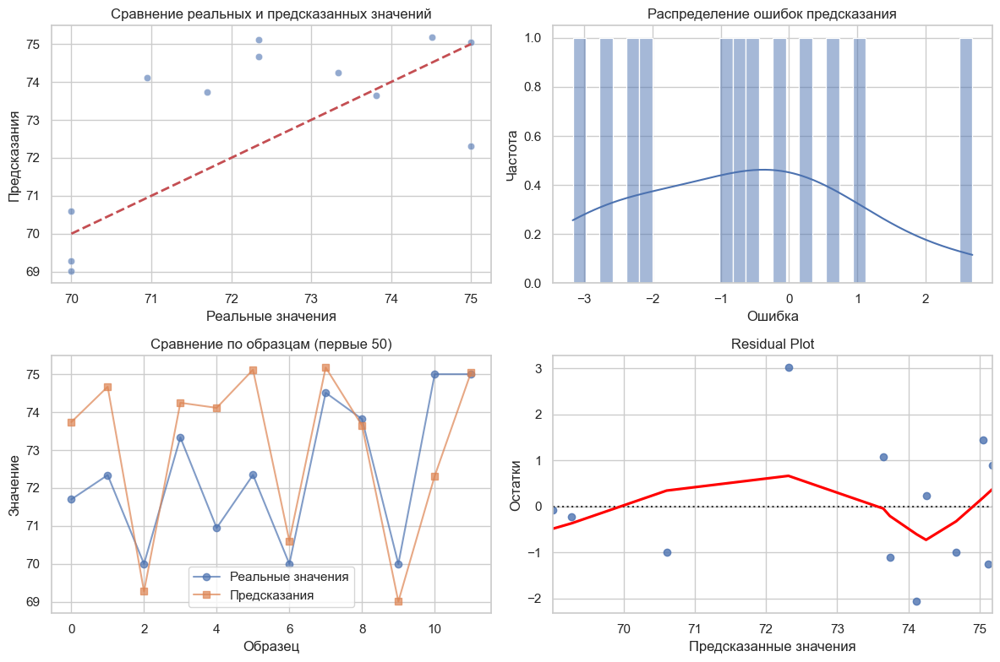

R² score: 0.0756
RMSE: 1.7715
MAPE: 1.9737
Fitting 3 folds for each of 72 candidates, totalling 216 fits
----------------------------------------
Модель: RandomForestRegressor
----------------------------------------
Лучшие параметры: {'rf__max_depth': 5, 'rf__max_features': 0.6, 'rf__min_samples_leaf': 2, 'rf__min_samples_split': 2, 'rf__n_estimators': 70}
Лучший score: -6.109524001558076


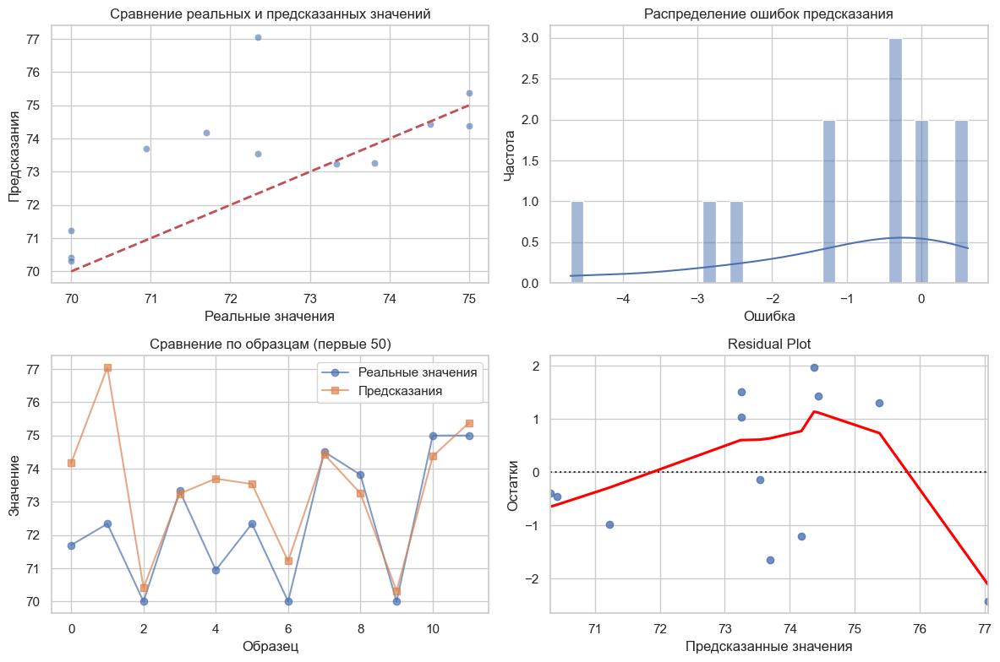

R² score: 0.0199
RMSE: 1.8241
MAPE: 1.7162


,Модель,MAPE,MAE,RMSE,R2_Train,R2_Test,R2_Cross
0,KNN,2.673393,1.925062,2.248706,0.487744,-0.489507,-0.7372 (+/-1.0309)
1,Ridge,2.659802,1.899507,2.223728,0.230842,-0.456601,-0.1557 (+/-0.1873)
2,Lasso,2.657330,1.894343,2.285185,0.000000,-0.538225,-0.2123 (+/-0.1426)
3,SVR_RBF,2.292085,1.643664,2.103302,0.664777,-0.303108,-0.8200 (+/- 2.4594)
4,SVR_Poly,2.580998,1.860059,2.826734,0.819410,-1.353678,-0.5058 (+/- 0.6198)
5,Ridge_Poly,2.635160,1.888339,2.261635,0.519847,-0.506684,-0.8605 (+/-1.3436)
6,GradientBoostingRegressor,1.616627,1.174017,1.687722,0.973577,0.160968,0.3387 (+/-0.4128)
7,GradientBoostingRegr_PCA,1.973673,1.425618,1.771525,0.009031,0.075575,-0.7442 (+/-1.1382)
8,RandomForestRegressor,1.716162,1.233899,1.824063,0.851534,0.019931,-0.1869 (+/-0.5375)


In [89]:
df_ML1 = df_ML.copy()
#df_ML = remove_outliers_iqr(df_ML)
df_ML1.drop(['Прочность при растяжении'],axis=1,inplace=True)
str_y = 'Модуль упругости при растяжении'
#df_ML1.drop(['Прочность при растяжении'],axis=1,inplace=True)
#str_y = 'Модуль упругости при растяжении'
lst_X = []

df_model = pd.DataFrame(KNRegressor(df_ML1,str_y,lst_X,True,1))
df_model = pd.concat([df_model, pd.DataFrame(RidgeRegressor(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(LassoRegressor(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(SVR_rbf_regressor(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(SVR_rbf_regressor(df_ML1,str_y,lst_X,True,1,kernel='Poly'))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(PNRegressor(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(GBRegressor_best(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(GBRegressor_PCA(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model = pd.concat([df_model, pd.DataFrame(RFRegressor(df_ML1,str_y,lst_X,True,1))], ignore_index=True)
df_model

# Шаг 8: Нейросеть (на датасете 40 строк)

## Функции

In [28]:
def plot_loss(history):
  plt.plot(history.history['loss'], label='Ошибка обучения')
  plt.plot(history.history['val_loss'], label='Ошибка валидации')
  plt.ylim([0, 10])
  plt.xlabel('Эпохи обучения')
  plt.ylabel('Ошибка прогноза по [MPG]')
  plt.legend()
  plt.grid(True)

## Обучение нейросети
- При использовании всех 11 признаков нейросеть на такой маленькой выборке (39 строк) не дала репрезентативных результатов. Увеличение слоев или нейронов не дает хороших и стабильных результатов. R2 изменяется при обучении от запуска к запуску на при одинаковых параметрах нейросети. Нейросеть не может выучить на этих данных.
- Нейросеть, обученная только на 4 признаках дала лучшие результаты. Для получения репрезентативных результатов проведено 10 запусков модели с фиксированными гиперпараметрами. В качестве итоговых метрик приняты средние значения: R² = 0.17 ± 0.04, MAPE = 24% ± 2%

### Обучение на датасете 39 записей, с использованием 11 признаков. Параметр "Температура вспышки" удалил из датасета еще ранее.
- Здесь, целевая переменная  "Соотношение матрица-наполнитель", а все остальные колонки - входные признаки  
- Результат: Нейросеть не дала значимых результатов (R2 - отрицательный)

Epoch 1/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step - loss: 3.9523 - mae: 1.7232 - val_loss: 4.1508 - val_mae: 1.6353
Epoch 2/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 1.8043 - mae: 1.1518 - val_loss: 2.0248 - val_mae: 1.2299
Epoch 3/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 1.2025 - mae: 0.9426 - val_loss: 1.1465 - val_mae: 0.9135
Epoch 4/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 1.1823 - mae: 0.9053 - val_loss: 0.8824 - val_mae: 0.8296
Epoch 5/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.6703 - mae: 0.6530 - val_loss: 0.7254 - val_mae: 0.7933
Epoch 6/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.5352 - mae: 0.6031 - val_loss: 0.5990 - val_mae: 0.7009
Epoch 7/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.6043 - mae: 0.6487 - val_loss: 0.4931 - val_mae: 0.6366
Epoch 8/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.5046 - mae: 0.5882 - val_loss: 0.4370 - val_mae: 0.6033
Epoch 9/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 0.3052 - mae:

Model: "sequential_86"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ normalization_85                │ (None, 11)             │            23 │
│ (Normalization)                 │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_189 (Dense)               │ (None, 8)              │            96 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_190 (Dense)               │ (None, 1)              │             9 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 235 (948.00 B)

 Trainable params: 105 (420.00 B)

 Non-trainable params: 23 (96.00 B)

 Optimizer params: 107 (432.00 B)

MSE: 2.36504782327813
R² Score: -1.9827044459112897


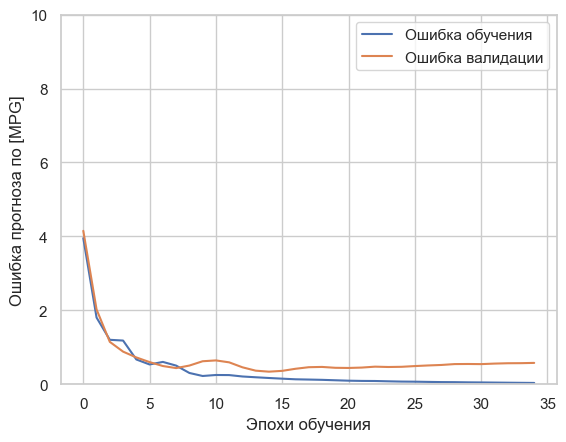

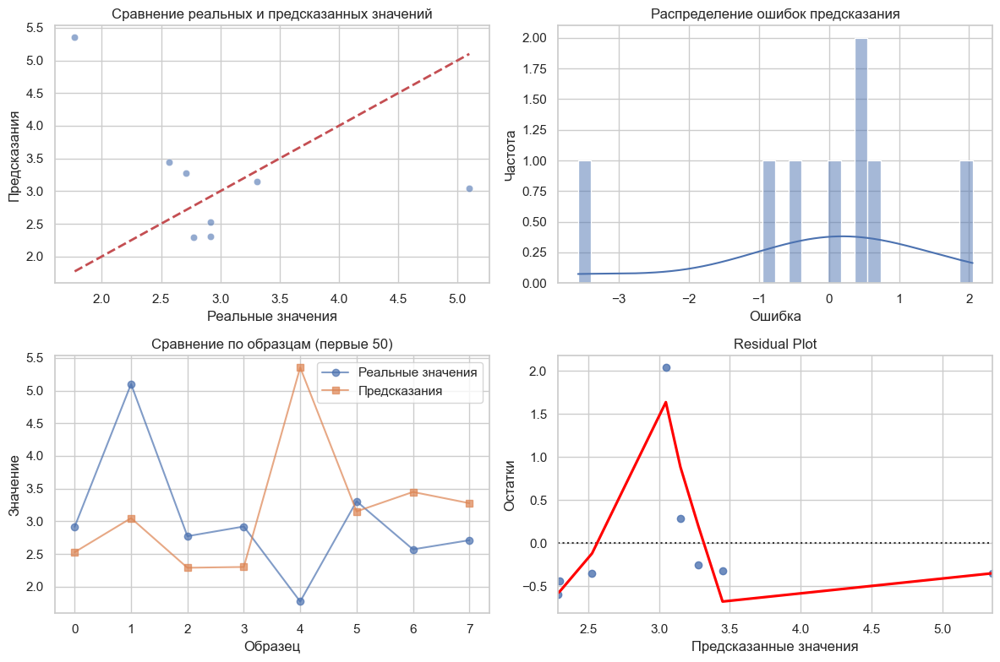

R² score: -1.9827
RMSE: 1.5379
MAPE: 44.2747


In [ ]:

import tensorflow as tf
from tensorflow import keras
#from tensorflow.keras import layers
import numpy as np
from keras.callbacks import EarlyStopping
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def create_model(input_shape, x_tr):
    model = keras.Sequential()
    
    # Входной слой + нормализация
    model.add(keras.layers.Input(shape=input_shape))
    normalization_layer = keras.layers.Normalization()
    normalization_layer.adapt(x_tr)  
    model.add(normalization_layer)
    
    # Скрытые слои
    model.add(keras.layers.Dense(8, activation='relu'))
    
    # Выходной слой
    model.add(keras.layers.Dense(1))
    
    return model

# Подготовка данных
X = df_NNW.copy()
y = df_NNW['Соотношение матрица-наполнитель']
X = X.drop(['Соотношение матрица-наполнитель'], axis=1)

# Разделение данных
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Убедимся, что данные в numpy формате
X_train_np = X_train.to_numpy().astype('float32')
X_test_np = X_test.to_numpy().astype('float32')
y_train_np = y_train.to_numpy().astype('float32')
y_test_np = y_test.to_numpy().astype('float32')

# Создание модели с адаптацией нормализации
model = create_model((X_train_np.shape[1],), X_train_np)

# Компиляция
model.compile(
    #optimizer='adam',
    optimizer=tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9),
    #optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss='mse',
    metrics=['mae']
)

# Обучение с проверкой
history = model.fit(
    X_train_np, y_train_np,
    epochs=100,
    batch_size=8,  
    validation_split=0.2,
    callbacks=[ EarlyStopping(patience=20, restore_best_weights=True)     
    ],
    verbose=1
)

# Оценка
test_loss, test_mae = model.evaluate(X_test_np, y_test_np, verbose=0)
print(f"Test MSE: {test_loss:.4f}, Test MAE: {test_mae:.4f}")

# Предсказания
y_pred = model.predict(X_test_np)

# Дополнительные метрики
r2 = r2_score(y_test_np, y_pred)
rmse = np.sqrt(mean_squared_error(y_test_np, y_pred))
mape = np.mean(np.abs((y_test_np - y_pred.flatten()) / y_test_np)) * 100

print(f"R²: {r2:.4f}")
print(f"RMSE: {rmse:.4f}")
print(f"MAPE: {mape:.4f}%")

# Визуализация обучения
import matplotlib.pyplot as plt

model.summary()
plot_loss(history)

print(f"MSE: {mean_squared_error(y_test, y_pred)}")
print(f"R² Score: {r2_score(y_test, y_pred)}")

plotResult(y_test, y_pred.flatten()) # Находится в Модели - Вспомогательные функции

### Обучение на датасете 39 записей, с использованием 4 признаков. 
- Здесь, целевая переменная  "Соотношение матрица-наполнитель" и 4 входные признаки ("Прочность при растяжении","Угол нашивки","Плотность нашивки","Шаг нашивки"), выбранные по наибольшим корреляциям  
- Результат: Нейросеть не малой выборке показала статистическую вариативность: R² = 0.17 ± 0.04, MAPE = 24.3% ± 2.5%.

Epoch 1/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - loss: 8.3872 - mae: 2.6938 - val_loss: 8.9280 - val_mae: 2.6183
Epoch 2/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 4.2165 - mae: 1.7421 - val_loss: 2.8470 - val_mae: 1.3017
Epoch 3/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 1.1886 - mae: 0.9157 - val_loss: 1.3545 - val_mae: 0.9752
Epoch 4/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 1.5707 - mae: 1.0472 - val_loss: 1.9659 - val_mae: 0.9749
Epoch 5/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 1.6391 - mae: 1.1131 - val_loss: 1.4221 - val_mae: 0.9322
Epoch 6/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 0.7305 - mae: 0.7451 - val_loss: 0.7218 - val_mae: 0.7835
Epoch 7/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.4580 - mae: 0.5619 - val_loss: 0.5537 - val_mae: 0.6400
Epoch 8/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 0.4560 - mae: 0.5171 - val_loss: 0.6018 - val_mae: 0.5806
Epoch 9/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 0.5392 - mae:

Model: "sequential_94"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ normalization_93                │ (None, 4)              │             9 │
│ (Normalization)                 │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_205 (Dense)               │ (None, 12)             │            60 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_206 (Dense)               │ (None, 1)              │            13 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 157 (636.00 B)

 Trainable params: 73 (292.00 B)

 Non-trainable params: 9 (40.00 B)

 Optimizer params: 75 (304.00 B)

MSE: 0.6141037668468694
R² Score: 0.22551670304654958


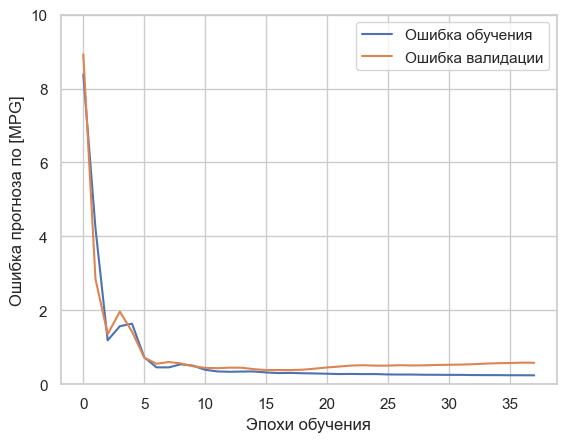

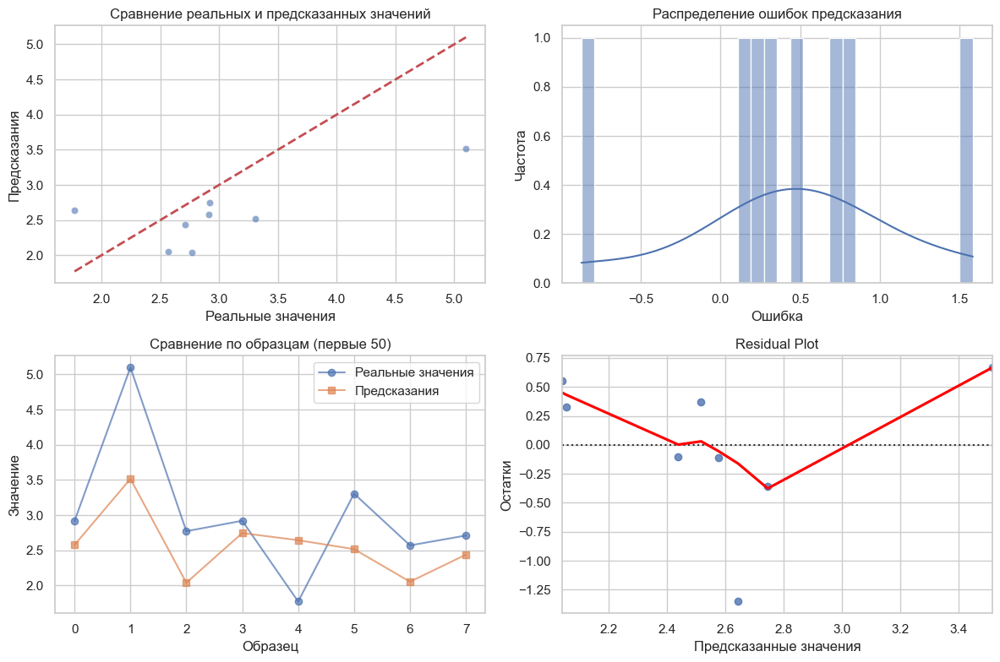

R² score: 0.2255
RMSE: 0.7836
MAPE: 22.2930


In [127]:
import tensorflow as tf
from tensorflow import keras
#from tensorflow.keras import layers
import numpy as np
from keras.callbacks import EarlyStopping
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def create_model(input_shape, x_tr):
    model = keras.Sequential()
    
    # Входной слой + нормализация
    model.add(keras.layers.Input(shape=input_shape))
    normalization_layer = keras.layers.Normalization()
    normalization_layer.adapt(x_tr)  
    model.add(normalization_layer)
    
    # Скрытые слои
    model.add(keras.layers.Dense(12, activation='relu'))
    
    # Выходной слой
    model.add(keras.layers.Dense(1))
    
    return model

# Подготовка данных
X = df_NNW.copy()
y = df_NNW['Соотношение матрица-наполнитель']
#X = X.drop(['Соотношение матрица-наполнитель'], axis=1)
X = X.drop(['Соотношение матрица-наполнитель',"Потребление смолы","Поверхностная плотность",
           "Модуль упругости при растяжении","Содержание эпоксидных групп",
           "Количество отвердителя","модуль упругости","Плотность"], axis=1)

# Разделение данных
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Убедимся, что данные в numpy формате
X_train_np = X_train.to_numpy().astype('float32')
X_test_np = X_test.to_numpy().astype('float32')
y_train_np = y_train.to_numpy().astype('float32')
y_test_np = y_test.to_numpy().astype('float32')

# Создание модели с адаптацией нормализации
model = create_model((X_train_np.shape[1],), X_train_np)

# Компиляция
model.compile(
    #optimizer='adam',
    optimizer=tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9),
    #optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss='mse',
    metrics=['mae']
)

# Обучение с проверкой
history = model.fit(
    X_train_np, y_train_np,
    epochs=100,
    batch_size=8,  
    validation_split=0.2,
    callbacks=[ EarlyStopping(patience=20, restore_best_weights=True)
        #EarlyStopping(
        #    monitor='val_loss',
        #    patience=15,  
        #    restore_best_weights=True,            
        #    min_delta=0.001,  
        #    verbose=1
        #)
    ],
    verbose=1
)

# Оценка
test_loss, test_mae = model.evaluate(X_test_np, y_test_np, verbose=0)
print(f"Test MSE: {test_loss:.4f}, Test MAE: {test_mae:.4f}")

# Предсказания
y_pred = model.predict(X_test_np)

# Дополнительные метрики
r2 = r2_score(y_test_np, y_pred)
rmse = np.sqrt(mean_squared_error(y_test_np, y_pred))
mape = np.mean(np.abs((y_test_np - y_pred.flatten()) / y_test_np)) * 100

print(f"R²: {r2:.4f}")
print(f"RMSE: {rmse:.4f}")
print(f"MAPE: {mape:.4f}%")

# Визуализация обучения
import matplotlib.pyplot as plt

model.summary()
plot_loss(history)

print(f"MSE: {mean_squared_error(y_test, y_pred)}")
print(f"R² Score: {r2_score(y_test, y_pred)}")

plotResult(y_test, y_pred.flatten()) # Находится в Модели - Вспомогательные функции

# Заключение

В результате тестирования различных методов машинного обучения установлено, что наилучшие результаты 
показывает **GradientBoostingRegressor**, однако общее качество прогнозирования оказалось ограниченным в связи с 
малым объемом выборки (39 наблюдение).<br>
Эксперименты показали, что существующий объем данных является недостаточным для построения высокоточных 
моделей. Наилучшие результаты были достигнуты при прогнозировании модуля упругости (R² = 0.339), в то время 
как для других целевых переменных качество моделей осталось низким.<br>
Результаты, полученные при разработке нейронной сети, указывают на то, что модель объясняет лишь 22.6% 
дисперсии целевой переменной, что свидетельствует о наличии значительной неучтенной вариативности в 
данных. Уровень ошибки прогнозирования в 22.29% является достаточно высоким для практического применения 
в задачах проектирования композиционных материалов.

Проведенное исследование выявило ряд существенных ограничений:
- Малый объем тренировочных данных не позволяет моделям выявлять сложные нелинейные зависимости
- Высокийриск переобучения при использовании сложных алгоритмов
- Ограниченная обобщающая способность построенных моделе

Для повышения эффективности прогнозных моделей необходимы: 
- Увеличение объема тренировочных данных 
- Привлечение методов трансферного обучения 
- Использование физически информированных моделей 
- Применение методов аугментации данных 